In [19]:
import pandas as pd
import numpy
import torch
import torch.nn as nn
import torch.nn.functional as F

In [20]:
df = pd.read_csv('../data/all_soil.csv')

In [4]:
df.head()

,Unnamed: 0,Day,Rep,Nutrient,pathogen,path_count,total_count,pH,EC mmhos/cm,Alkalinity mg/kg CaCO3,...,taxa491,taxa492,taxa493,taxa494,taxa495,taxa496,taxa497,taxa498,taxa499,taxa500
0,0,0,2,HNS,LM,4.081834076891335,7.326346,8.30,1.570,369.0,...,0,0.006618900269720186,0.03971340161832112,0.4947627951615839,0.00248208760114507,0,0,0,0,0
1,1,0,3,HNS,LM,3.6696263170163497,7.160333,8.20,1.240,464.0,...,0,0,0.11260709914320685,0.5532435740514076,0,0,0.10281517747858017,0,0,0
2,2,0,4,HNS,LM,4.179310017167323,6.789892,7.86,1.351,363.0,...,0,0,0.04881456357255275,0.07069695413955915,0.011782825689926526,0,0,0,0,0
3,3,0,2,HNS,none,.,7.179709,8.30,1.570,369.0,...,0,0,0.033704551518811354,0.36232392882722203,0,0,0.016852275759405677,0,0,0
4,4,0,3,HNS,none,.,7.197663,8.20,1.240,464.0,...,0,0.033029384355868024,0.05898104349262147,0.3161383931204511,0.0047184834794097175,0,0,0,0,0


In [21]:
df.drop(['Unnamed: 0'], axis=1, inplace=True)

In [6]:
df.head()

,Day,Rep,Nutrient,pathogen,path_count,total_count,pH,EC mmhos/cm,Alkalinity mg/kg CaCO3,Cl- (ppm),...,taxa491,taxa492,taxa493,taxa494,taxa495,taxa496,taxa497,taxa498,taxa499,taxa500
0,0,2,HNS,LM,4.081834076891335,7.326346,8.30,1.570,369.0,155.65,...,0,0.006618900269720186,0.03971340161832112,0.4947627951615839,0.00248208760114507,0,0,0,0,0
1,0,3,HNS,LM,3.6696263170163497,7.160333,8.20,1.240,464.0,166.03,...,0,0,0.11260709914320685,0.5532435740514076,0,0,0.10281517747858017,0,0,0
2,0,4,HNS,LM,4.179310017167323,6.789892,7.86,1.351,363.0,170.80,...,0,0,0.04881456357255275,0.07069695413955915,0.011782825689926526,0,0,0,0,0
3,0,2,HNS,none,.,7.179709,8.30,1.570,369.0,155.65,...,0,0,0.033704551518811354,0.36232392882722203,0,0,0.016852275759405677,0,0,0
4,0,3,HNS,none,.,7.197663,8.20,1.240,464.0,166.03,...,0,0.033029384355868024,0.05898104349262147,0.3161383931204511,0.0047184834794097175,0,0,0,0,0


In [22]:
df.replace('.', 0, inplace=True)

In [23]:
df.fillna(0, inplace=True)

In [24]:
from sklearn.preprocessing import LabelEncoder
encoder_nutrient = LabelEncoder()
df['Nutrient'] = encoder_nutrient.fit_transform(df['Nutrient'])
df['Nutrient'] = encoder_nutrient.fit_transform(df['Nutrient'])

/Users/matejamilicevic/anaconda3/envs/kaggle_comps/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/Users/matejamilicevic/anaconda3/envs/kaggle_comps/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/Users/matejamilicevic/anaconda3/envs/kaggle_comps/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/Users/matejamilicevic/anaconda3/envs/kaggle_comps/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is depreca

In [25]:
encoder_pathogen = LabelEncoder()
df['pathogen'] = encoder_pathogen.fit_transform(df['pathogen'])
df['pathogen'] = encoder_pathogen.fit_transform(df['pathogen'])

/Users/matejamilicevic/anaconda3/envs/kaggle_comps/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/Users/matejamilicevic/anaconda3/envs/kaggle_comps/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/Users/matejamilicevic/anaconda3/envs/kaggle_comps/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/Users/matejamilicevic/anaconda3/envs/kaggle_comps/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is depreca

In [26]:
df = df.apply(pd.to_numeric, errors='coerce').fillna(0)

In [132]:
df.head()

,Day,Rep,Nutrient,pathogen,path_count,total_count,pH,EC mmhos/cm,Alkalinity mg/kg CaCO3,Cl- (ppm),...,taxa491,taxa492,taxa493,taxa494,taxa495,taxa496,taxa497,taxa498,taxa499,taxa500
0,0,2,0,0,4.081834,7.326346,8.30,1.570,369.0,155.65,...,0.0,0.006619,0.039713,0.494763,0.002482,0.0,0.000000,0.0,0.0,0.0
1,0,3,0,0,3.669626,7.160333,8.20,1.240,464.0,166.03,...,0.0,0.000000,0.112607,0.553244,0.000000,0.0,0.102815,0.0,0.0,0.0
2,0,4,0,0,4.179310,6.789892,7.86,1.351,363.0,170.80,...,0.0,0.000000,0.048815,0.070697,0.011783,0.0,0.000000,0.0,0.0,0.0
3,0,2,0,3,0.000000,7.179709,8.30,1.570,369.0,155.65,...,0.0,0.000000,0.033705,0.362324,0.000000,0.0,0.016852,0.0,0.0,0.0
4,0,3,0,3,0.000000,7.197663,8.20,1.240,464.0,166.03,...,0.0,0.033029,0.058981,0.316138,0.004718,0.0,0.000000,0.0,0.0,0.0


In [27]:
df.drop(['Day'], axis=1, inplace=True)

In [28]:
X = df[df.columns[22:]].values
y = df[df.columns[1:22]].values

In [29]:
X_tra = X
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
pca = PCA(0.95)

principalComponents = pca.fit_transform(scaler.fit_transform(X_tra))

In [30]:
principalComponents.shape

(168, 79)

In [33]:
pComp = pca.fit_transform(X)

In [34]:
pComp.shape

(168, 5)

In [43]:
X = torch.tensor(pComp, dtype=torch.float32)
y = torch.tensor(y, dtype=torch.float32)

/var/folders/nb/x8ft0wb94sd72p6bpk_ld9fc0000gn/T/ipykernel_33799/3543133361.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  y = torch.tensor(y, dtype=torch.float32)


In [36]:
from torch.utils.data import TensorDataset, DataLoader
from sklearn.model_selection import train_test_split

In [44]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [38]:
class MeanSquaredLogarithmicError(nn.Module):
    def __init__(self):
        super(MeanSquaredLogarithmicError, self).__init__()

    def forward(self, y_pred, y_true):
        y_pred = torch.clamp(y_pred, min=0)
        y_true = torch.clamp(y_true, min=0)
        
        return torch.mean((torch.log1p(y_true) - torch.log1p(y_pred)) ** 2)


In [39]:
import torch.nn as nn
import torch.nn.functional as F

class NNModelSmall(nn.Module):
    def __init__(self, input_size=100, out_features=5):
        super(NNModelSmall, self).__init__()
        self.fc1 = nn.Linear(in_features=input_size, out_features=50)
        self.bn1 = nn.BatchNorm1d(50)
        
        self.fc2 = nn.Linear(in_features=50, out_features=out_features)
        self.bn2 = nn.BatchNorm1d(out_features)
        
        self.fc3 = nn.Linear(in_features=100, out_features=50)
        self.bn3 = nn.BatchNorm1d(50)

        self.fc4 = nn.Linear(in_features=50, out_features=25)
        self.bn4 = nn.BatchNorm1d(25)
        
        self.fc5 = nn.Linear(in_features=25, out_features=out_features)
        self.dropout = nn.Dropout(0.25)  # Example dropout, adjust the rate as needed

    def forward(self, x):
        x = F.relu(self.bn1(self.fc1(x)))
        x = F.relu(self.bn2(self.fc2(x)))
          
        return x


In [40]:
import torch.nn as nn
import torch.nn.functional as F

class NNModel(nn.Module):
    def __init__(self, input_size=100, out_features=5):
        super(NNModel, self).__init__()
        self.fc1 = nn.Linear(in_features=input_size, out_features=200)
        self.bn1 = nn.BatchNorm1d(200)
        
        self.fc2 = nn.Linear(in_features=200, out_features=100)
        self.bn2 = nn.BatchNorm1d(100)
        
        self.fc3 = nn.Linear(in_features=100, out_features=50)
        self.bn3 = nn.BatchNorm1d(50)

        self.fc4 = nn.Linear(in_features=50, out_features=25)
        self.bn4 = nn.BatchNorm1d(25)
        
        self.fc5 = nn.Linear(in_features=25, out_features=out_features)
        self.dropout = nn.Dropout(0.25)  # Example dropout, adjust the rate as needed

    def forward(self, x):
        x = F.relu(self.bn1(self.fc1(x)))
        x = F.relu(self.bn2(self.fc2(x)))
        x = F.relu(self.bn3(self.fc3(x)))
        x = F.relu(self.bn4(self.fc4(x)))
        x = F.relu(self.fc5(x))
          
        return x


In [186]:
import torch.optim as optim
#model = NNModelSmall(principalComponents.shape[1], 21)
model_big = NNModel(principalComponents.shape[1],21)
criterion = nn.MSELoss()
optimizer = optim.Adam(model_big.parameters(), lr=0.01)

In [187]:
from sklearn.model_selection import KFold
def train_model(model):
    model.train()
    # Assuming you have your dataset X, y
    kf = KFold(n_splits=5) # Example of 5-fold cross-validation
    patience = 0
    best_loss = 7 * [97000]
    while True:
        
        for fold, (train_index, val_index) in enumerate(kf.split(X_train)):
            print(f'Fold {fold+1}')

            X_t, X_v = X_train[train_index], X_train[val_index]
            y_t, y_v = y_train[train_index], y_train[val_index]

            for epoch in range(5):  # 100 epochs
                optimizer.zero_grad()
                
                outputs = model(X_t)
                loss = criterion(outputs, y_t)
                loss.backward()
                optimizer.step()
                
                # Validation step
                with torch.no_grad():
                    val_outputs = model(X_v)
                    val_loss = criterion(val_outputs, y_v)

                print(f'[{epoch + 1}] Training loss: {loss.item():.5f}, Validation loss: {val_loss.item():.5f}')
                if val_loss.item() < best_loss[fold]:
                    best_loss[fold] = val_loss.item()
                    patience = 0
                elif val_loss.item() > best_loss[fold]: 
                    patience += 1
                    if patience == 50:
                        print(f'Finished training with best val loss of {best_loss}')
                        return

            print('Finished Training for Fold', fold+1)
train_model(model_big)
   

Fold 1
[1] Training loss: 13669.41895, Validation loss: 13039.39746
[2] Training loss: 13649.70410, Validation loss: 13024.13477
[3] Training loss: 13631.08008, Validation loss: 13011.62305
[4] Training loss: 13616.43262, Validation loss: 13000.85645
[5] Training loss: 13604.50195, Validation loss: 12989.82812
[6] Training loss: 13592.54492, Validation loss: 12979.50391
[7] Training loss: 13581.74121, Validation loss: 12968.39551
[8] Training loss: 13569.23926, Validation loss: 12955.95996
[9] Training loss: 13555.78516, Validation loss: 12942.69434
[10] Training loss: 13540.30078, Validation loss: 12928.48730
[11] Training loss: 13523.62793, Validation loss: 12913.83984
[12] Training loss: 13507.26953, Validation loss: 12898.71582
[13] Training loss: 13491.01562, Validation loss: 12883.15039
[14] Training loss: 13474.42480, Validation loss: 12866.87891
[15] Training loss: 13456.55957, Validation loss: 12849.70117
[16] Training loss: 13437.78809, Validation loss: 12831.95215
[17] Train

In [41]:
model_small = torch.load('../models/model_all_data_small.pth')
model_big = torch.load('../models/model_all_data_big.pth')

In [45]:
model_big.eval()
model_small.eval()
all_predictions = []
all_labels = []
with torch.no_grad():  # Disable gradient computation
    
    #outputs_big = model_big(torch.tensor(X_test, dtype=torch.float32))
    outputs_small = model_small(torch.tensor(X_test, dtype=torch.float32))

/var/folders/nb/x8ft0wb94sd72p6bpk_ld9fc0000gn/T/ipykernel_33799/1476096932.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs_small = model_small(torch.tensor(X_test, dtype=torch.float32))


In [109]:
ensemble_nn = (outputs_big + outputs_small)/2

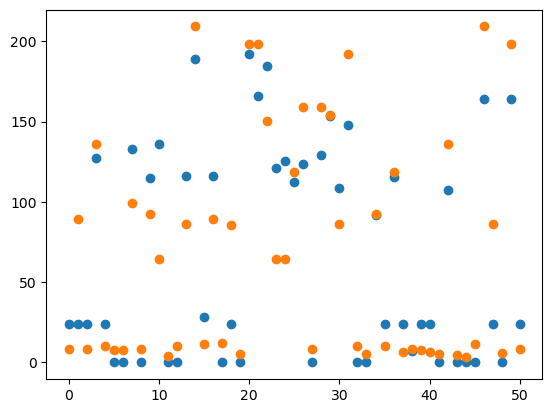

In [46]:
import matplotlib.pyplot as plt 

plt.scatter([x for x in range(0, y_test.shape[0])], outputs_small[:,-1])
plt.scatter([x for x in range(0, y_test.shape[0])], y_test[:,-1])
plt.show()

Text(0.5, 1.0, 'Model 1 TOC predicted vs actual RMSE : 28.639')

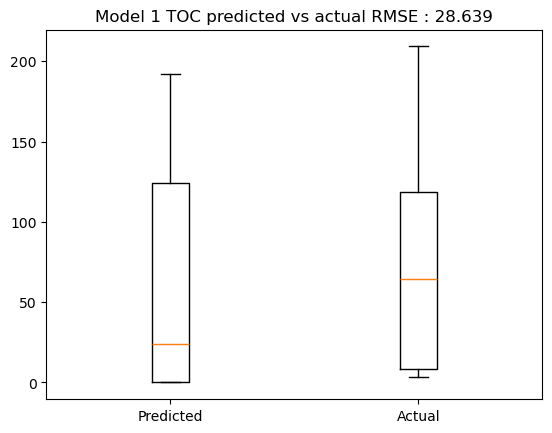

In [48]:
from sklearn.metrics import mean_squared_error
n=20
plt.boxplot([outputs_small[:,n], y_test[:,n]], labels=['Predicted', 'Actual'])
plt.title(f'Model 1 {df.columns[n+1]} predicted vs actual RMSE : {np.sqrt(mean_squared_error(y_test[:,n], outputs_small[:,n])):.3f}')


In [112]:
torch.save(model, '../models/model_all_data_small.pth')

In [113]:
torch.save(model_big, '../models/model_all_data_big.pth')

In [49]:
class AE(torch.nn.Module):
    def __init__(self):
        super().__init__()
         
        self.encoder = torch.nn.Sequential(
            torch.nn.Linear(500, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, 64),
            torch.nn.ReLU(),
            torch.nn.Linear(64, 32),
            torch.nn.ReLU()
        )
        self.decoder = torch.nn.Sequential(
            torch.nn.Linear(32, 64),
            torch.nn.ReLU(),
            torch.nn.Linear(64, 128),
            torch.nn.ReLU(),
            torch.nn.Linear(128, 500),
            torch.nn.Sigmoid()
        )
 
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

In [50]:
encoder = AE()
 
# Validation using MSE Loss function
loss_function = torch.nn.MSELoss()
 
# Using an Adam Optimizer with lr = 0.1
optimizer = torch.optim.Adam(encoder.parameters(),
                             lr = 1e-5,
                             weight_decay = 1e-8)


In [51]:
X_train, X_test, y_train, y_test = train_test_split(torch.tensor(df[df.columns[22:]].values, dtype=torch.float32), torch.tensor(y, dtype=torch.float32), test_size=0.3, random_state=42)

/var/folders/nb/x8ft0wb94sd72p6bpk_ld9fc0000gn/T/ipykernel_33799/2417479823.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_train, X_test, y_train, y_test = train_test_split(torch.tensor(df[df.columns[22:]].values, dtype=torch.float32), torch.tensor(y, dtype=torch.float32), test_size=0.3, random_state=42)


In [60]:
train_dataset = TensorDataset(X_train, y_train)
test_dataset = TensorDataset(X_test, y_test)
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False)

In [61]:
def train_encoder():
    min_loss = 1000
    encoder.train()
    losses = []
    outputs = []
    patience = 0
    while True:
        for i, _ in train_loader:
            reconstruct = encoder(i)
            loss = loss_function(reconstruct, i)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            losses.append(loss.item())
            if(loss.item() < min_loss):
                min_loss = loss.item()
            else:
                patience += 1
                if patience == 5:
                    return losses
        outputs.append((10, i, reconstruct))

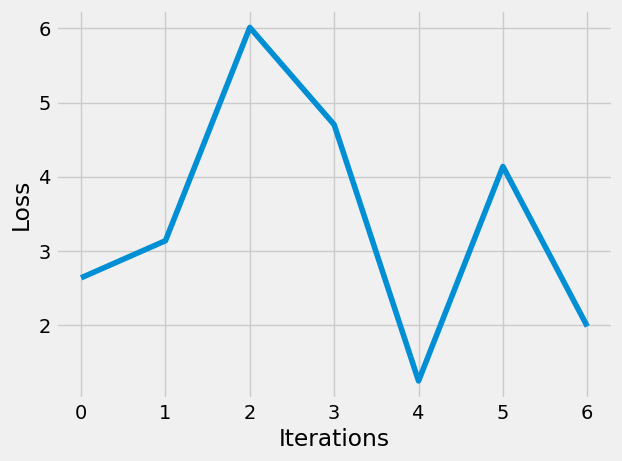

In [65]:
import matplotlib.pyplot as plt
losses = train_encoder()
plt.style.use('fivethirtyeight')
plt.xlabel('Iterations')
plt.ylabel('Loss')
 
# Plotting the last 100 values
plt.plot(losses)

In [66]:
import torch.optim as optim
#model = NNModelSmall(5, 21)
#model_big_ae = NNModel(32,21)
model_small_ae = NNModelSmall(32,21)
criterion = nn.MSELoss()
optimizer = optim.Adam(model_small_ae.parameters(), lr=0.001)

In [67]:
from sklearn.model_selection import KFold

def train_model(model):
    encoder.eval()
    model.train()
    # Assuming you have your dataset X, y
    kf = KFold(n_splits=5) # Example of 5-fold cross-validation
    patience = 0
    best_loss = 7 * [97000]
    while True:
        
        for fold, (train_index, val_index) in enumerate(kf.split(X_train)):
            print(f'Fold {fold+1}')

            X_t, X_v = X_train[train_index], X_train[val_index]
            y_t, y_v = y_train[train_index], y_train[val_index]

            for epoch in range(20):  # 100 epochs
                optimizer.zero_grad()
                
                outputs = model(encoder.encoder(X_t))
                loss = criterion(outputs, y_t)
                loss.backward()
                optimizer.step()
                
                # Validation step
                with torch.no_grad():
                    val_outputs = model(encoder.encoder(X_v))
                    val_loss = criterion(val_outputs, y_v)

                print(f'[{epoch + 1}] Training loss: {loss.item():.5f}, Validation loss: {val_loss.item():.5f}')
                if val_loss.item() < best_loss[fold]:
                    best_loss[fold] = val_loss.item()
                    patience = 0
                elif val_loss.item() > best_loss[fold]: 
                    patience += 1
                    if patience == 50:
                        print(f'Finished training with best val loss of {best_loss}')
                        return

            print('Finished Training for Fold', fold+1)
train_model(model_small_ae)
   

Fold 1
[1] Training loss: 13644.37988, Validation loss: 13029.67383
[2] Training loss: 13641.18066, Validation loss: 13027.57715
[3] Training loss: 13638.39355, Validation loss: 13025.80859
[4] Training loss: 13636.15137, Validation loss: 13024.32520
[5] Training loss: 13634.35645, Validation loss: 13022.95020
[6] Training loss: 13632.93066, Validation loss: 13021.55664
[7] Training loss: 13631.70996, Validation loss: 13020.39648
[8] Training loss: 13630.67090, Validation loss: 13019.38086
[9] Training loss: 13629.79102, Validation loss: 13018.45312
[10] Training loss: 13629.05273, Validation loss: 13017.60547
[11] Training loss: 13628.42285, Validation loss: 13016.86230
[12] Training loss: 13627.86133, Validation loss: 13016.08496
[13] Training loss: 13627.29785, Validation loss: 13015.29980
[14] Training loss: 13626.74414, Validation loss: 13014.48242
[15] Training loss: 13626.20605, Validation loss: 13013.62988
[16] Training loss: 13625.67871, Validation loss: 13012.79004
[17] Train

In [68]:
model_small_ae.eval()

all_predictions = []
all_labels = []
with torch.no_grad():  # Disable gradient computation
    
    outputs_ae = model_small_ae(encoder.encoder(torch.tensor(X_test, dtype=torch.float32)))
    

/var/folders/nb/x8ft0wb94sd72p6bpk_ld9fc0000gn/T/ipykernel_33799/1041976857.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs_ae = model_small_ae(encoder.encoder(torch.tensor(X_test, dtype=torch.float32)))


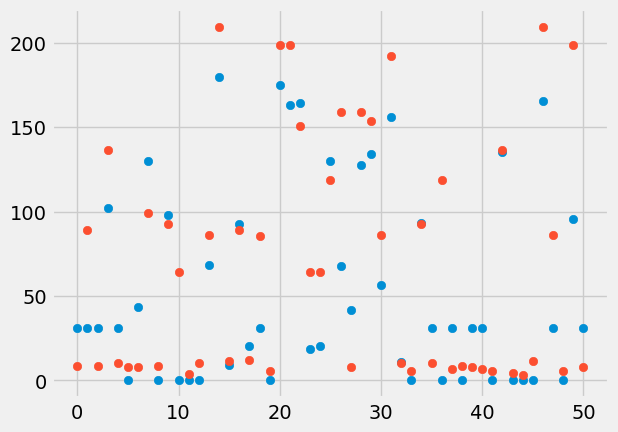

In [69]:
import matplotlib.pyplot as plt 

plt.scatter([x for x in range(0, y_test.shape[0])], outputs_ae[:,-1])
plt.scatter([x for x in range(0, y_test.shape[0])], y_test[:,-1])
plt.show()

Text(0.5, 1.0, 'Comparison of TOC predicted vs actual 36.71786880493164')

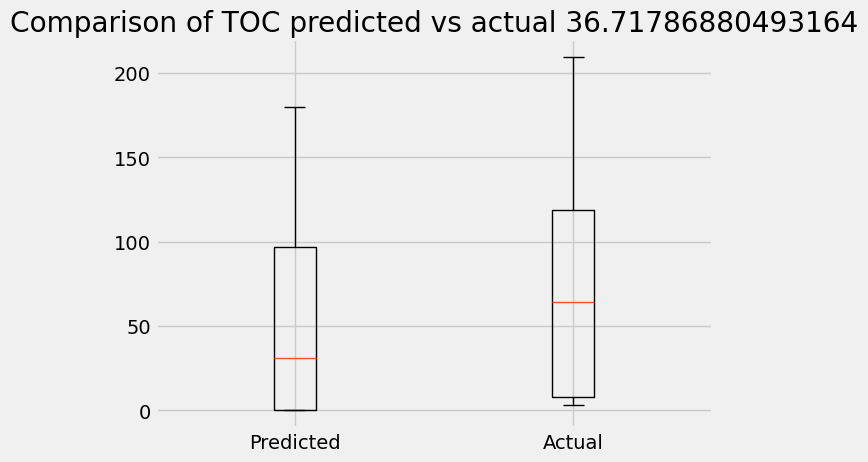

In [70]:
from sklearn.metrics import mean_squared_error
n=20
plt.boxplot([outputs_ae[:,n], y_test[:,n]], labels=['Predicted', 'Actual'])
plt.title(f'Comparison of {df.columns[n+1]} predicted vs actual {np.sqrt(mean_squared_error(y_test[:,n], outputs_ae[:,n]))}')


In [ ]:
torch.save(model_big_ae, '../models/model_ae.pth')

In [71]:
ensemble_nn = (outputs_small + outputs_small ) / 2

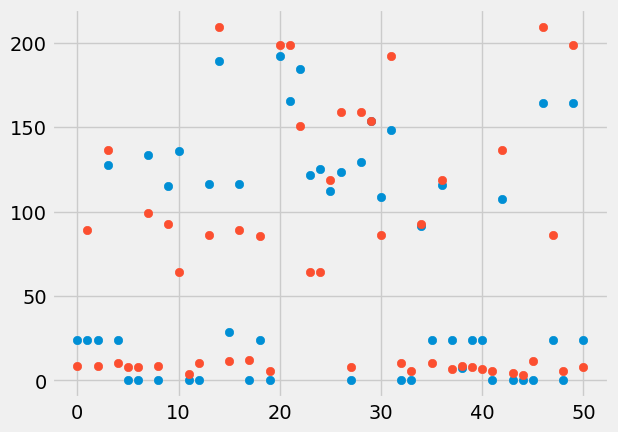

In [72]:
import matplotlib.pyplot as plt 

plt.scatter([x for x in range(0, y_test.shape[0])], ensemble_nn[:,-1])
plt.scatter([x for x in range(0, y_test.shape[0])], y_test[:,-1])
plt.show()

Text(0.5, 1.0, 'Comparison of TOC predicted vs actual 28.639488220214844')

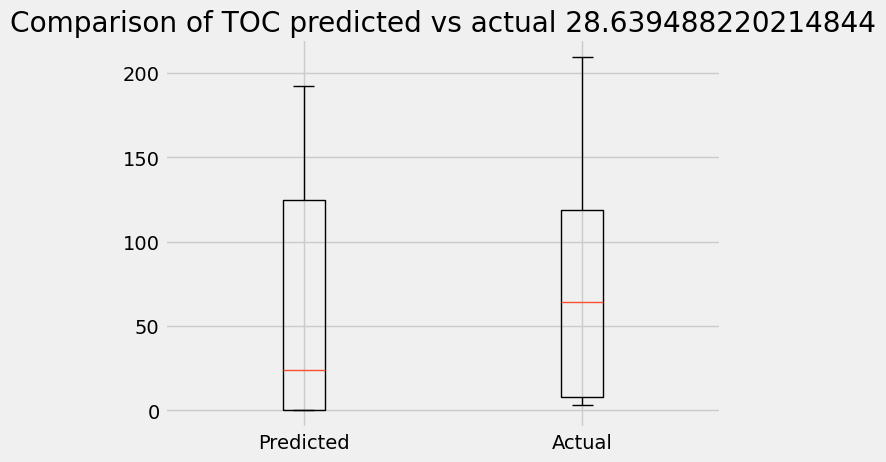

In [73]:
from sklearn.metrics import mean_squared_error
n=20
plt.boxplot([ensemble_nn[:,n], y_test[:,n]], labels=['Predicted', 'Actual'])
plt.title(f'Comparison of {df.columns[n+1]} predicted vs actual {np.sqrt(mean_squared_error(y_test[:,n], ensemble_nn[:,n]))}')


In [74]:
from lightgbm import LGBMRegressor
from sklearn.ensemble import RandomForestRegressor
import re
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV
def format_filename(filename):
    """
    Formats the given filename to remove special characters that
    might interfere with directory structures.
    """
    # Replace forbidden characters with an underscore
    filename = re.sub(r'[\\/*?:"<>|]', '_', filename)
    
    # Replace spaces with underscores
    filename = filename.replace(' ', '_')

    return filename
def fit_svr(i, X, y_train, X_test, y_test, x_ticks):    
    svr = SVR()

# Define the parameter grid
    param_grid = {
        'C': [0.1, 1, 10, 100],         # Regularization parameter
        'gamma': ['scale', 'auto'],     # Kernel coefficient
        'kernel': ['rbf', 'linear', 'poly'],    # Specifies the kernel type to be used
    }

    # Setup GridSearchCV
    grid_search = GridSearchCV(estimator=svr, param_grid=param_grid, 
                            cv=5, n_jobs=-1, verbose=2, scoring='neg_mean_squared_error')

    # Perform grid search
    grid_search.fit(X, y_train[:,i])

    # Print the best parameters and the best score
    print(f"Best parameters: {grid_search.best_params_}")
    print(f"Best score: {-grid_search.best_score_}")

    # Evaluate on the test set
    best_model = grid_search.best_estimator_
    test_score = best_model.score(X_test, y_test[:,i])
    y_pred = best_model.predict(X_test)
    #y_pred = [np.average([y_pred[j], all_predictions[j,0]]) for j, x in enumerate(y_pred)]
    
    print(f"Test set score: {test_score}")
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 6))
    ax1.boxplot([y_test[:,i], y_pred])
    ax1.set_title(f'SVR-{df.columns[i+1]} RMSE : {np.sqrt(mean_squared_error(y_test[:,i], y_pred)):.3f}')
    ax1.set_xticklabels(['Actual', 'Predicted'])
    
    ax2.boxplot([y_test[:,i], outputs[:,i]])
    ax2.set_title(f'ANN-{df.columns[i+3]} RMSE : {np.sqrt(mean_squared_error(y_test[:,i], outputs[:,i].numpy())):.3f}')
    ax2.set_xticklabels(['Actual', 'Predicted'])

    # Display the plot
    plt.suptitle('Comparison of ANN and SVR Predictions on \nSoil Extract Dataset with Inoculated Samples.')
    plt.tight_layout()
    plt.savefig(f'../plots/proposal/small_dataset/svr_{format_filename(df.columns[i+3])}')
    plt.show()
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 6))

    # SVR Scatter Plot
    ax1.scatter( [x for x in range(y_test.shape[0])], y_test[:, i], alpha=0.5)
    ax1.scatter([x for x in range(y_test.shape[0])],y_pred, alpha=0.5)
    ax1.set_title(f'SVR-{df.columns[i + 1]} RMSE: {np.sqrt(mean_squared_error(y_test[:, i], y_pred)):.3f}')
    ax1.set_xticks(ticks = [x for x in range(y_test[:,i].shape[0])],labels=x_ticks, rotation=90, fontsize=5)
    ax1.legend()
    ax1.grid()
    ax1.set_xlabel('Replicate')
    ax1.set_ylabel(df.columns[i+1])

    # ANN Scatter Plot
    ax2.scatter([x for x in range(y_test.shape[0])], y_test[:, i], alpha=0.5)
    ax2.scatter([x for x in range(y_test.shape[0])], outputs[:, i], alpha=0.5)
    ax2.set_title(f'ANN-{df.columns[i + 1]} RMSE: {np.sqrt(mean_squared_error(y_test[:, i], outputs[:, i])):.3f}')
    ax2.set_xticks(ticks = [x for x in range(y_test[:,i].shape[0])],labels=x_ticks, rotation=90, fontsize=5)
    ax2.legend()
    ax2.grid()
    ax2.set_xlabel('Replicate')
    ax2.set_ylabel(df.columns[i+1])

    # Figure settings
    plt.suptitle('Comparison of ANN and SVR Predictions on \nSoil Extract Dataset with Inoculated Samples.')
    plt.tight_layout()
    plt.savefig(f'../plots/proposal/all_soil_dataset/svr_scatter_{format_filename(df.columns[i + 3])}')
    plt.show()
    return best_model, y_pred, df.columns[i+1]
from sklearn.ensemble import RandomForestRegressor
def fit_rf(i, X, y_train, X_test, y_test, x_ticks):
    rf = RandomForestRegressor(random_state=42)


    param_grid_rf = {
        'n_estimators': [100, 200, 300],
        'max_depth': [None, 10, 20, 30],
        'min_samples_split': [2, 5, 10]
    }

    grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, 
                                cv=5, n_jobs=-1, verbose=2, scoring='neg_mean_squared_error')


    grid_search_rf.fit(X, y_train[:,i])


    print(f"Best parameters (RF): {grid_search_rf.best_params_}")
    print(f"Best score (RF): {-grid_search_rf.best_score_}")


    best_rf = grid_search_rf.best_estimator_
    test_score_rf = best_rf.score(X_test, y_test[:,i])
    print(f"Test set score (RF): {test_score_rf}")
    y_pred_rf = best_rf.predict(X_test)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 6))
    ax1.boxplot([y_test[:,i], y_pred_rf])
    ax1.set_title(f'RF-{df.columns[i+1]} RMSE : {np.sqrt(mean_squared_error(y_test[:,i], y_pred_rf)):.3f}')
    ax1.set_xticklabels(['Actual', 'Predicted'])
    
    ax2.boxplot([y_test[:,i], outputs[:,i]])
    ax2.set_title(f'ANN-{df.columns[i+1]} RMSE : {np.sqrt(mean_squared_error(y_test[:,i], outputs[:,i].numpy())):.3f}')
    ax2.set_xticklabels(['Actual', 'Predicted'])

    # Display the plot
    plt.suptitle('Comparison of ANN and RF Predictions on \nSoil Extract Dataset with Inoculated Samples.')
    plt.tight_layout()
    plt.savefig(f'../plots/proposal/all_soil_dataset/rf_{format_filename(df.columns[i+3])}')
    plt.show()
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 6))

    # SVR Scatter Plot
    ax1.scatter( [x for x in range(y_test.shape[0])], y_test[:, i], alpha=0.5)
    ax1.scatter([x for x in range(y_test.shape[0])],y_pred_rf, alpha=0.5)
    ax1.set_title(f'RF-{df.columns[i + 1]} RMSE: {np.sqrt(mean_squared_error(y_test[:, i], y_pred_rf)):.3f}')
    ax1.set_xticks(ticks = [x for x in range(y_test[:,i].shape[0])],labels=x_ticks, rotation=90, fontsize=5)
    ax1.legend()
    ax1.grid()
    ax1.set_xlabel('Replicate')
    ax1.set_ylabel(df.columns[i+1])

    # ANN Scatter Plot
    ax2.scatter([x for x in range(y_test.shape[0])], y_test[:, i], alpha=0.5)
    ax2.scatter([x for x in range(y_test.shape[0])], outputs[:, i], alpha=0.5)
    ax2.set_title(f'ANN-{df.columns[i + 1]} RMSE: {np.sqrt(mean_squared_error(y_test[:, i], outputs[:, i])):.3f}')
    ax2.set_xticks(ticks = [x for x in range(y_test[:,i].shape[0])],labels=x_ticks, rotation=90, fontsize=5)
    ax2.legend()
    ax2.grid()
    ax2.set_xlabel('Replicate')
    ax2.set_ylabel(df.columns[i+1])

    # Figure settings
    plt.suptitle('Comparison of ANN and RF Predictions on \nSoil Extract Dataset with Inoculated Samples.')
    plt.tight_layout()
    plt.savefig(f'../plots/proposal/all_soil_dataset/rf_scatter_{format_filename(df.columns[i + 3])}')
    plt.show()
    return best_rf, y_pred_rf, df.columns[i+1]
from lightgbm import LGBMRegressor
def fit_lgbm(i, X, y_train, X_test, y_test, x_ticks):
    lgbm = LGBMRegressor(random_state=42)

    # Define the parameter grid
    param_grid_lgbm = {
        'num_leaves': [2,3,5,10,20,31, 50, 70],
        'learning_rate': [0.01, 0.05, 0.1, 0.001],
        'n_estimators': [3,5,7,10,20, 50, 100, 200, 300]
    }

    # Setup GridSearchCV
    grid_search_lgbm = GridSearchCV(estimator=lgbm, param_grid=param_grid_lgbm, 
                                    cv=5, n_jobs=-1, verbose=2, scoring='neg_mean_squared_error')

    # Perform grid search
    grid_search_lgbm.fit(X, y_train[:,i])

    # Best parameters and score
    print(f"Best parameters (LGBM): {grid_search_lgbm.best_params_}")
    print(f"Best score (LGBM): {-grid_search_lgbm.best_score_}")

    # Test set evaluation
    best_lgbm = grid_search_lgbm.best_estimator_
    test_score_lgbm = best_lgbm.score(X_test, y_test[:,i])
    print(f"Test set score (LGBM): {test_score_lgbm}")
    y_pred_lgbm = best_lgbm.predict(X_test)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 6))
    ax1.boxplot([y_test[:,i], y_pred_lgbm])
    ax1.set_title(f'SVR-{df.columns[i+1]} RMSE : {np.sqrt(mean_squared_error(y_test[:,i], y_pred_lgbm)):.3f}')
    ax1.set_xticklabels(['Actual', 'Predicted'])
    
    ax2.boxplot([y_test[:,i], outputs[:,i]])
    ax2.set_title(f'ANN-{df.columns[i+1]} RMSE : {np.sqrt(mean_squared_error(y_test[:,i], outputs[:,i].numpy())):.3f}')
    ax2.set_xticklabels(['Actual', 'Predicted'])

    # Display the plot
    plt.suptitle('Comparison of ANN and LGBM Predictions on \nSoil Extract Dataset with Inoculated Samples.')
    plt.tight_layout()
    plt.savefig(f'../plots/proposal/all_soil_dataset/lgbm_{format_filename(df.columns[i+3])}')
    plt.show()

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 6))

    # SVR Scatter Plot
    ax1.scatter( [x for x in range(y_test.shape[0])], y_test[:, i], label = 'Actual', alpha=0.5)
    ax1.scatter([x for x in range(y_test.shape[0])],y_pred_lgbm, label = 'Predicted',alpha=0.5)
    ax1.set_title(f'LGBM-{df.columns[i + 1]} RMSE: {np.sqrt(mean_squared_error(y_test[:, i], y_pred_lgbm)):.3f}')
    ax1.set_xticks(ticks = [x for x in range(y_test[:,i].shape[0])],labels=x_ticks, rotation=90, fontsize=5)
    ax1.legend()
    ax1.grid()
    ax1.set_xlabel('Replicate')
    ax1.set_ylabel(df.columns[i+3])

    # ANN Scatter Plot
    ax2.scatter([x for x in range(y_test.shape[0])], y_test[:, i], label = 'Actual', alpha=0.5)
    ax2.scatter([x for x in range(y_test.shape[0])], outputs[:, i], label = 'Predicted', alpha=0.5)
    ax2.set_title(f'ANN-{df.columns[i + 1]} RMSE: {np.sqrt(mean_squared_error(y_test[:, i], outputs[:, i])):.3f}')
    ax2.set_xlabel('Replicate')
    ax2.legend()
    ax2.grid()
    ax2.set_xticks(ticks = [x for x in range(y_test[:,i].shape[0])],labels=x_ticks, rotation=90, fontsize=5)
    ax2.set_ylabel(df.columns[3])

    # Figure settings
    plt.suptitle('Comparison of ANN and LGBM Predictions on \nSoil Extract Dataset with Inoculated Samples.')
    plt.tight_layout()
    plt.savefig(f'../plots/proposal/all_soil_dataset/lgbm_scatter_{format_filename(df.columns[i + 3])}')
    plt.show()



    return best_lgbm, y_pred_lgbm, df.columns[i+1]
    
    

In [76]:
X_train, X_test, y_train, y_test = train_test_split(principalComponents, y, test_size=0.3, random_state=42)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

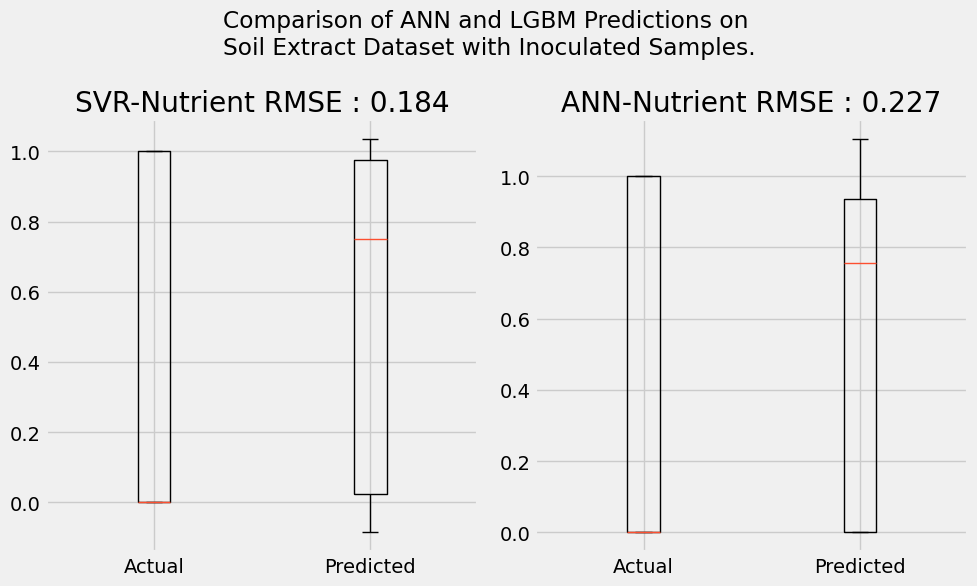

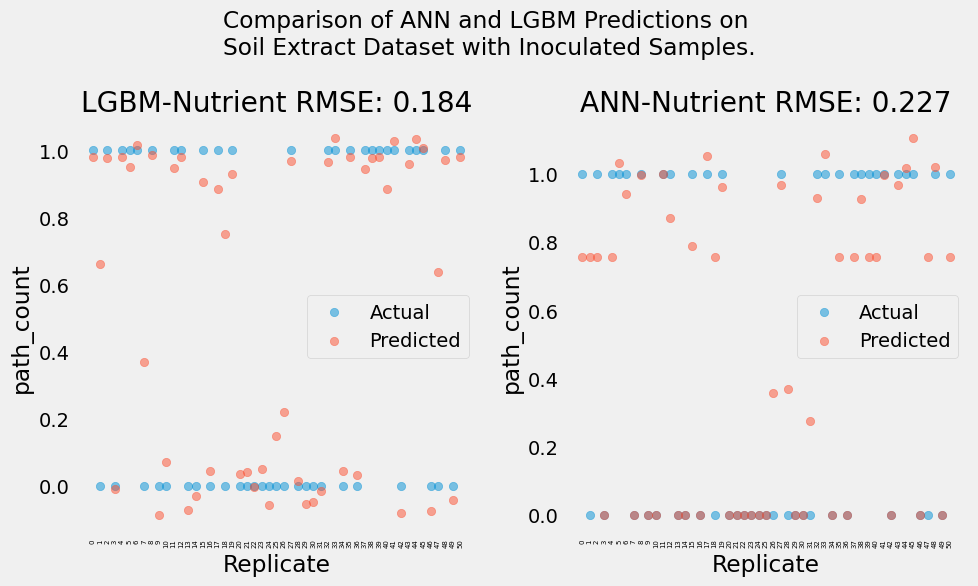

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, 

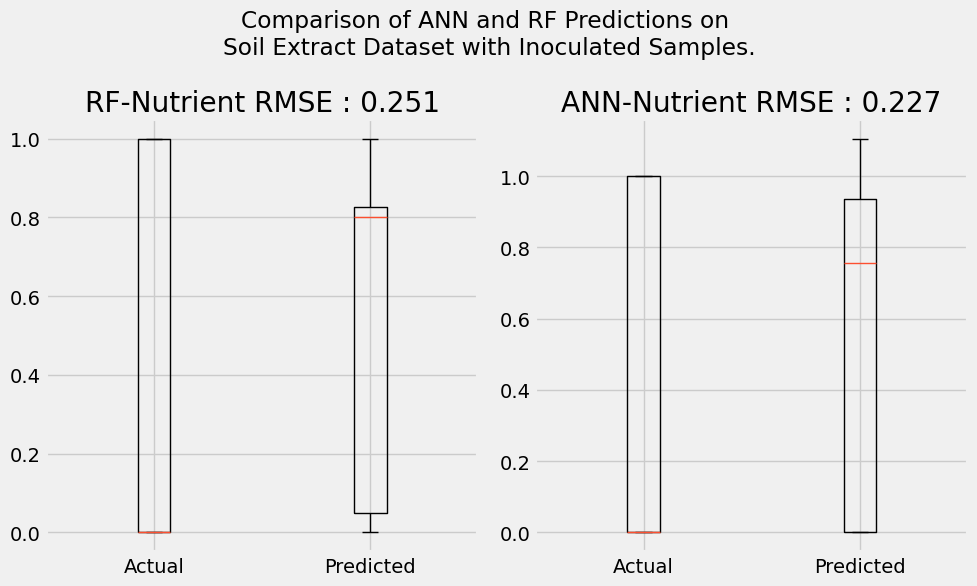

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


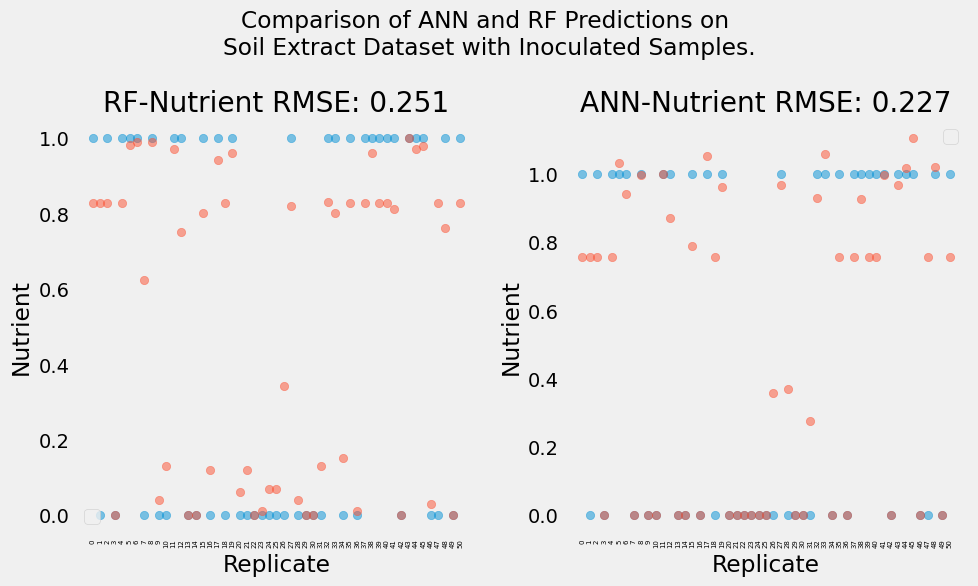

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, 

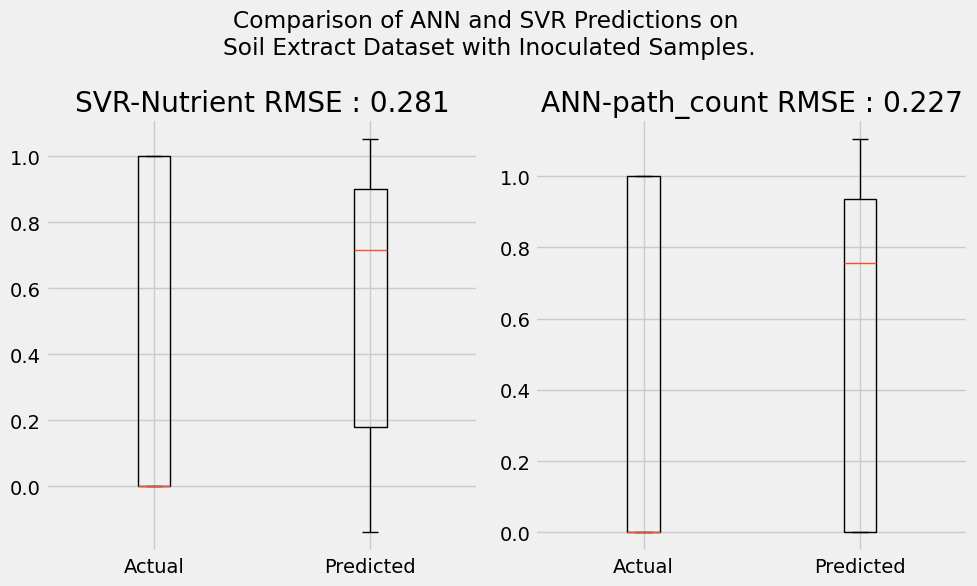

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


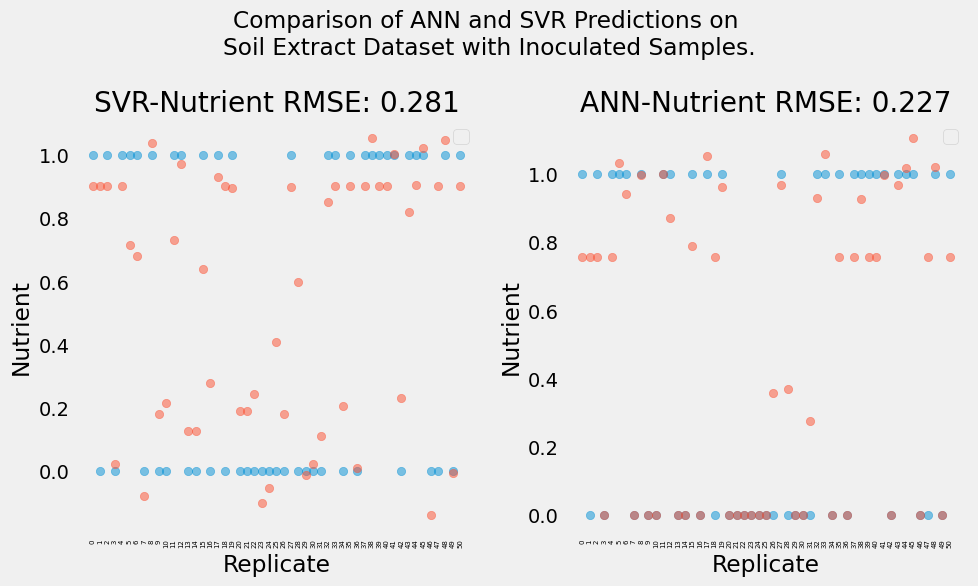

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

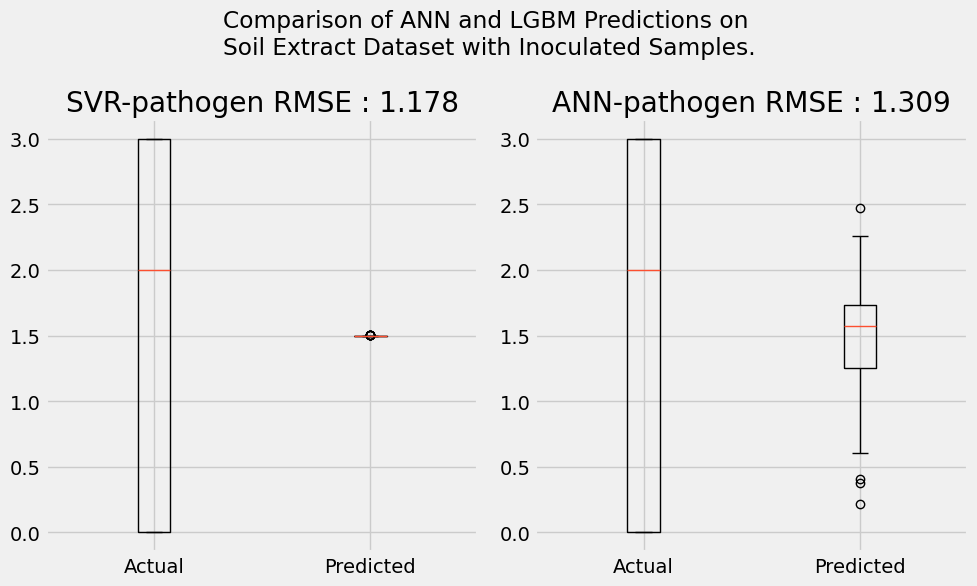

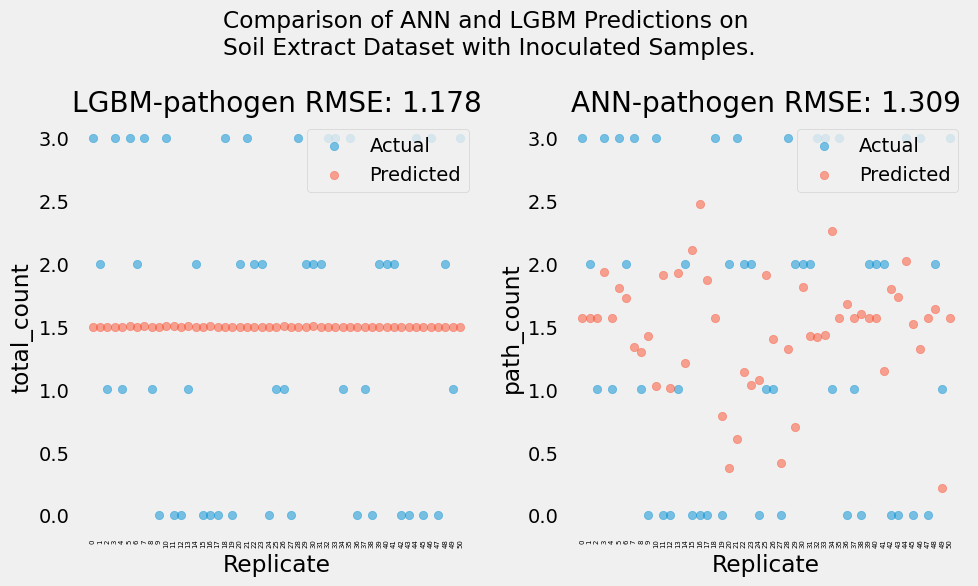

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, 

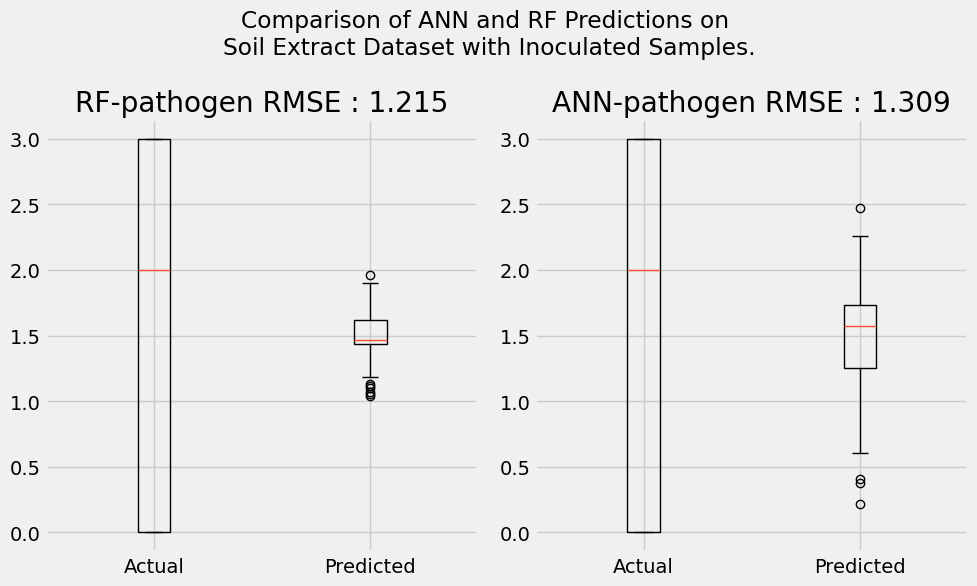

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


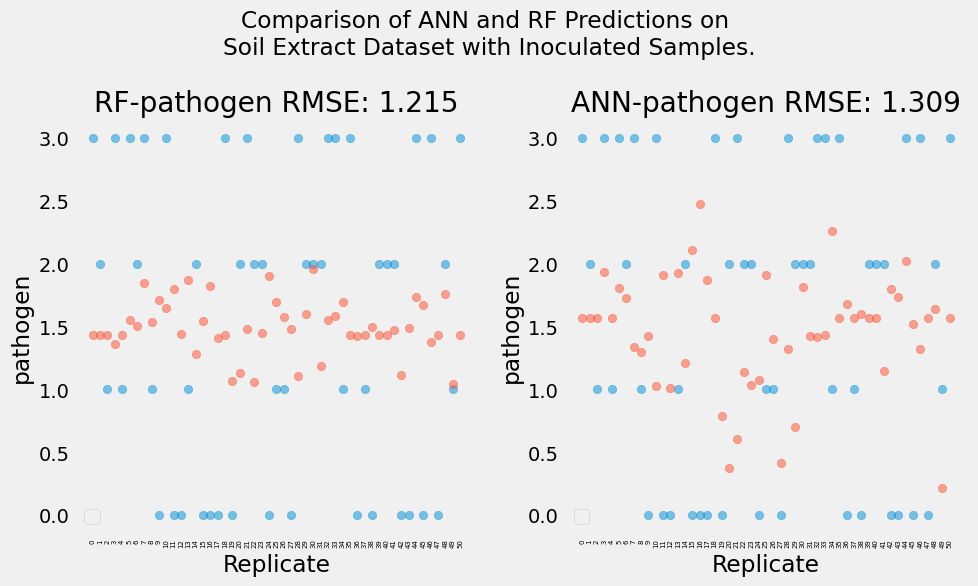

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

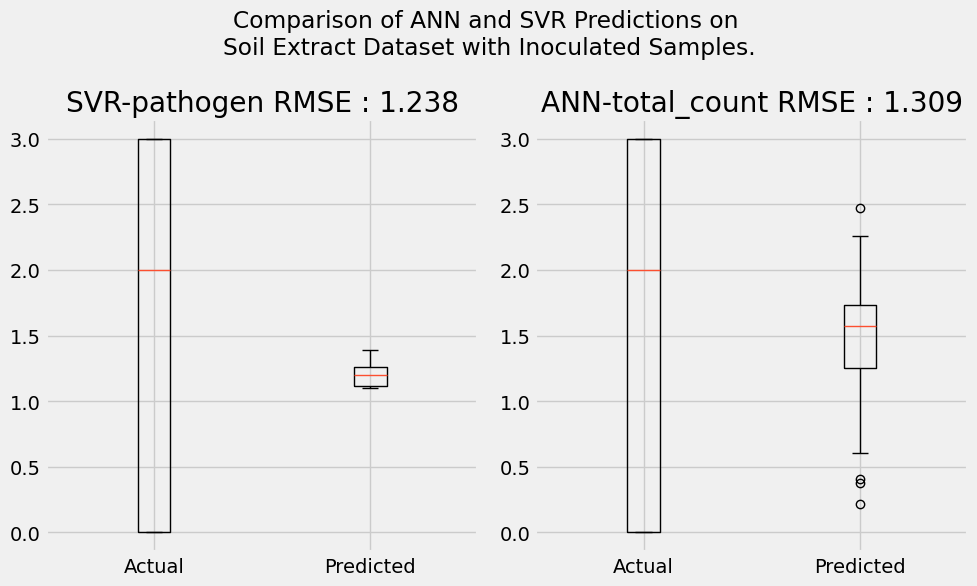

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


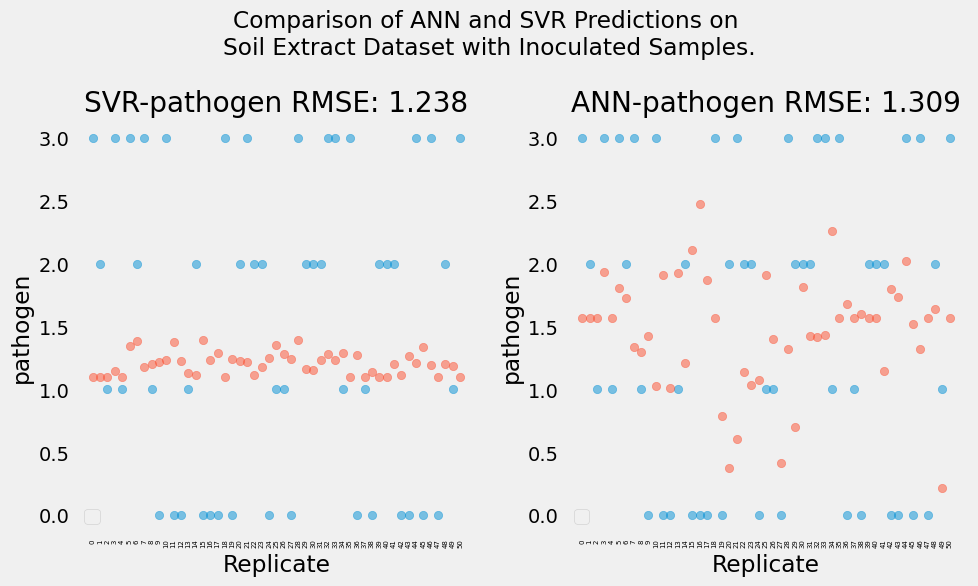

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

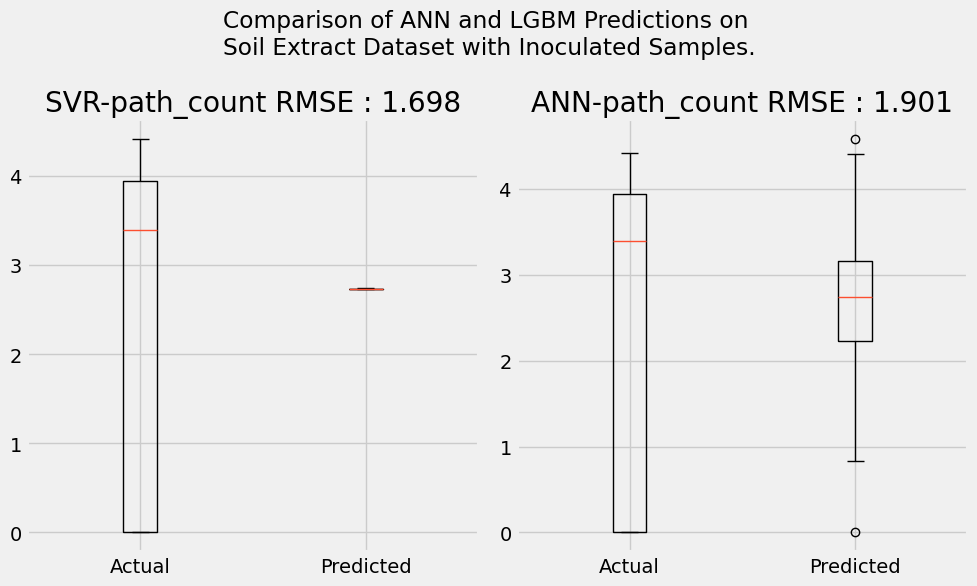

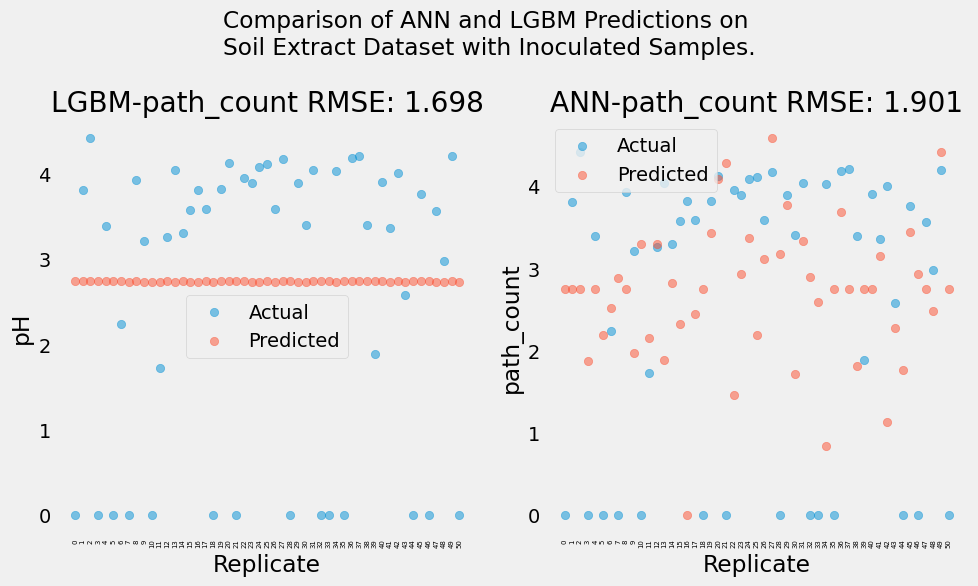

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

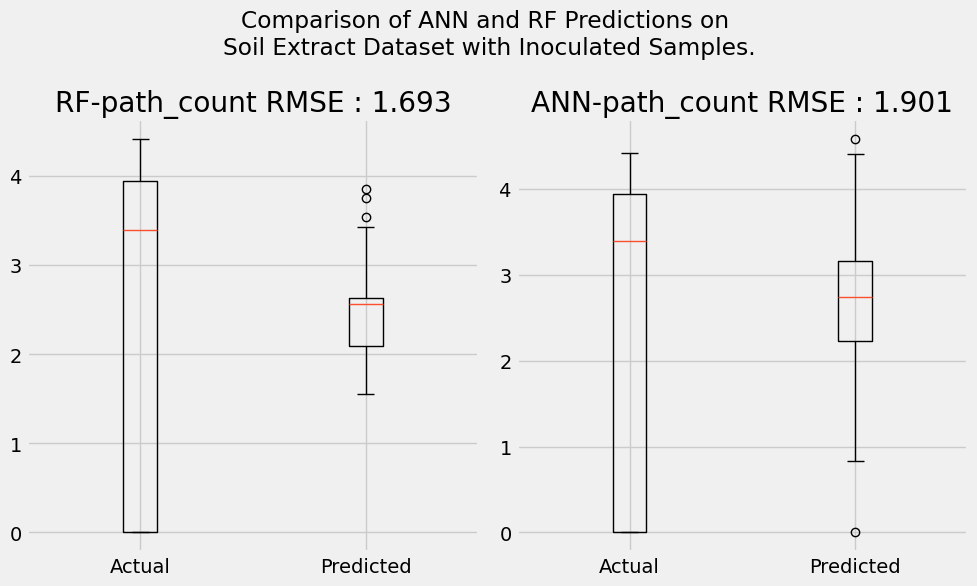

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


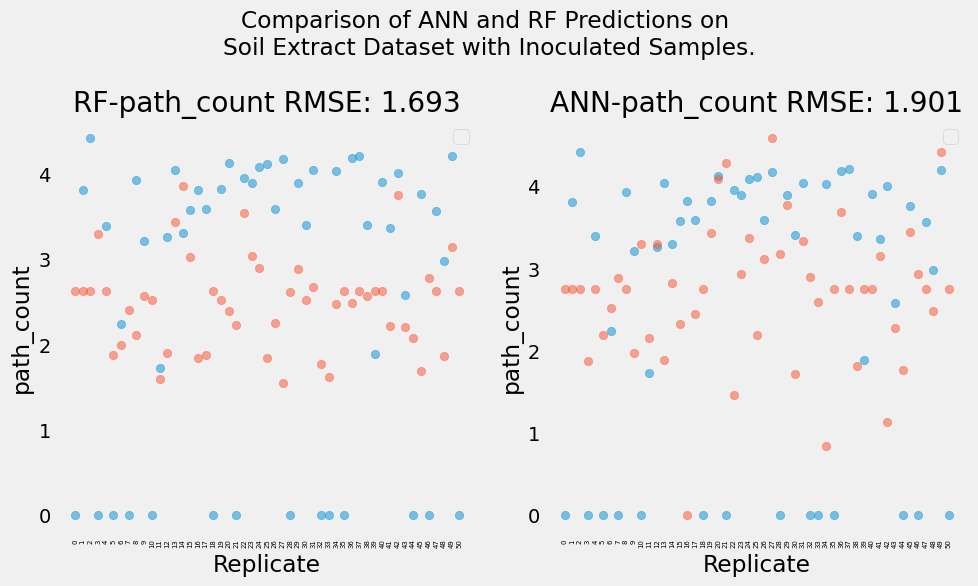

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

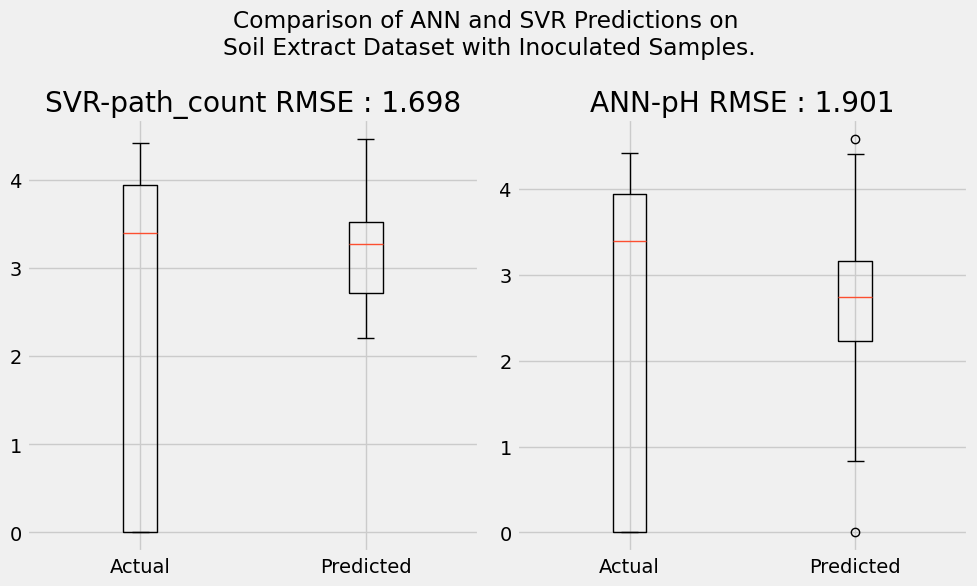

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


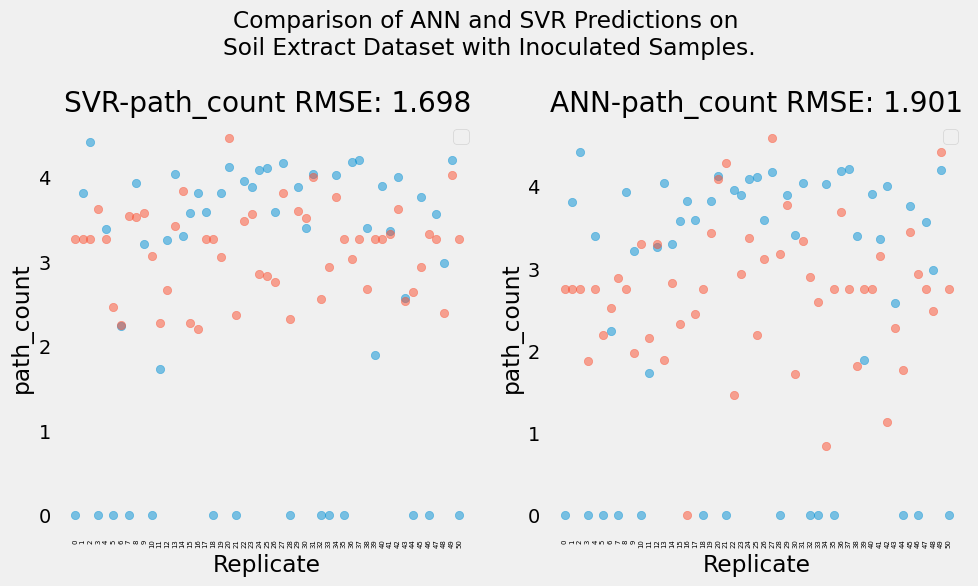

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

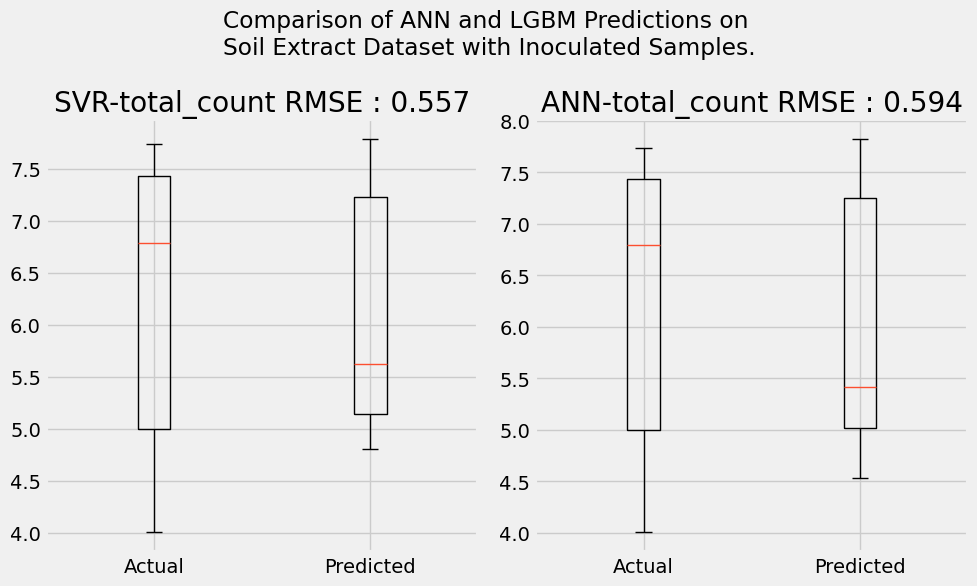

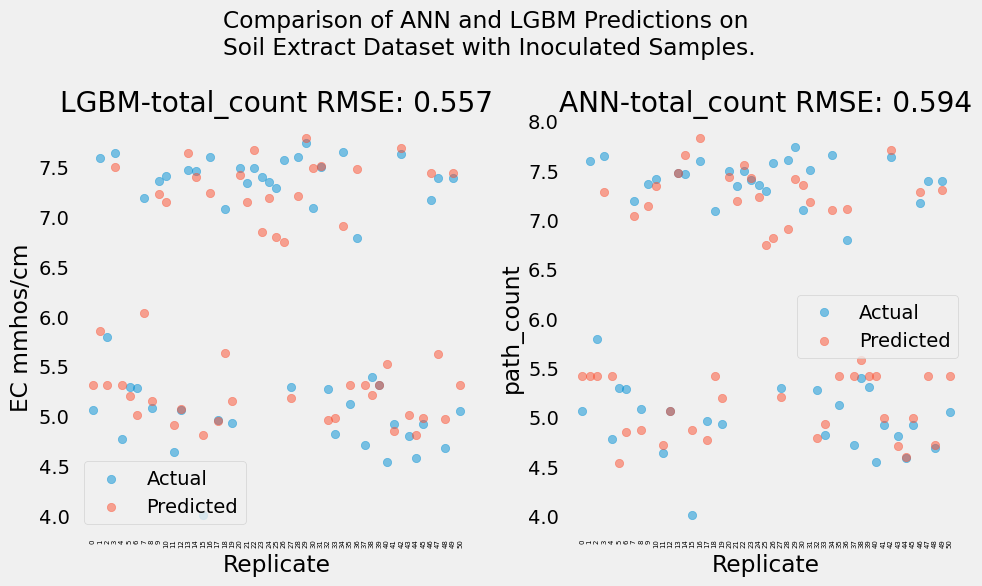

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

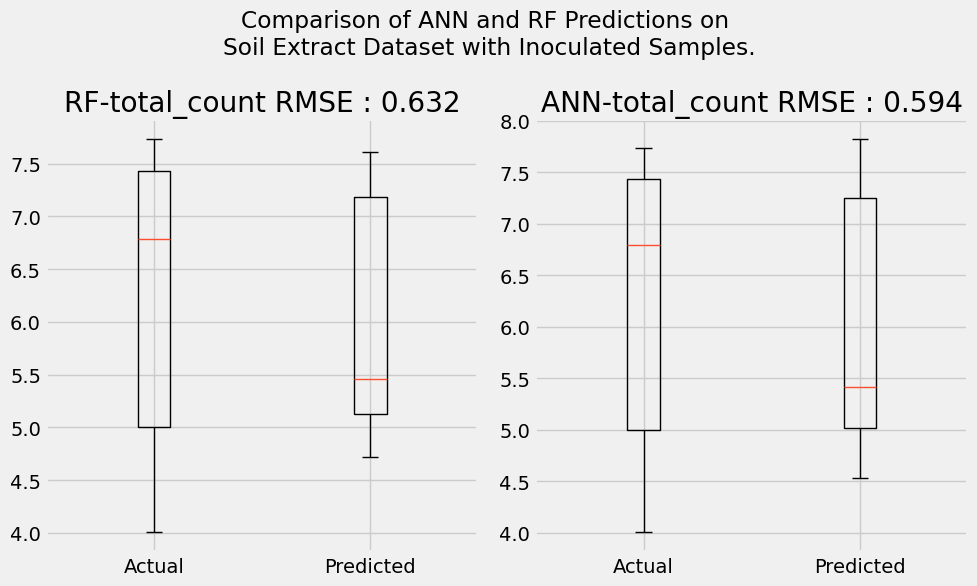

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


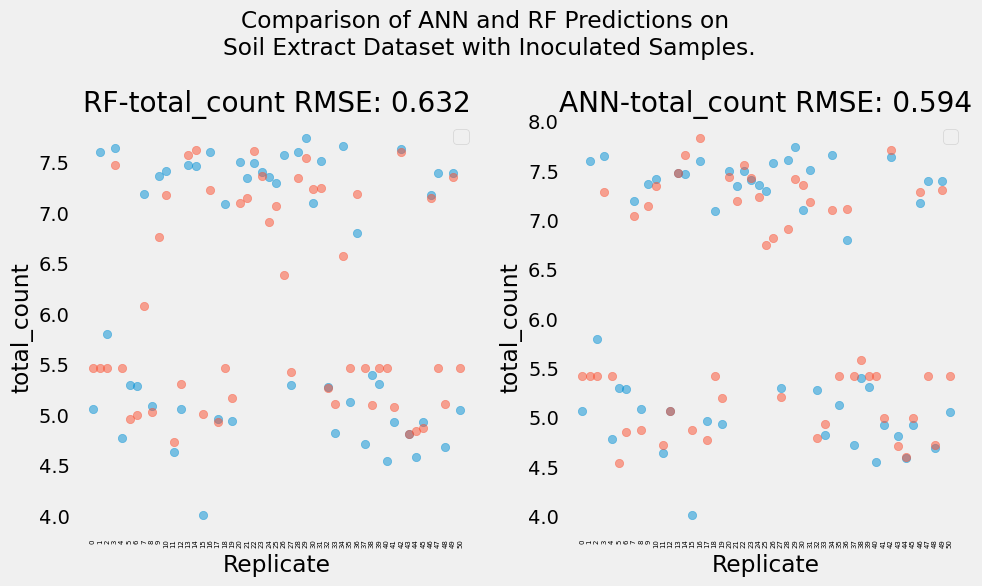

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

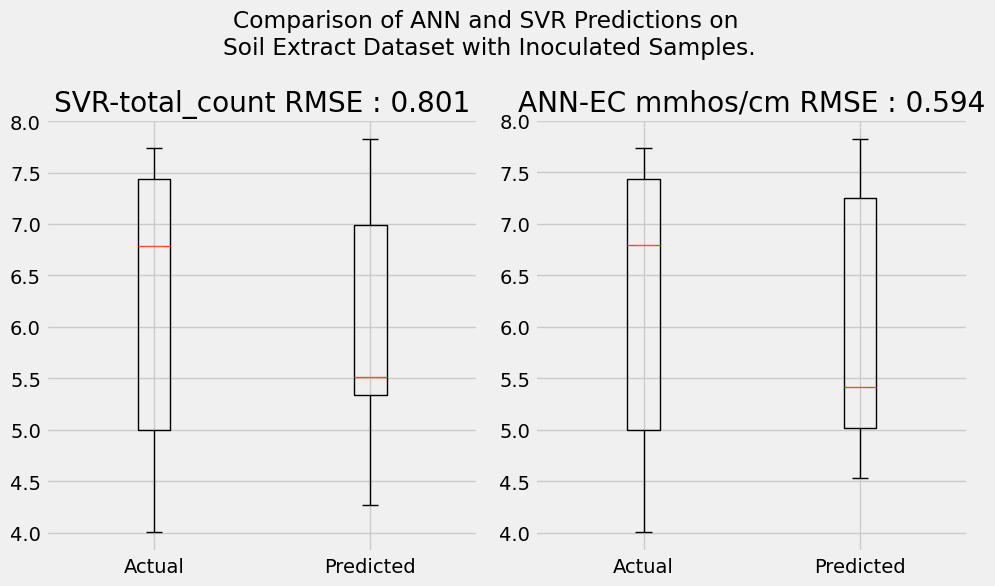

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


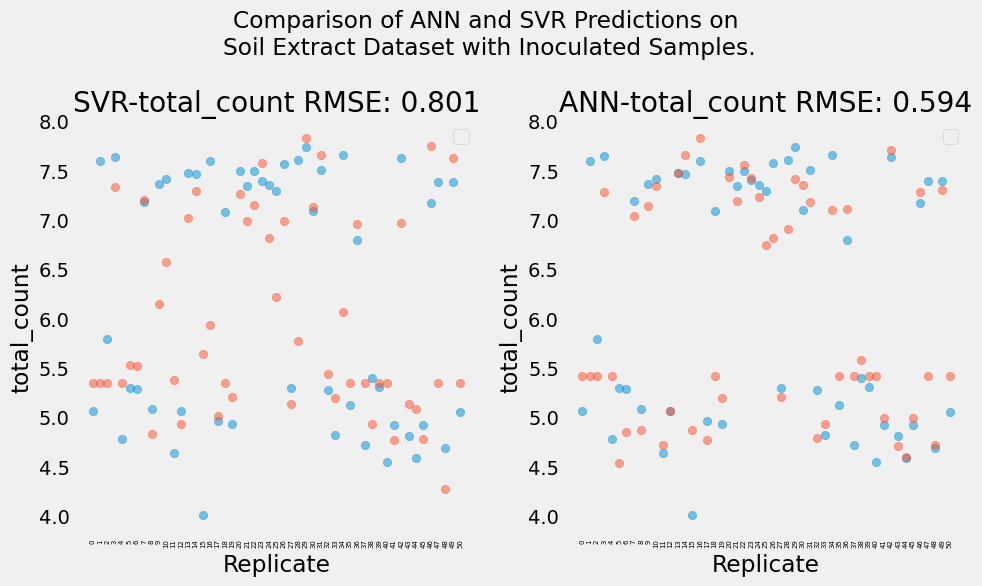

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

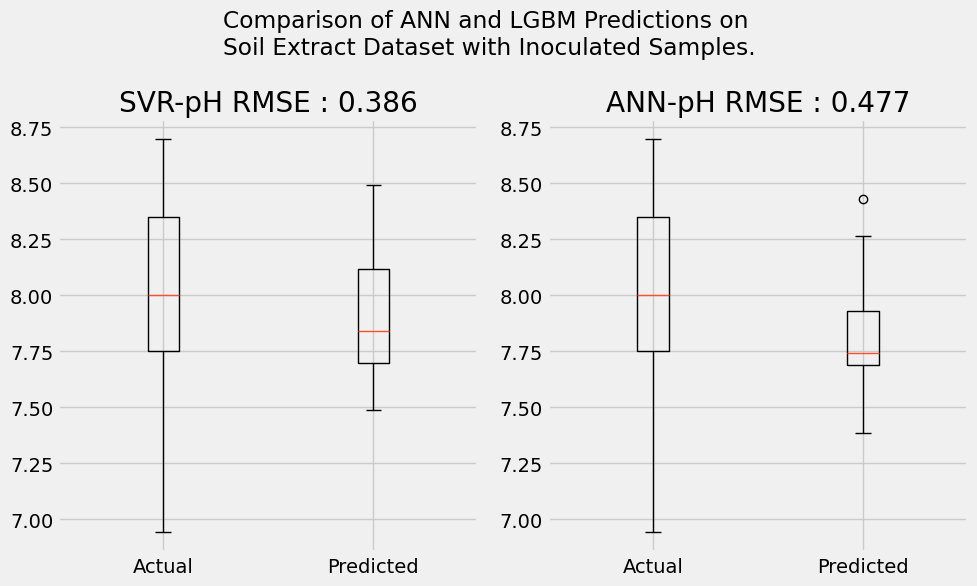

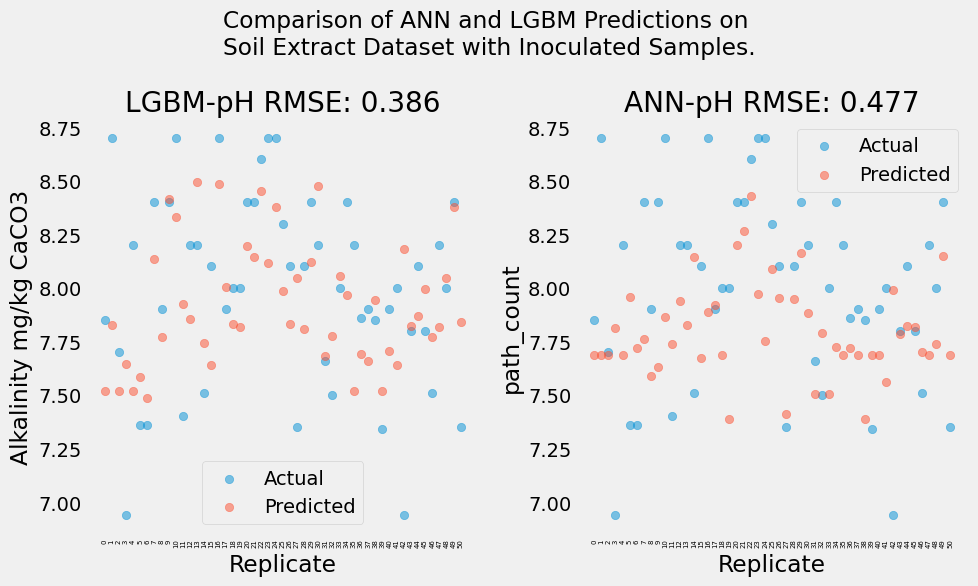

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

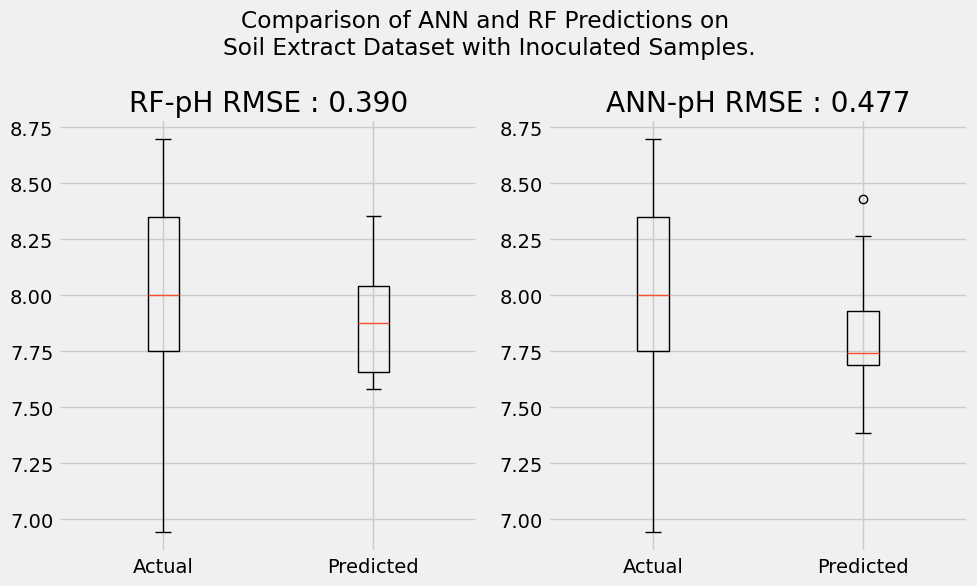

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


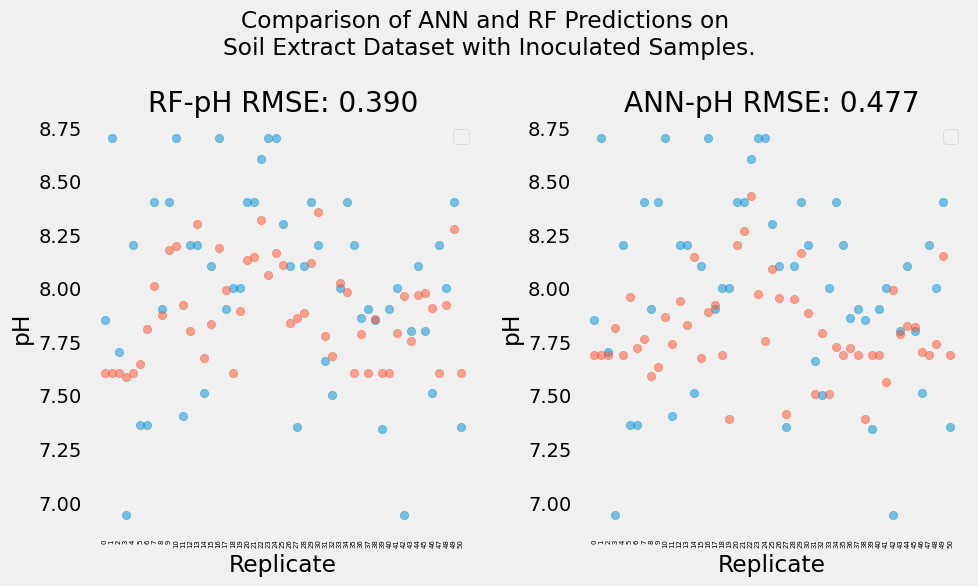

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, 

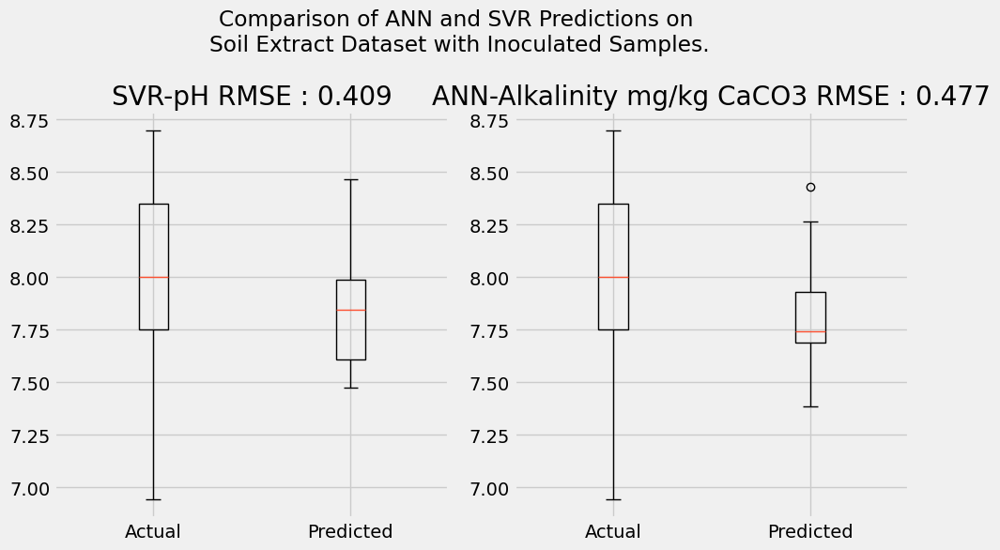

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


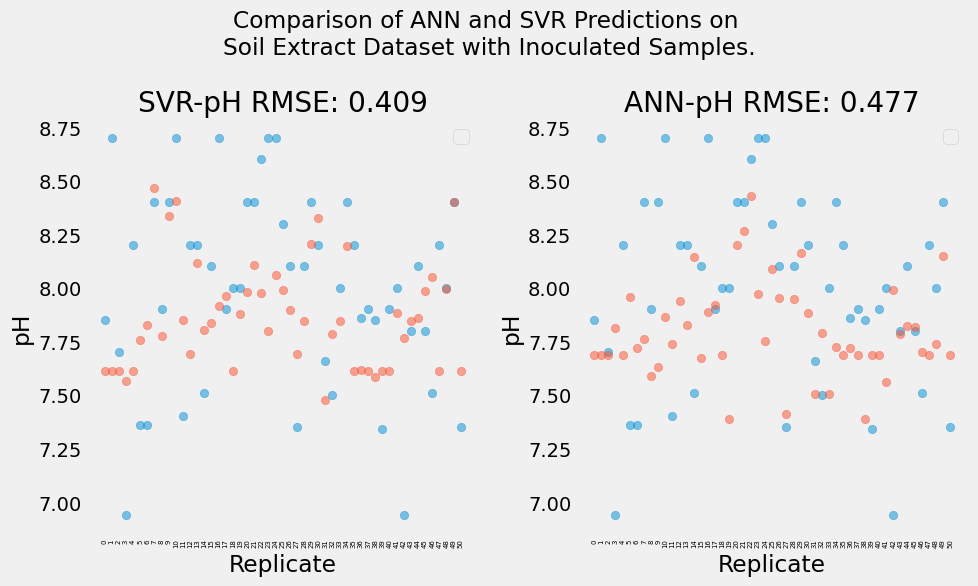

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

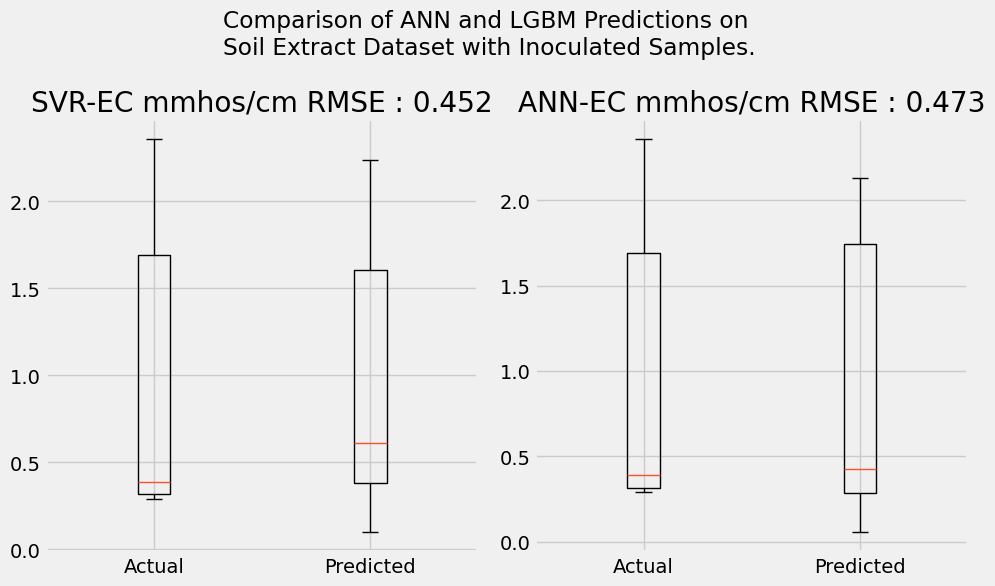

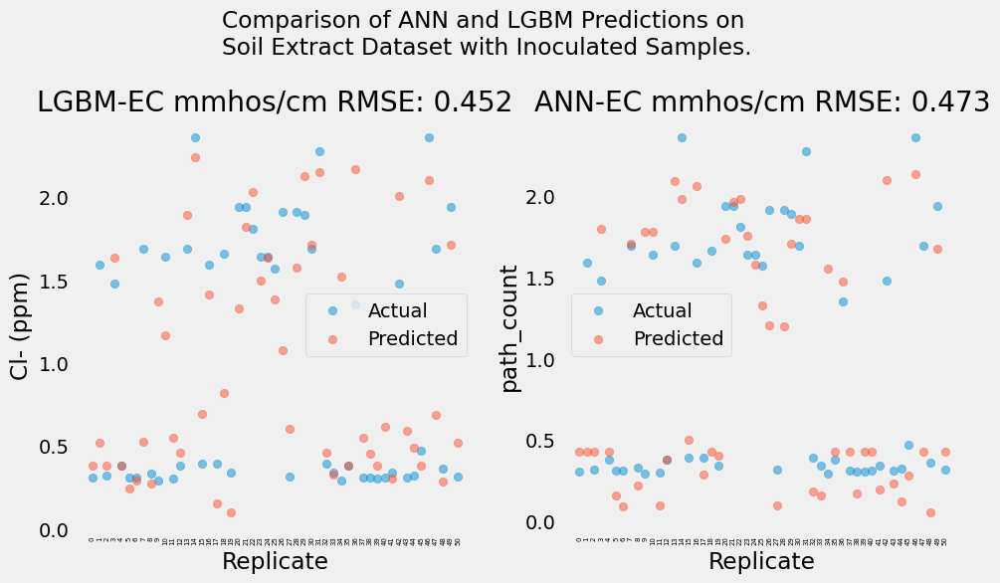

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

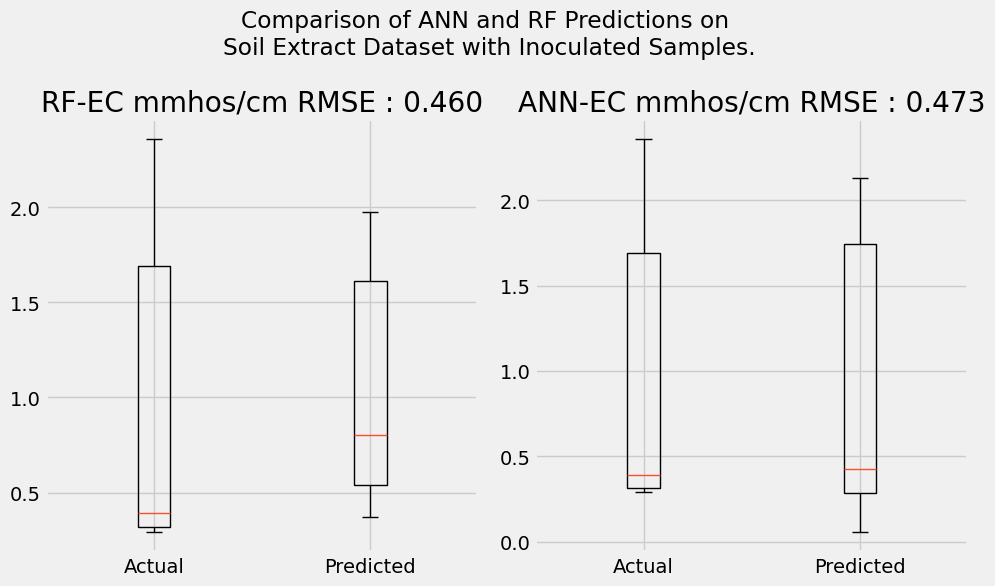

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


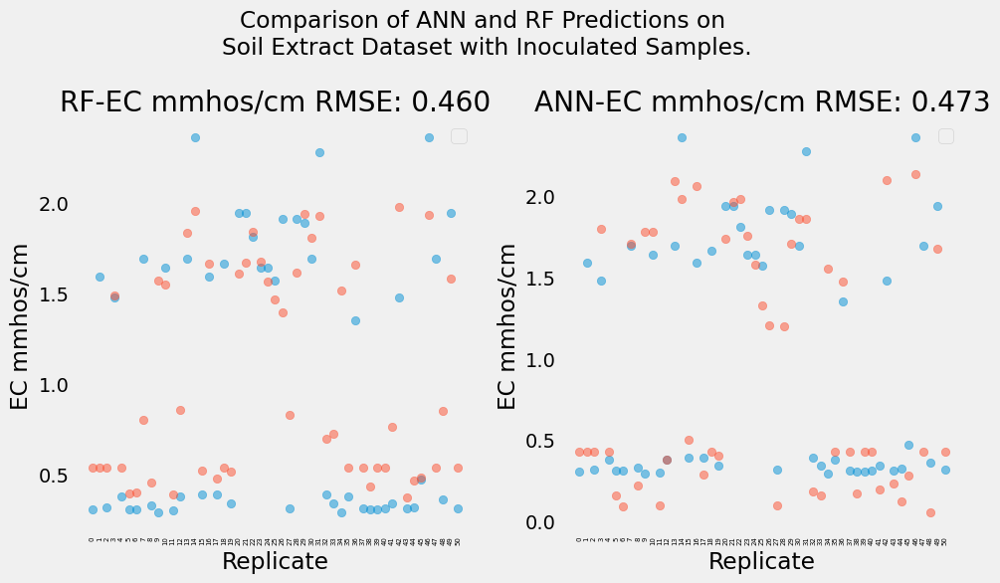

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

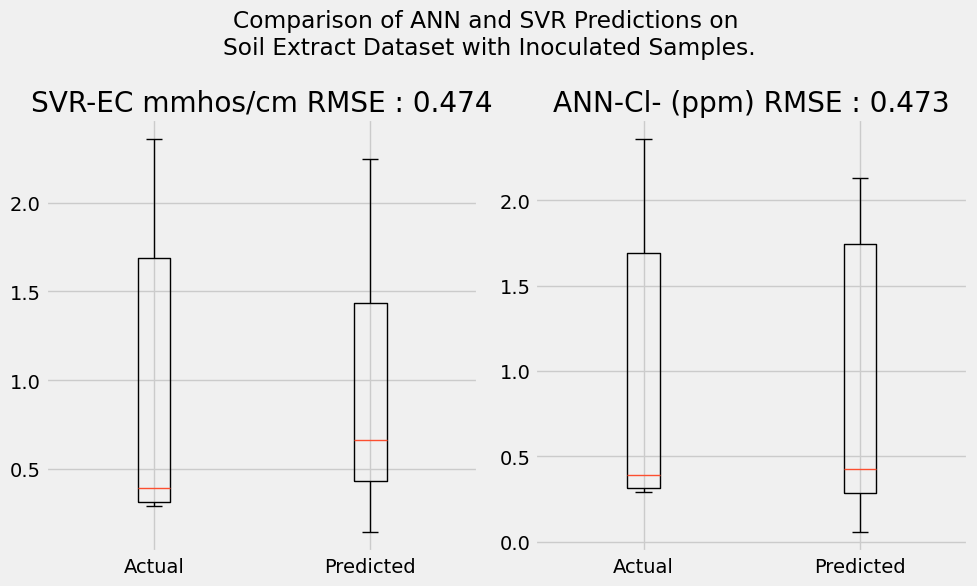

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


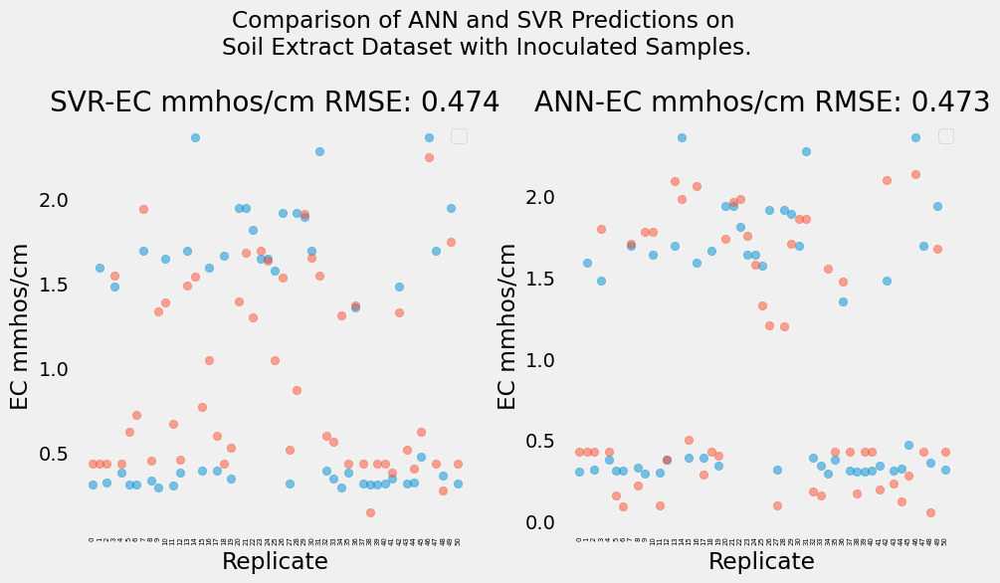

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

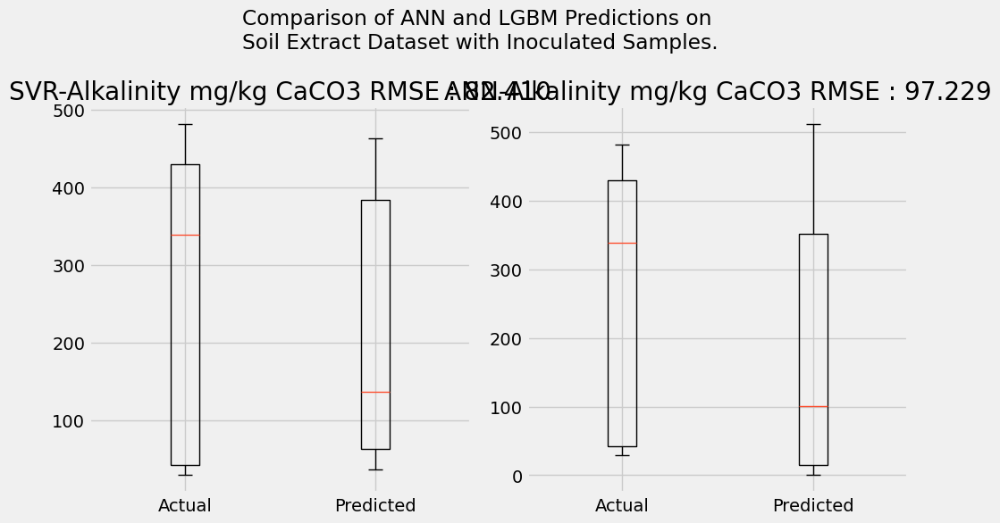

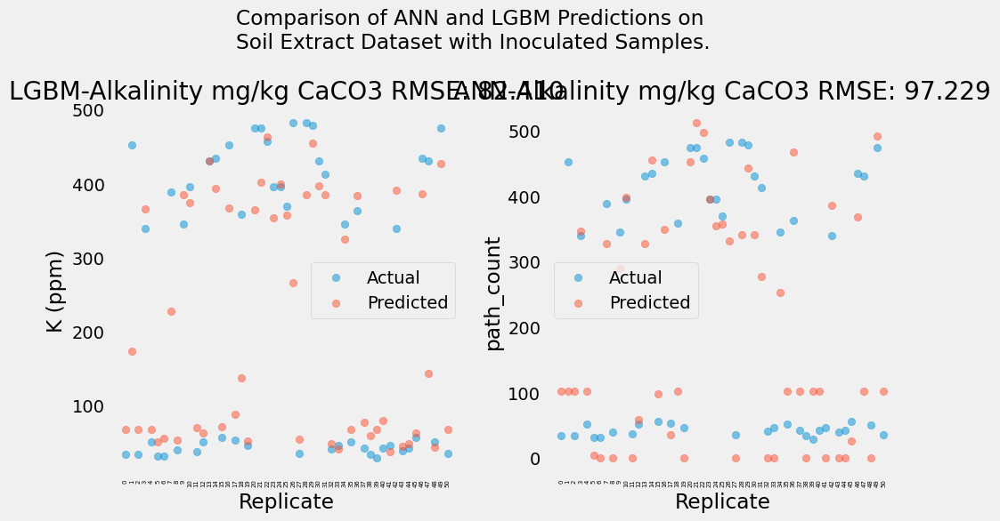

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

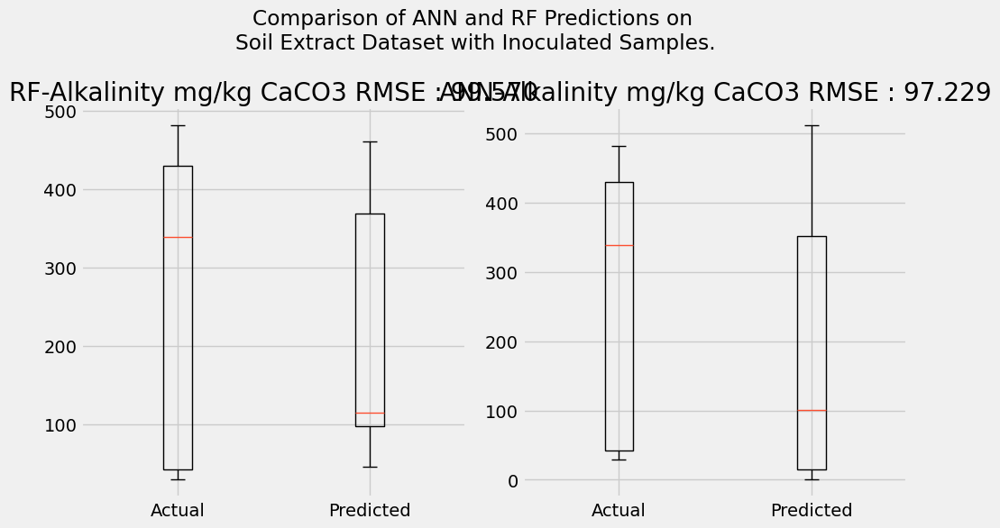

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


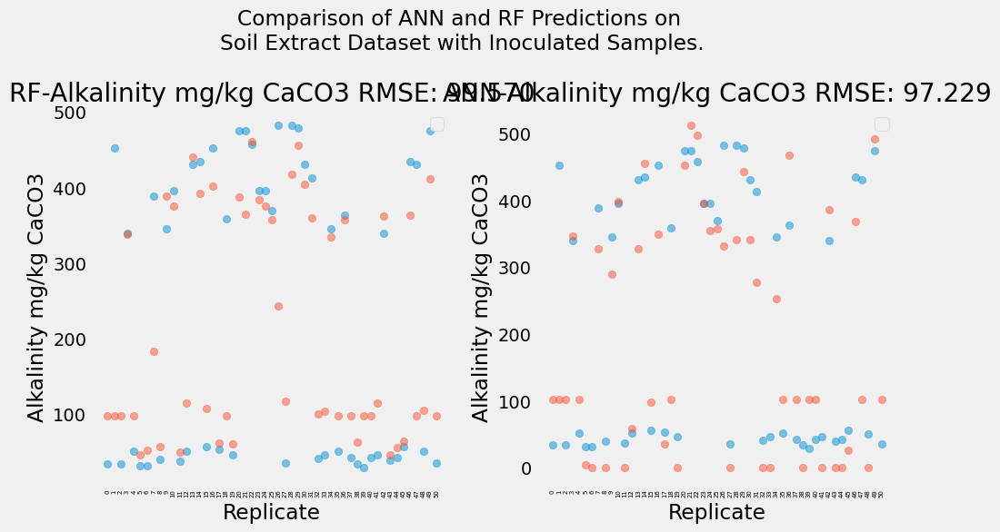

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

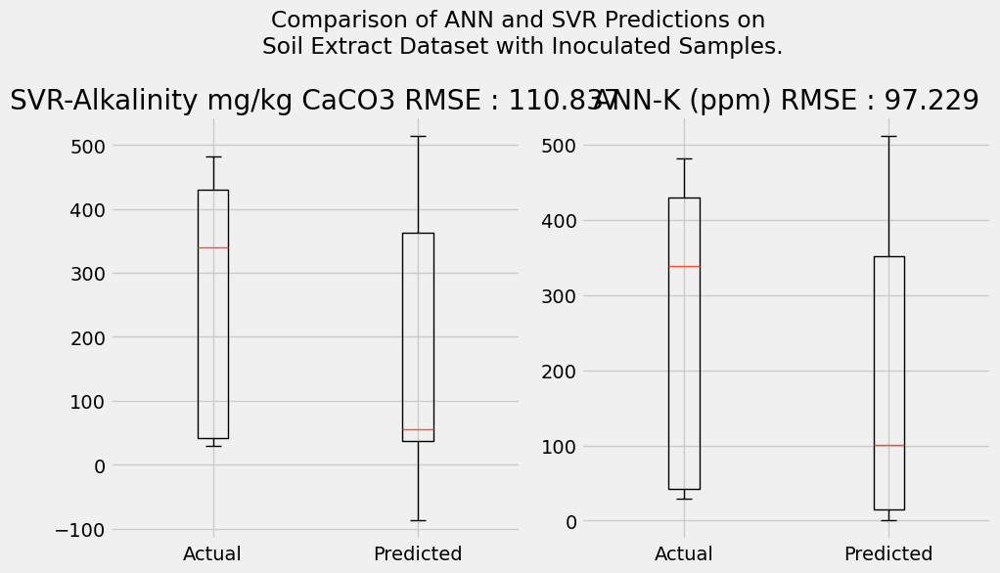

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


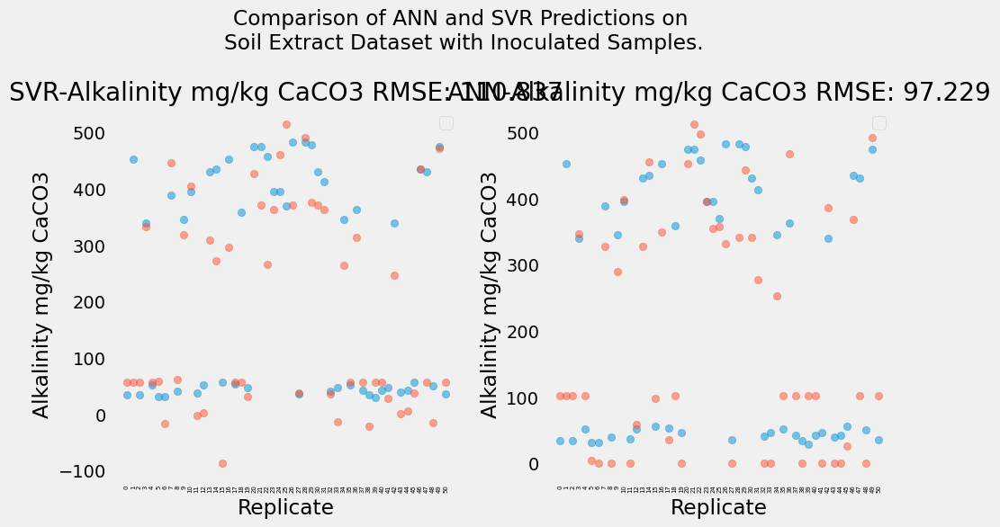

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

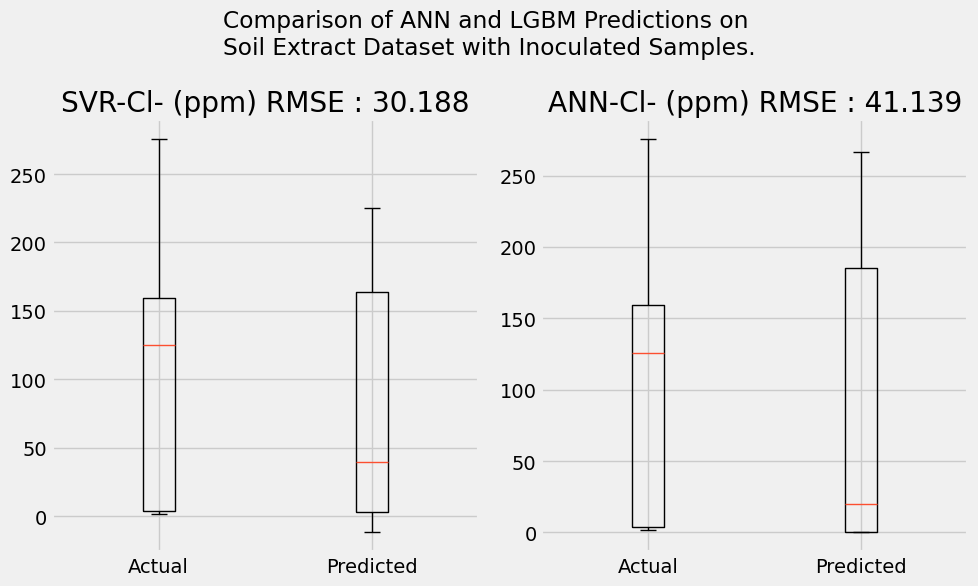

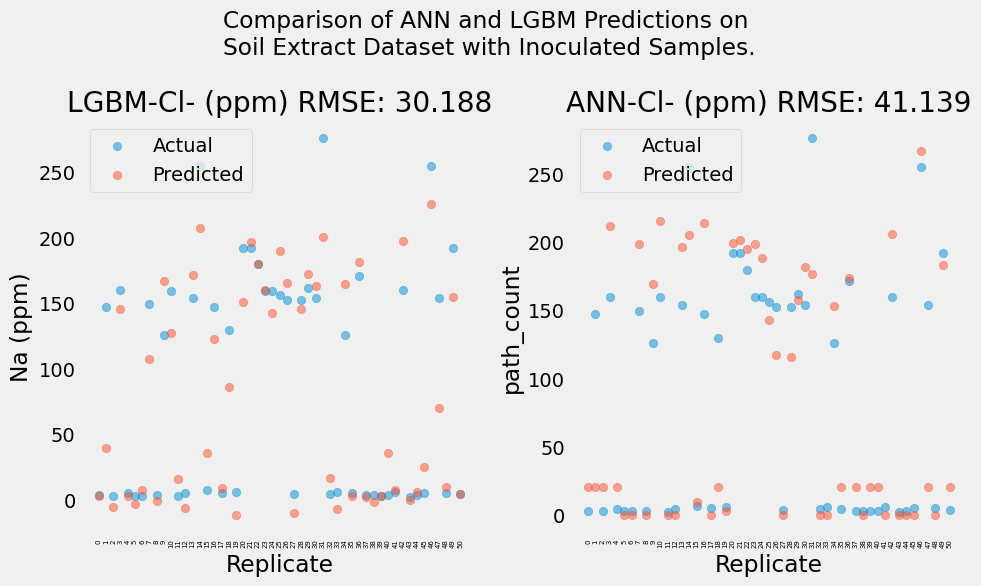

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

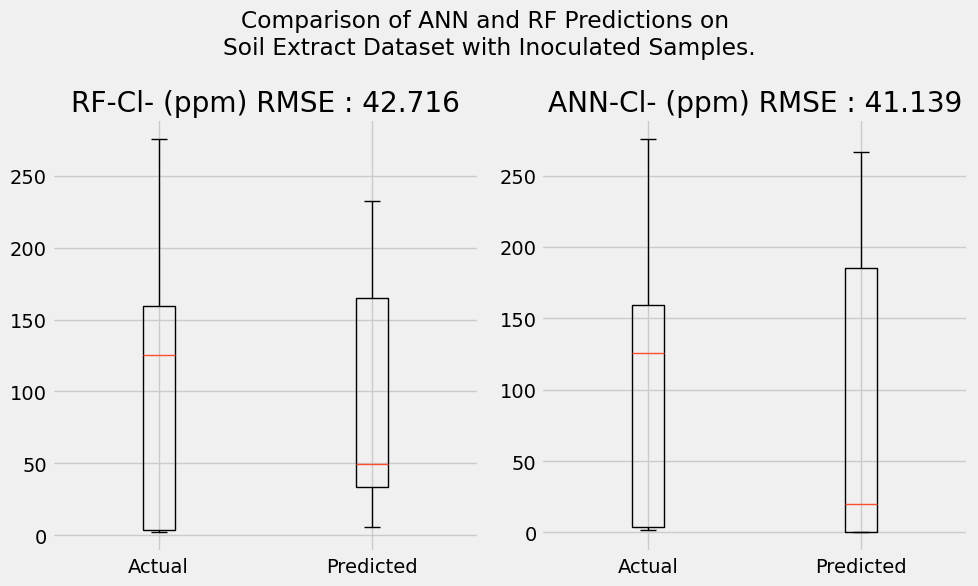

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


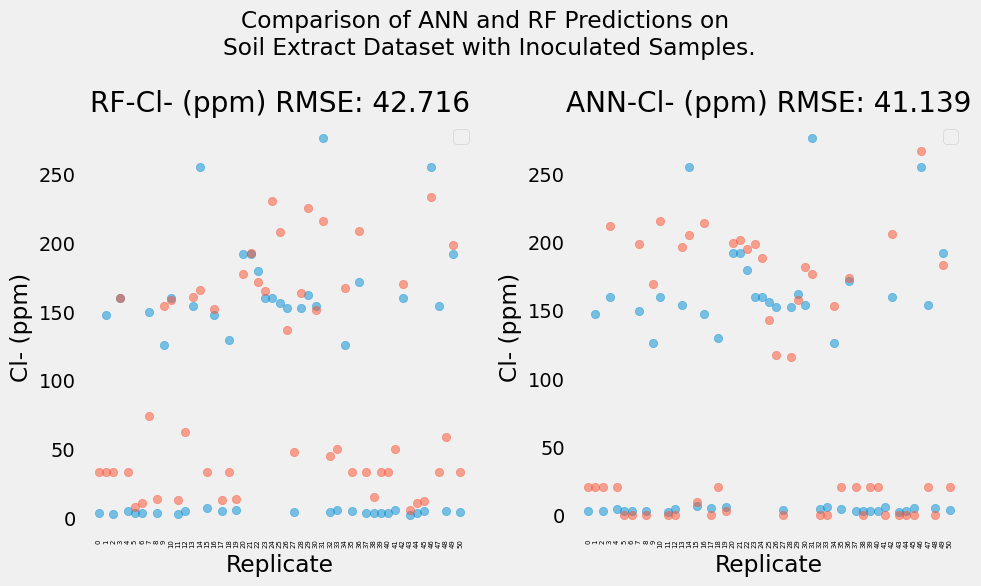

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

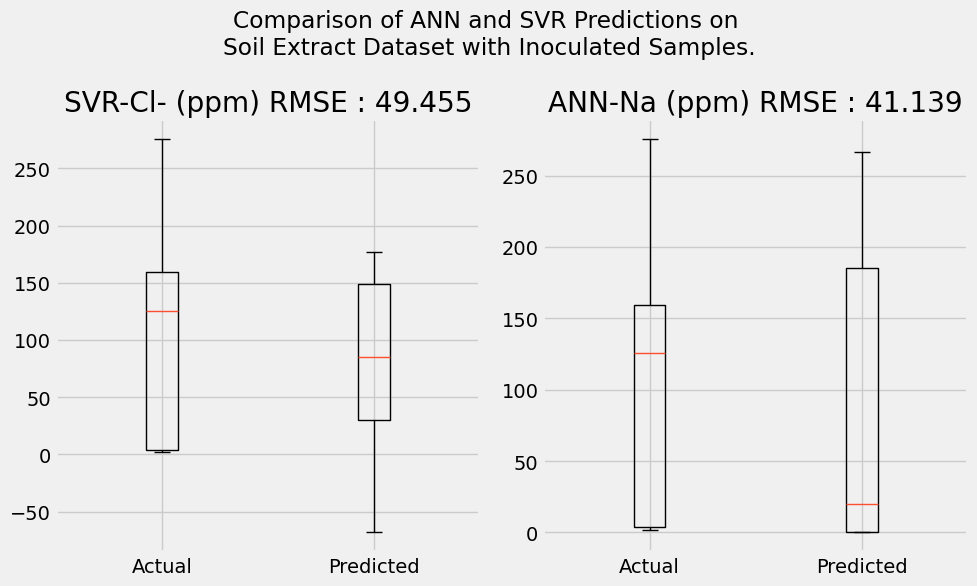

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


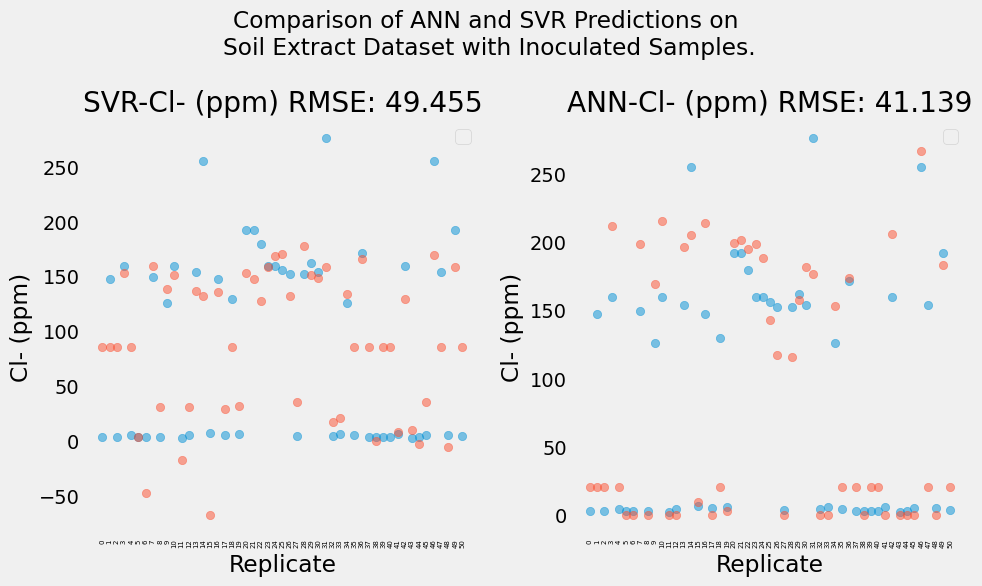

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

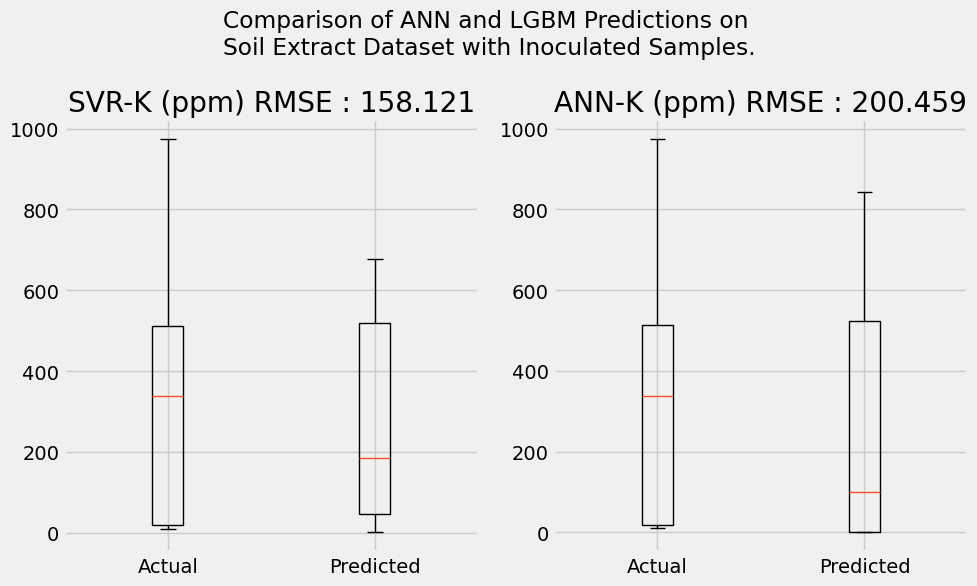

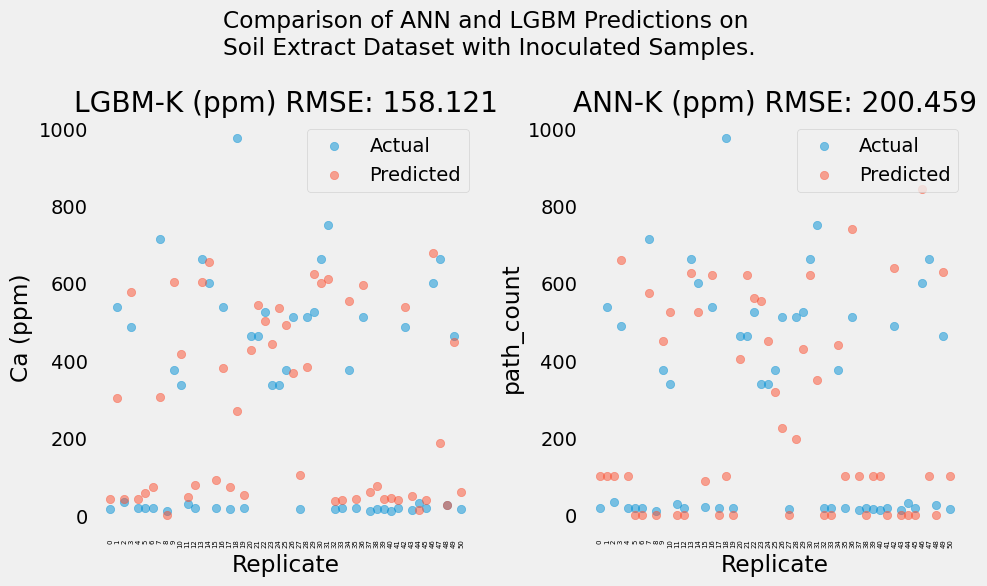

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

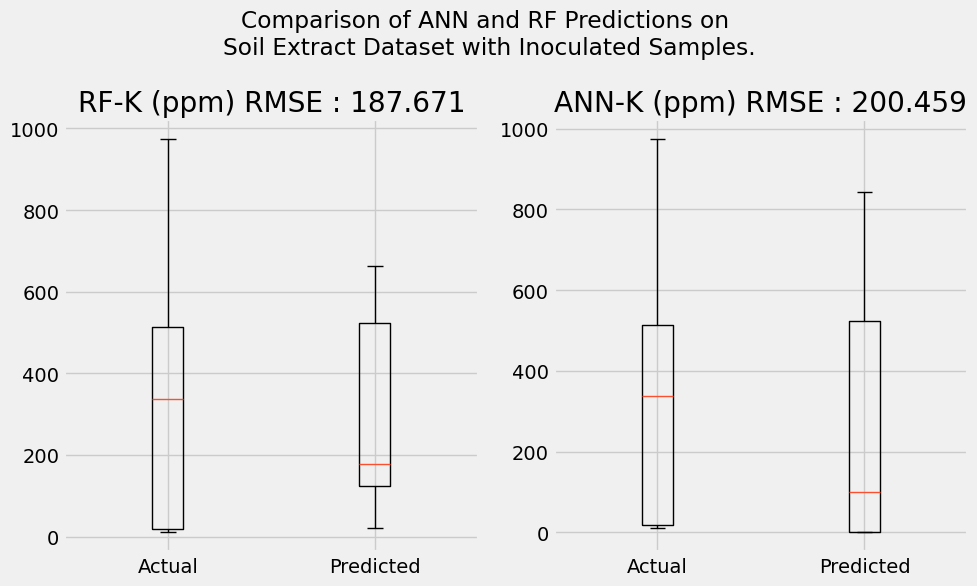

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


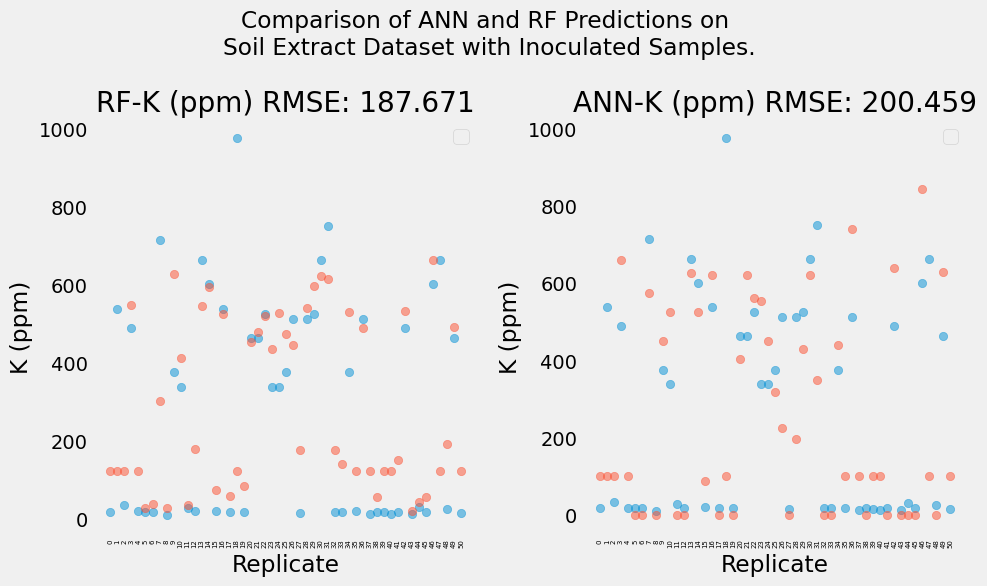

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

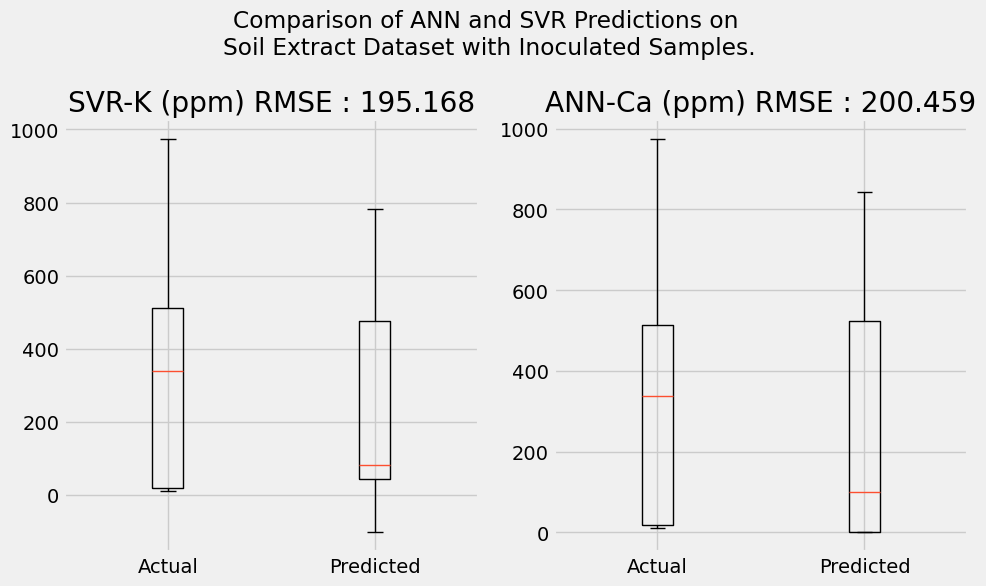

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


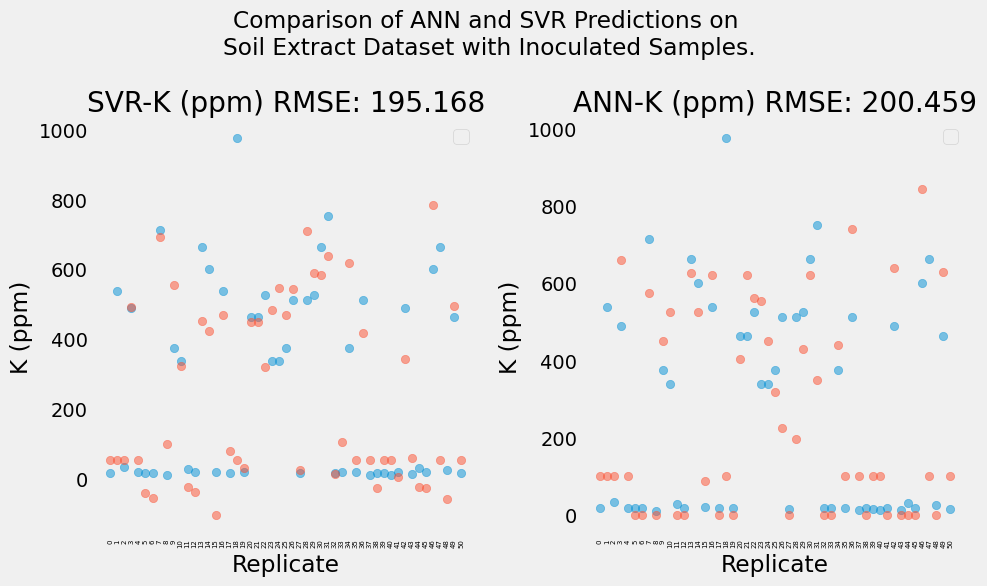

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

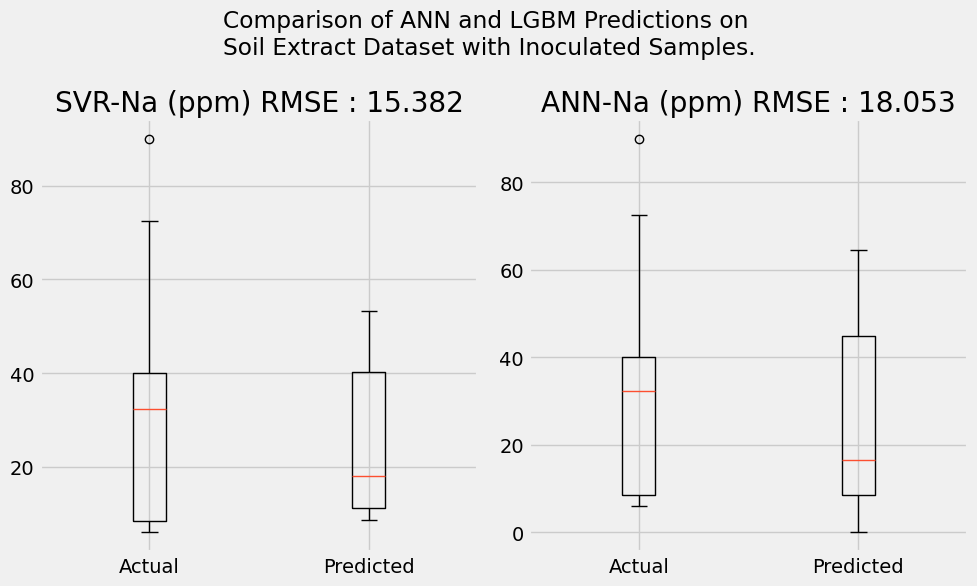

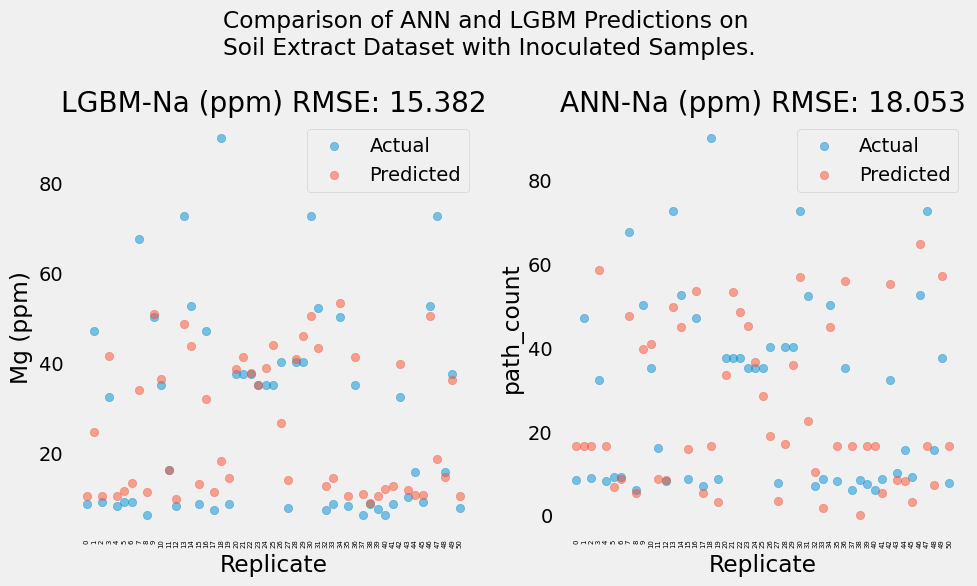

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

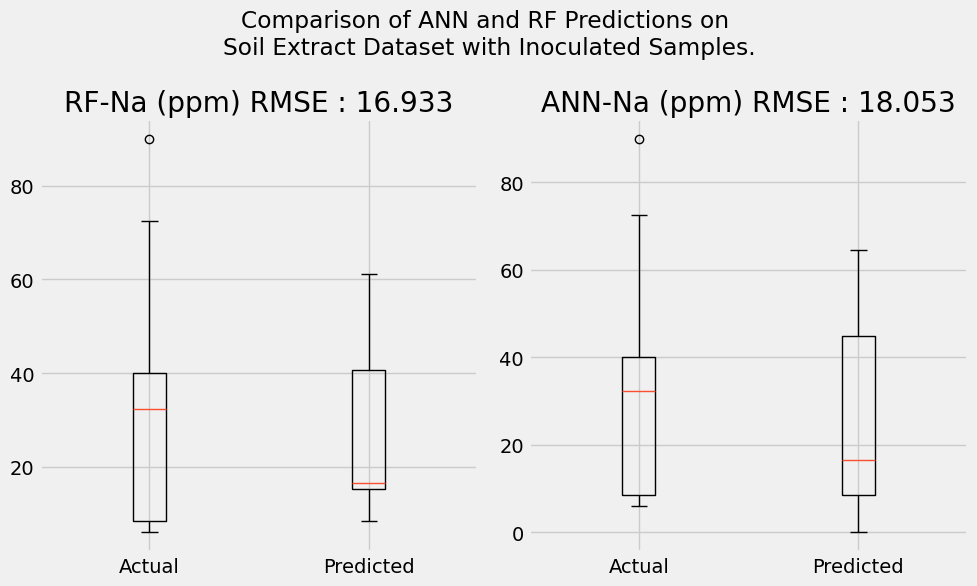

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


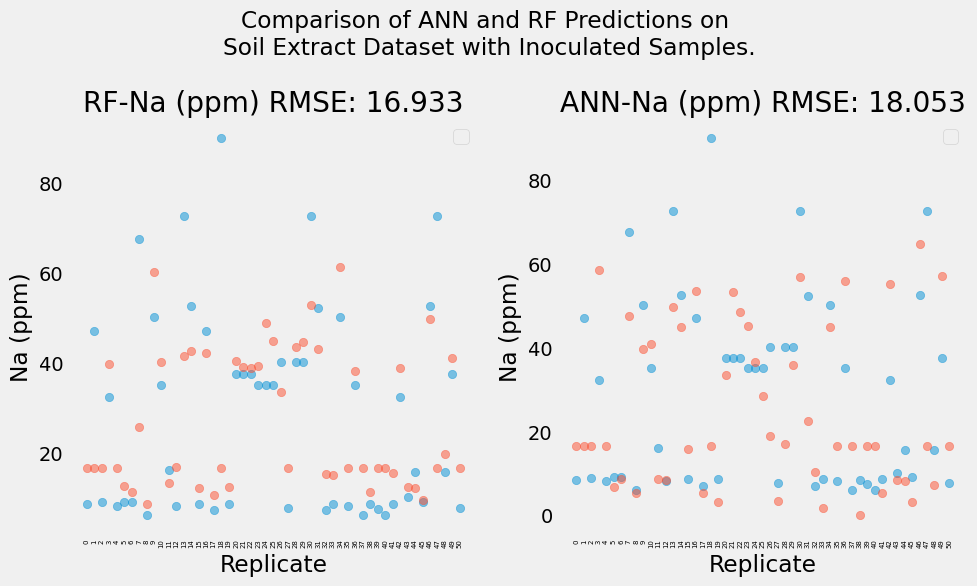

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

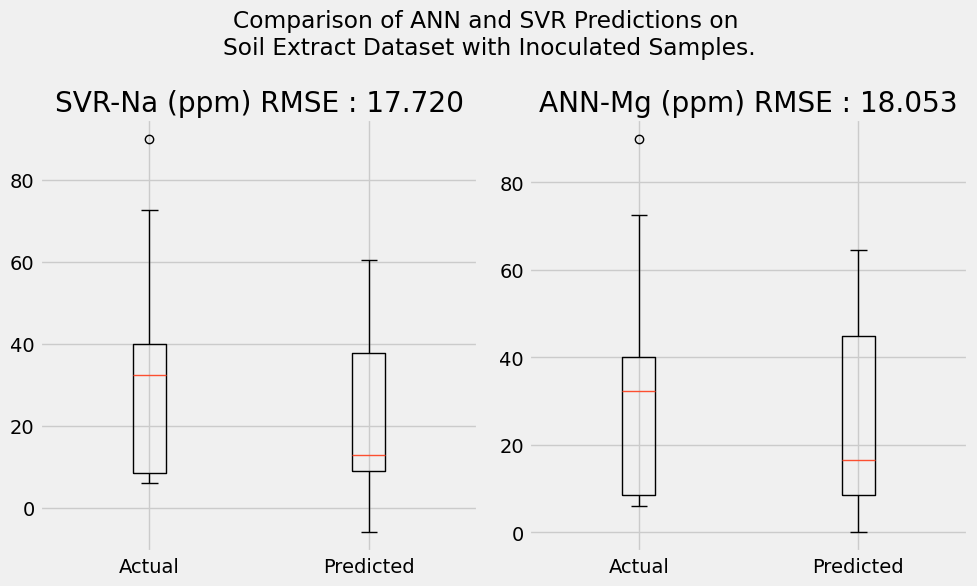

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


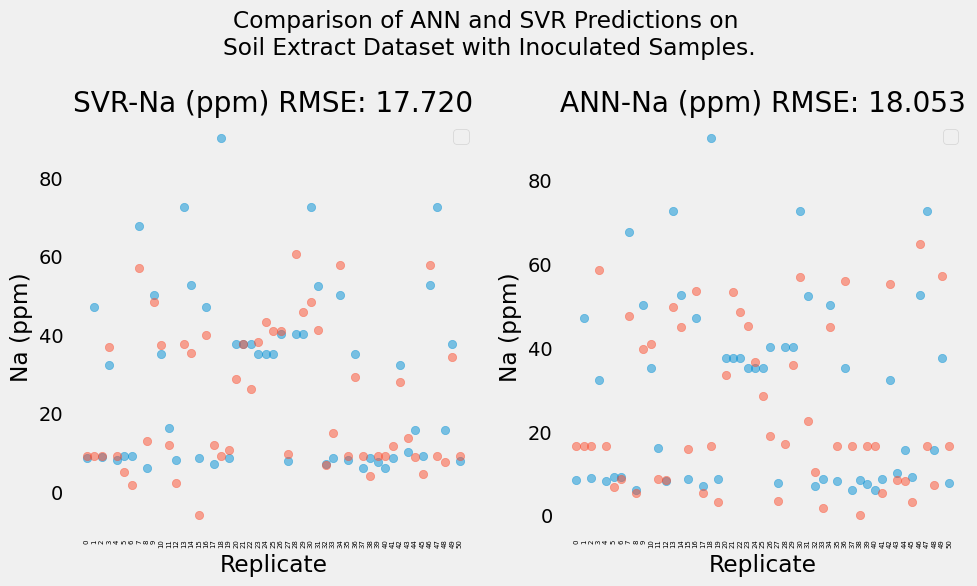

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

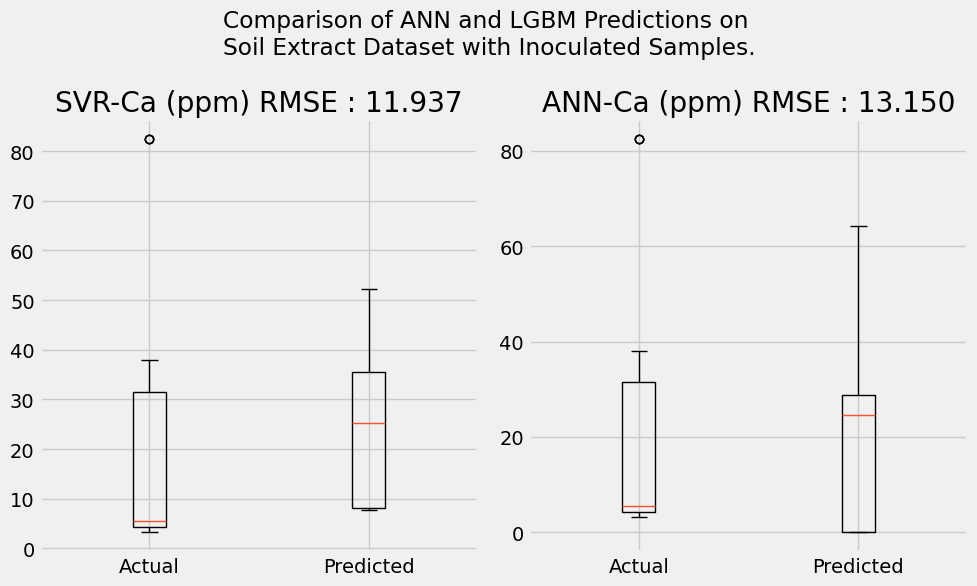

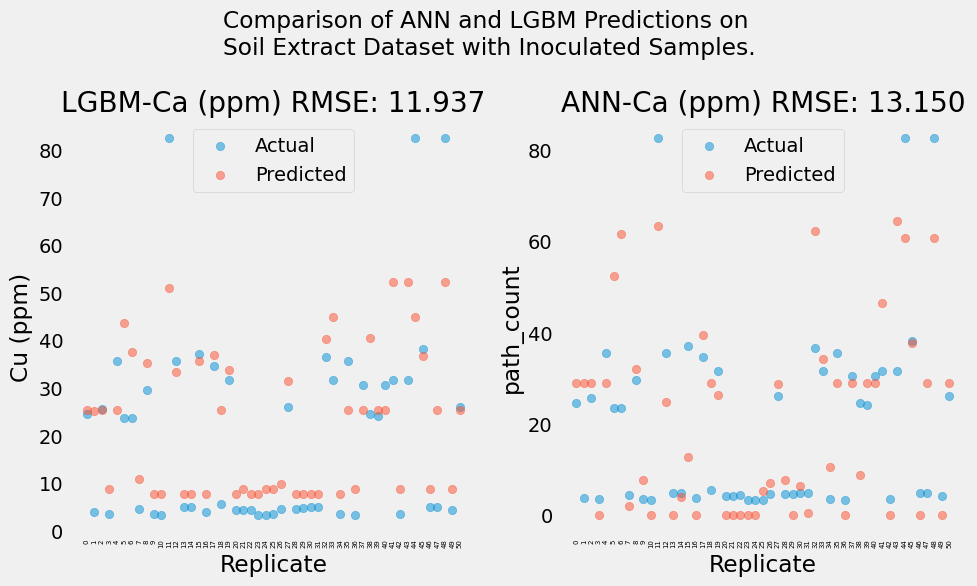

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

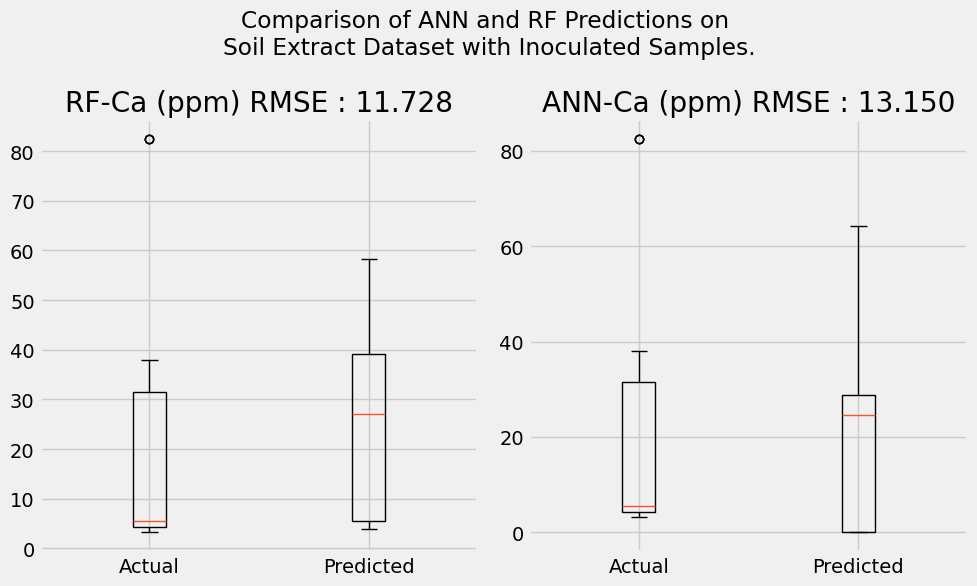

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


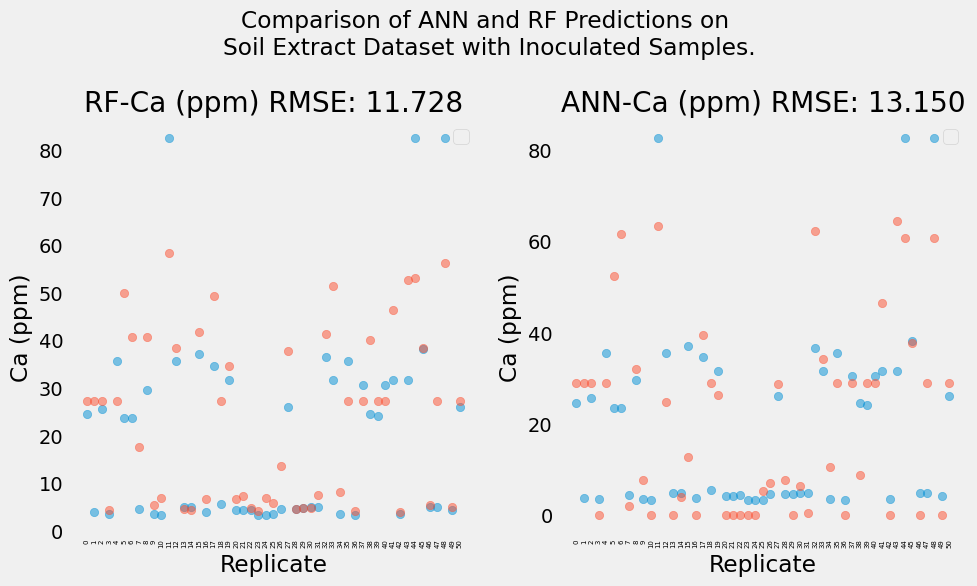

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

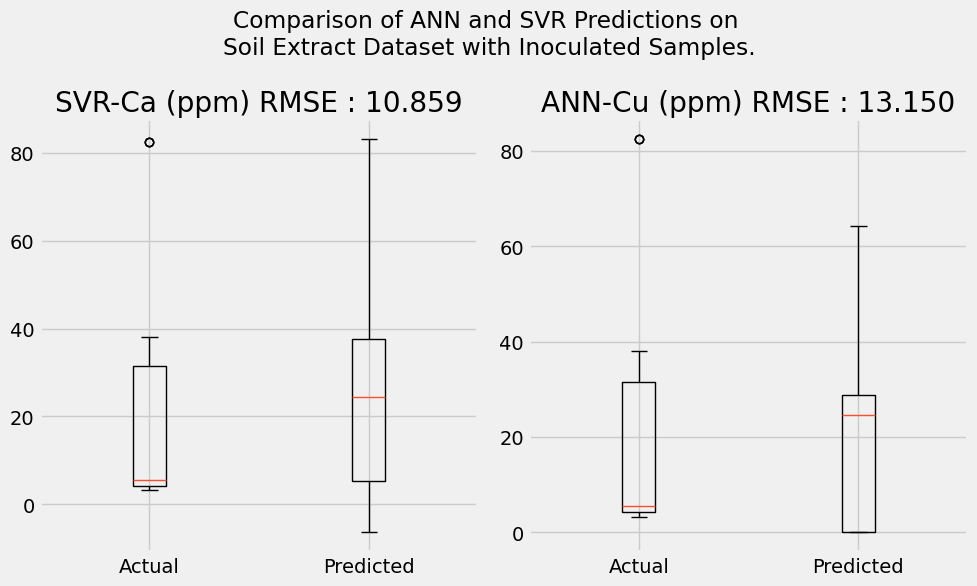

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


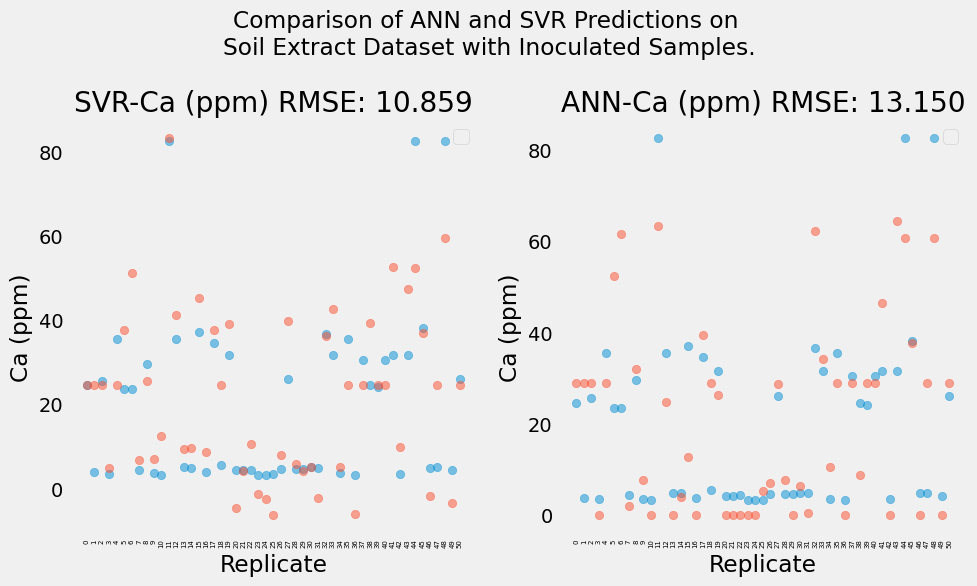

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s

[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

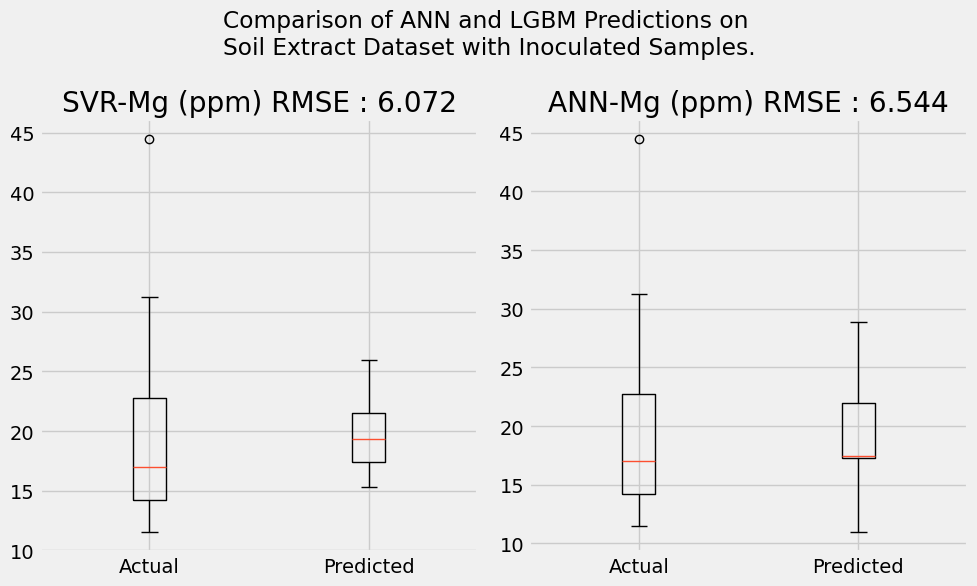

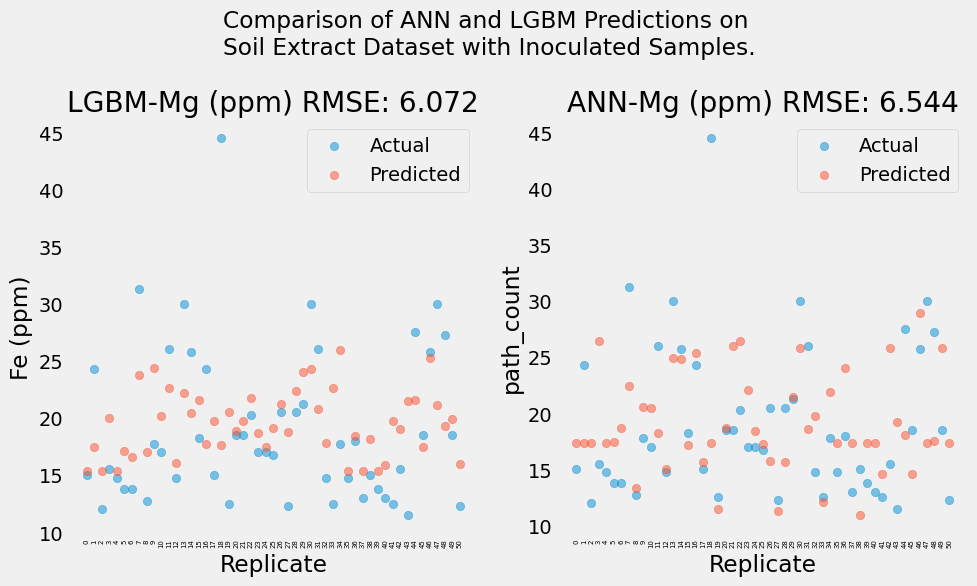

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

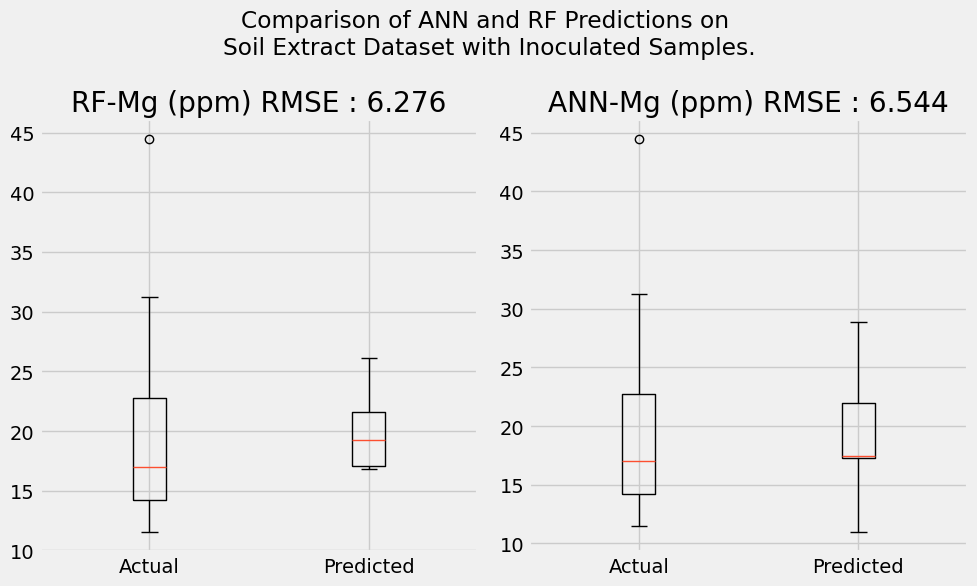

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


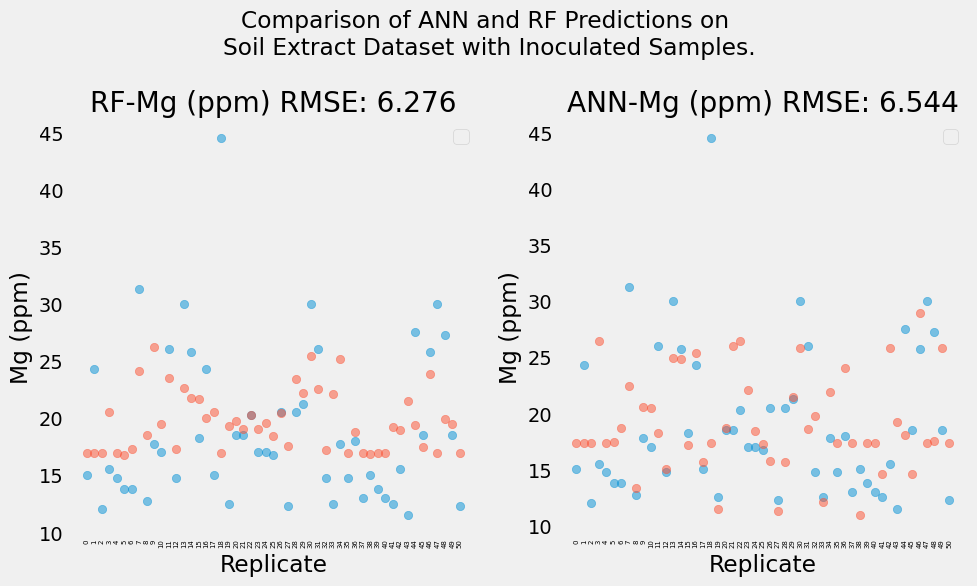

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

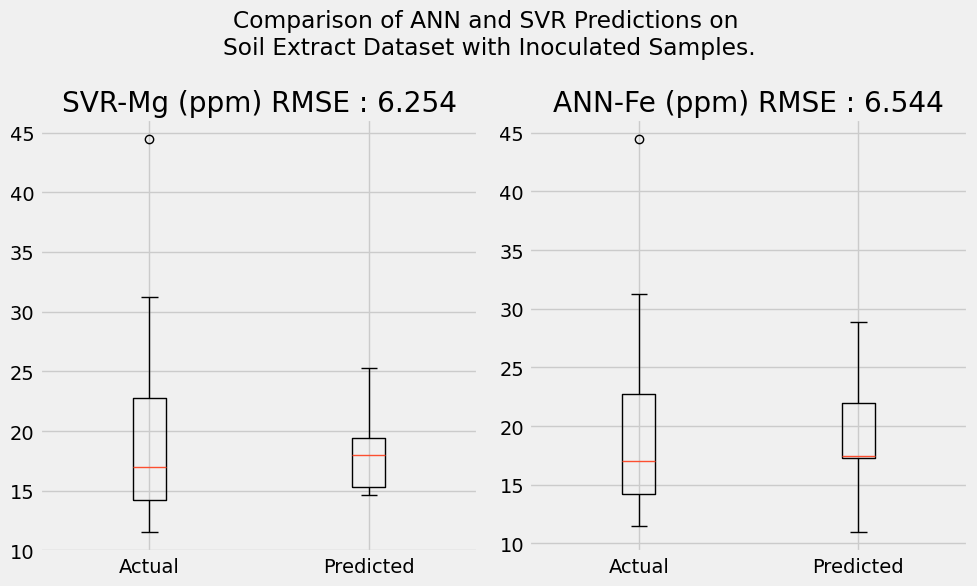

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


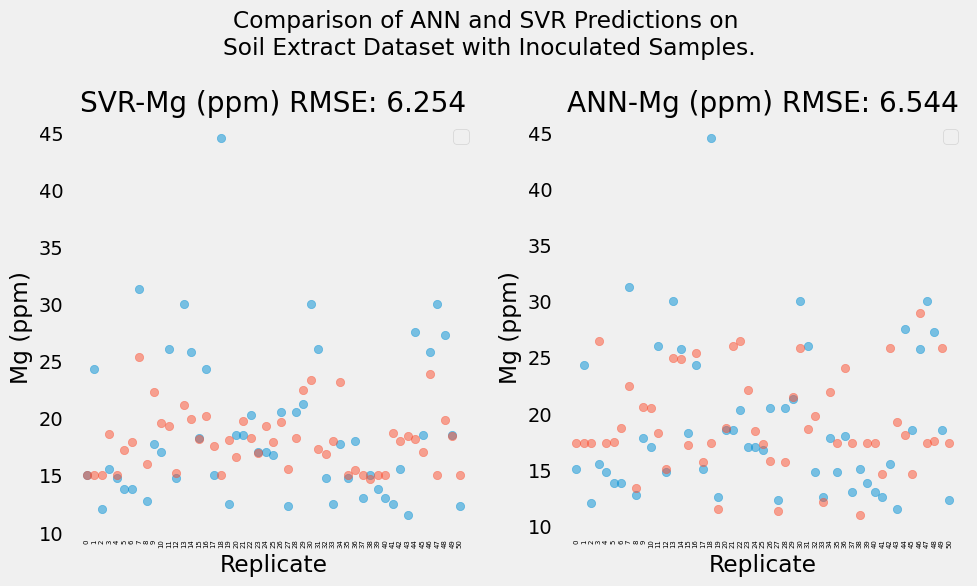

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

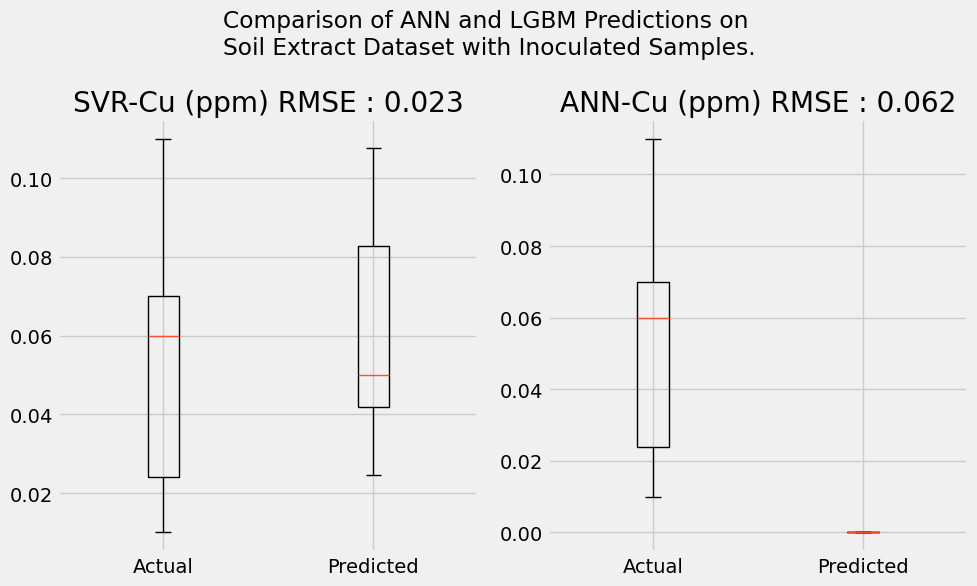

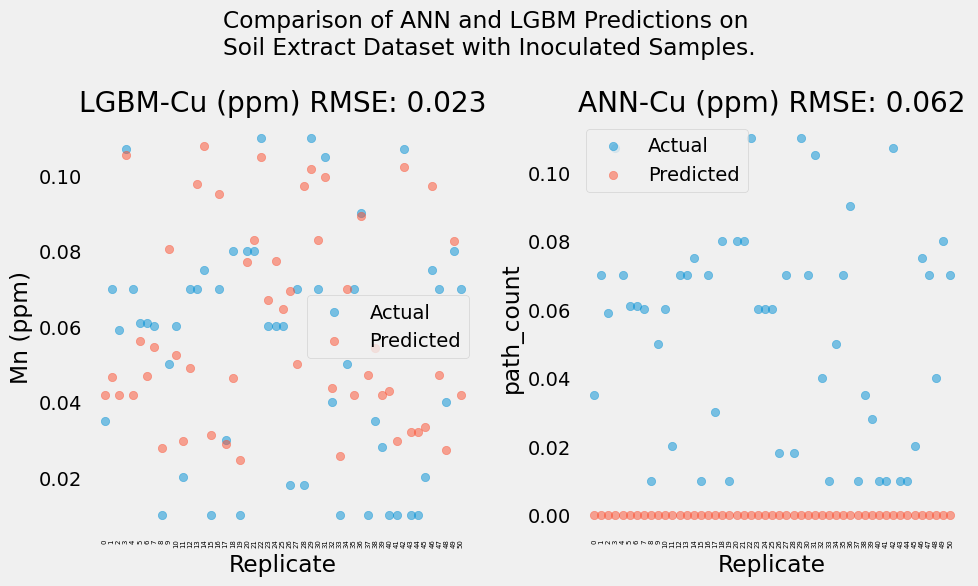

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, 

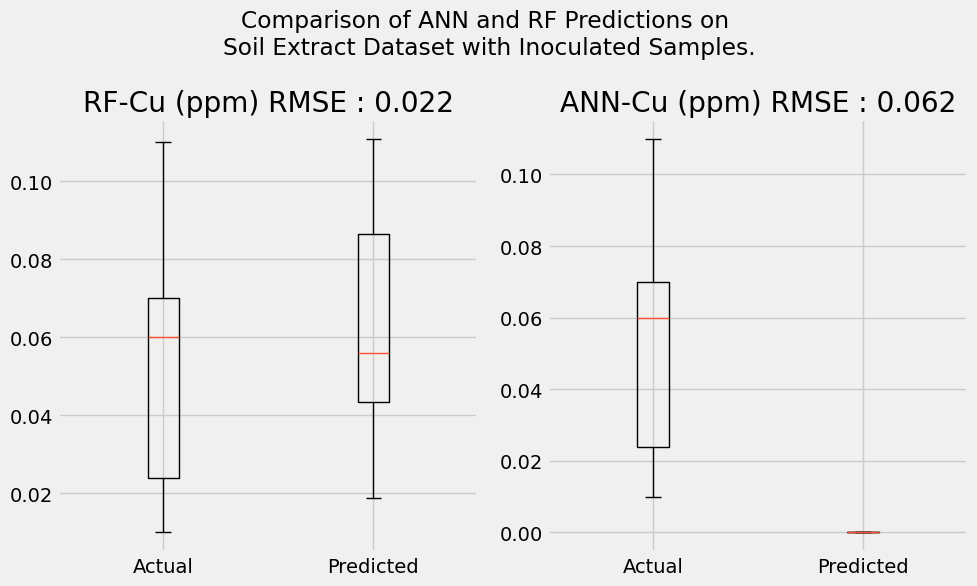

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


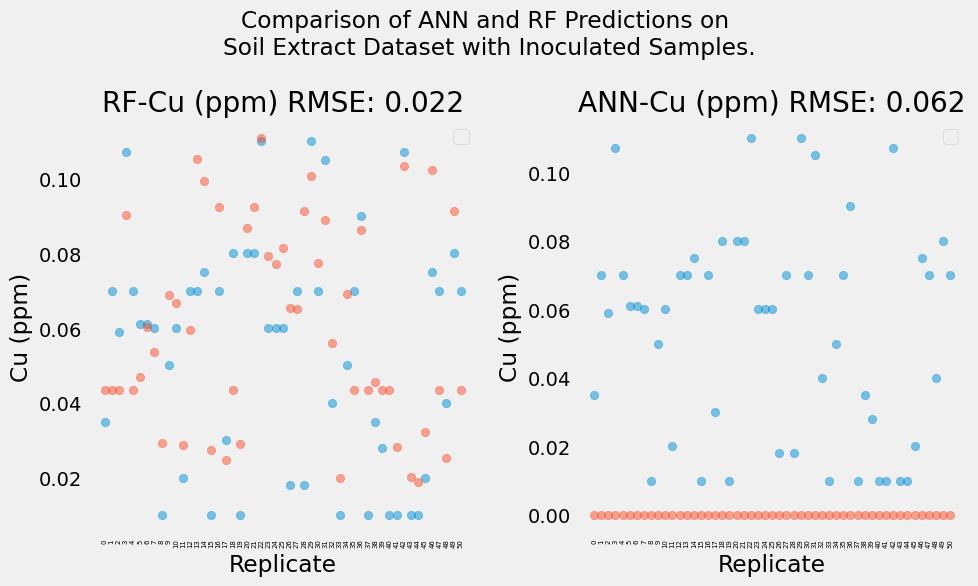

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

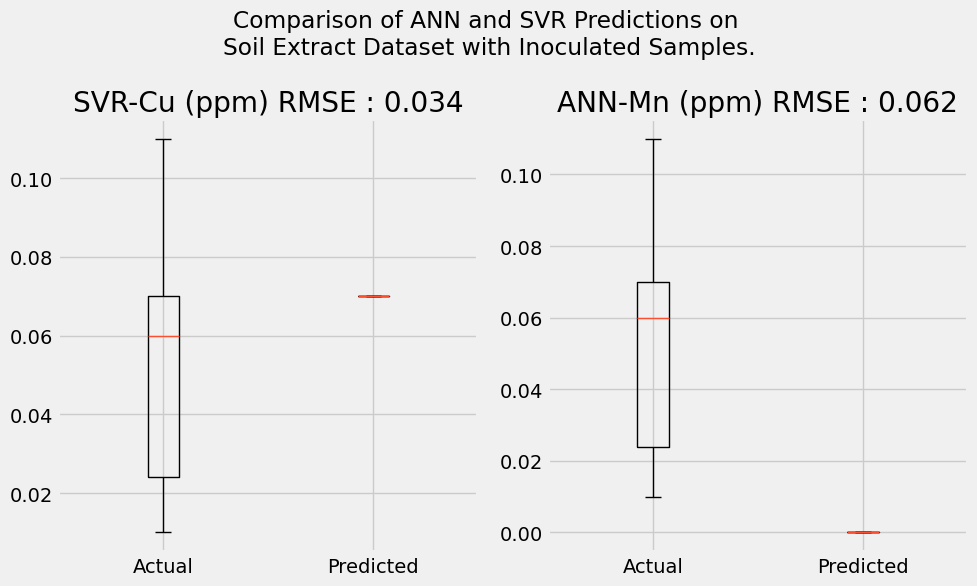

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


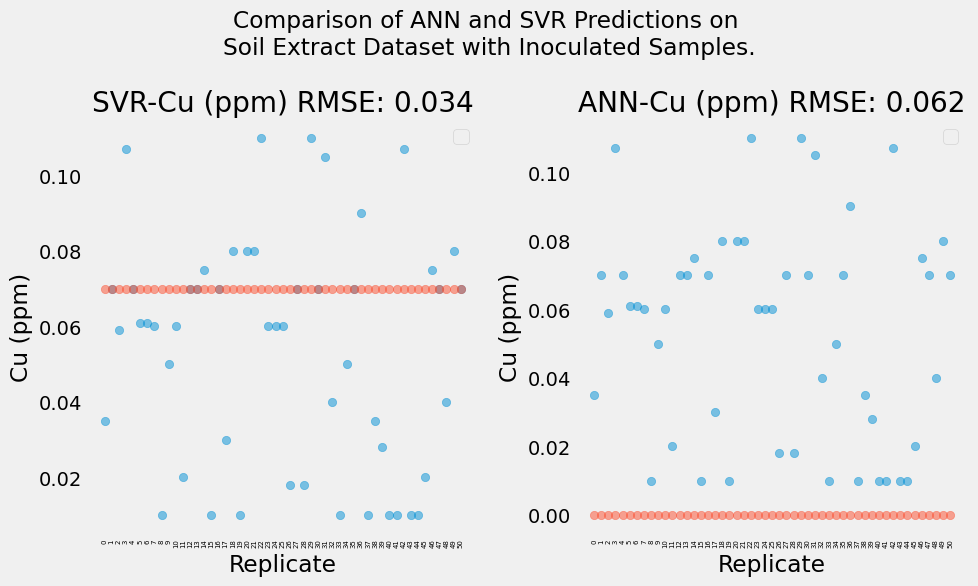

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

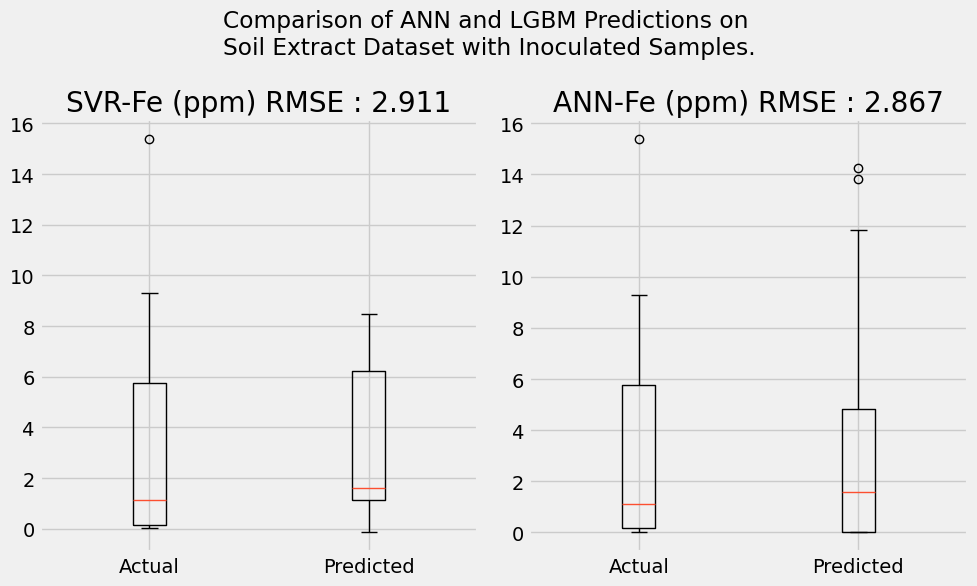

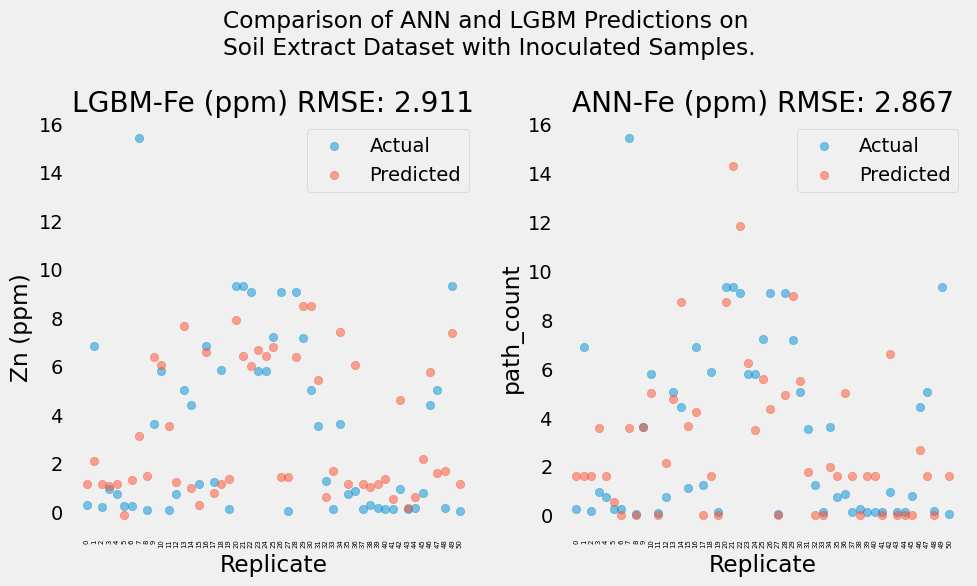

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

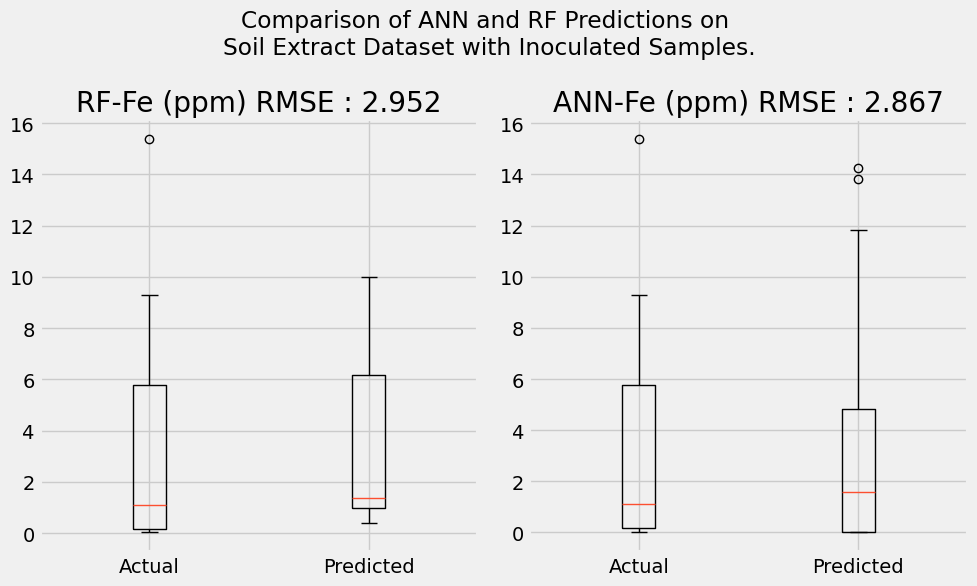

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


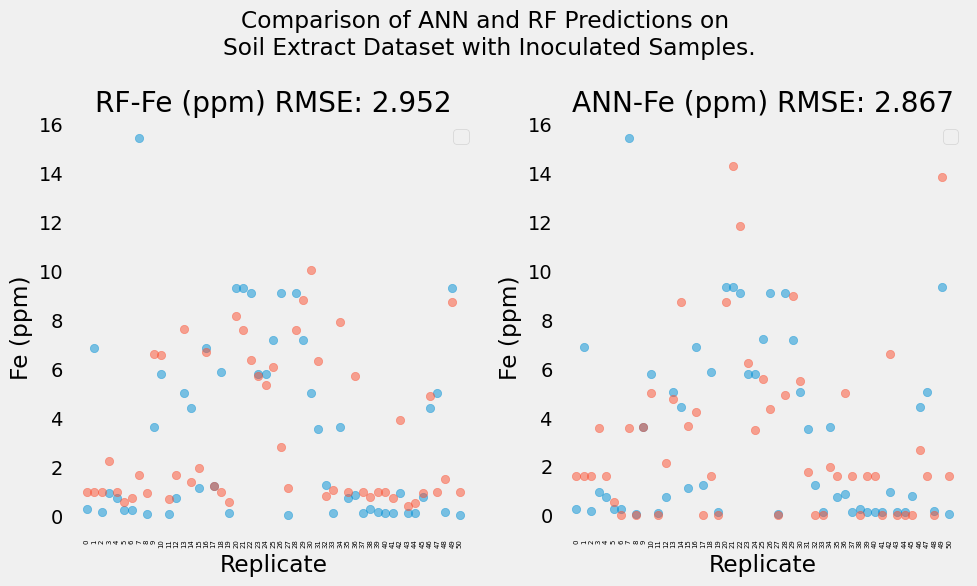

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

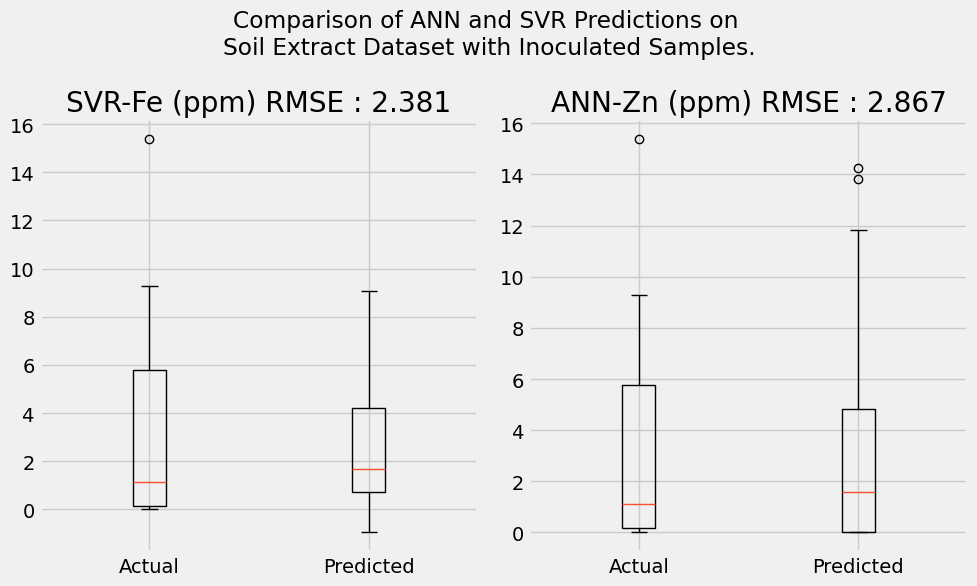

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


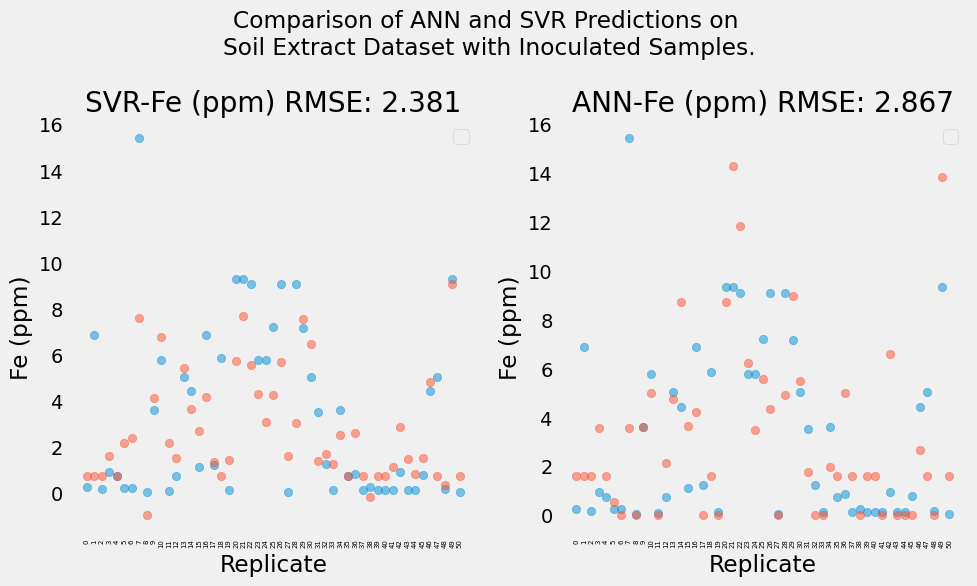

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

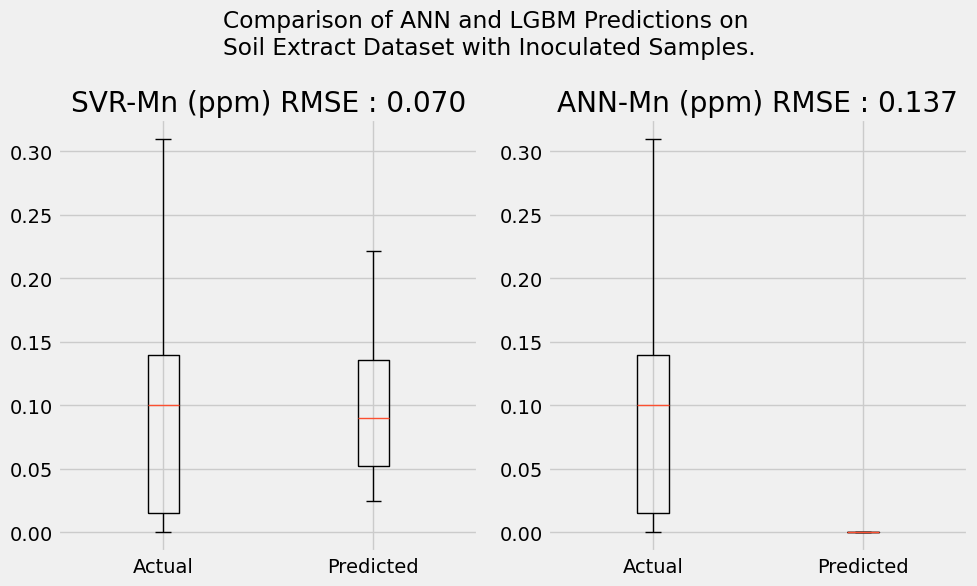

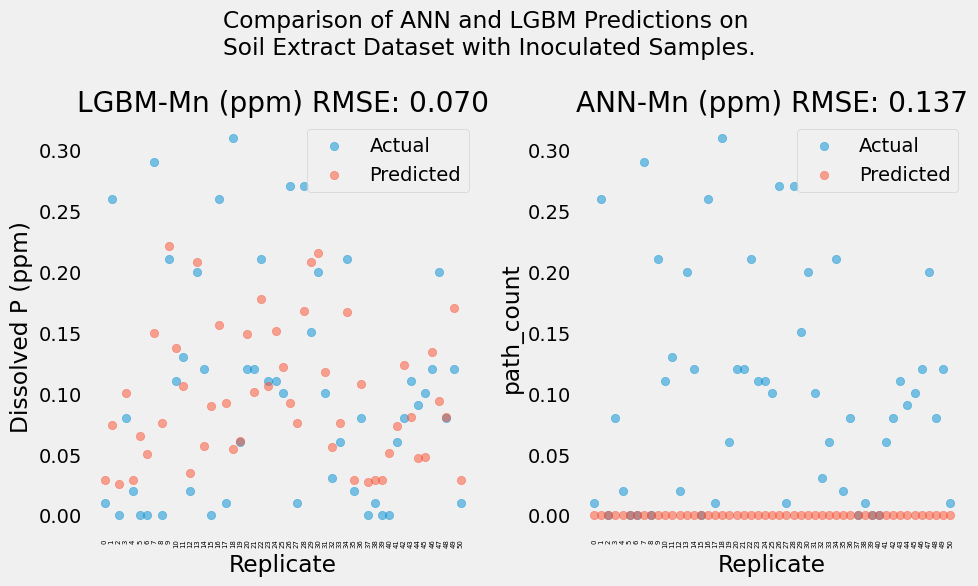

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

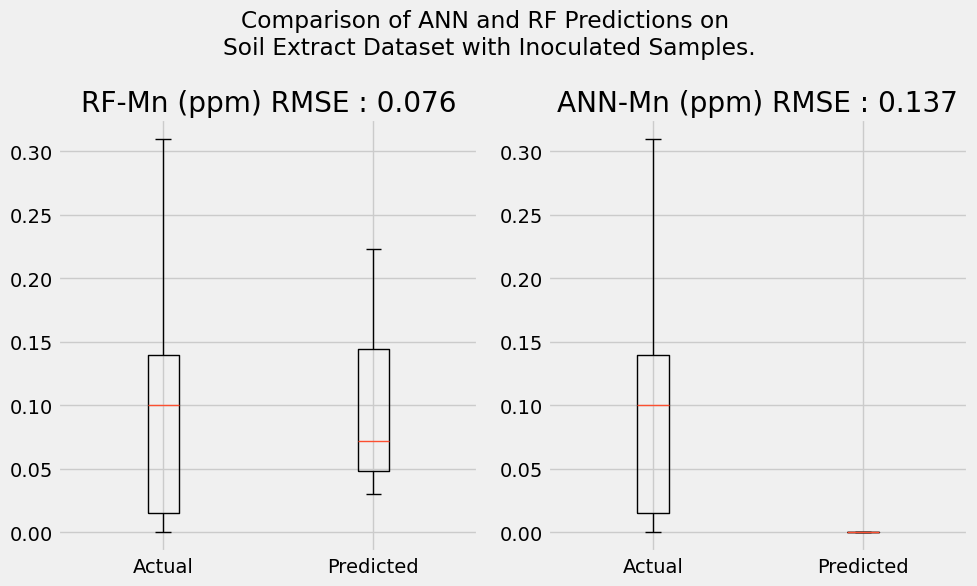

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


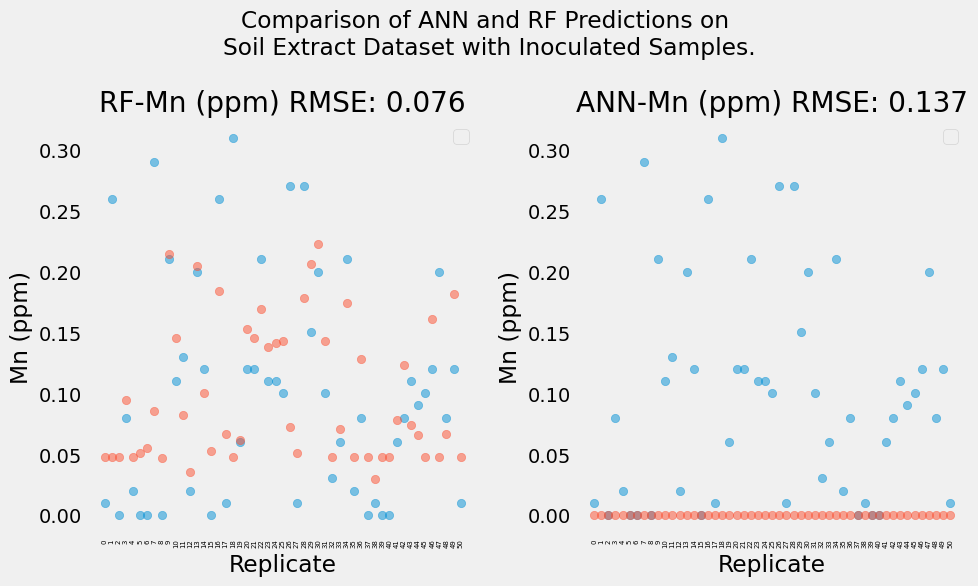

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

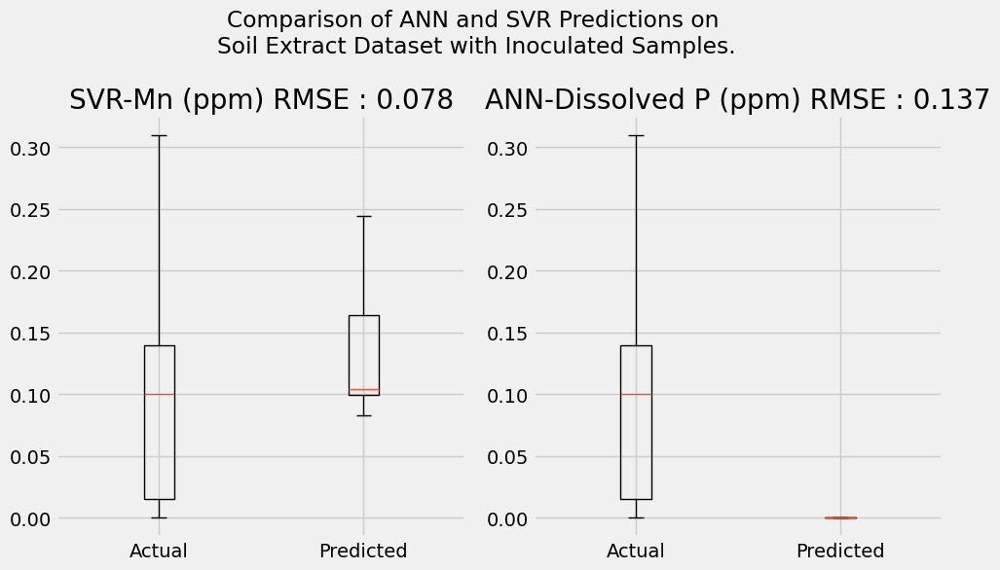

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


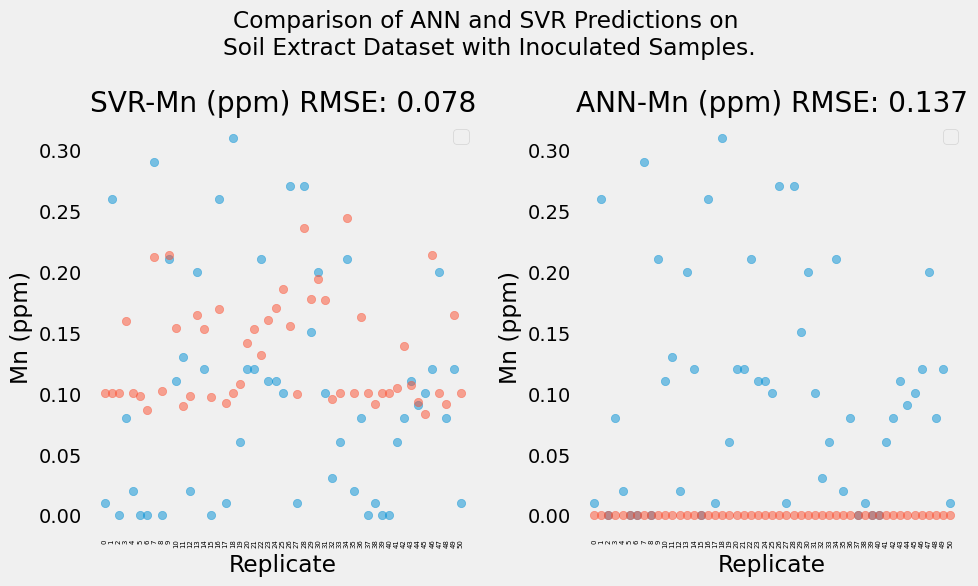

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

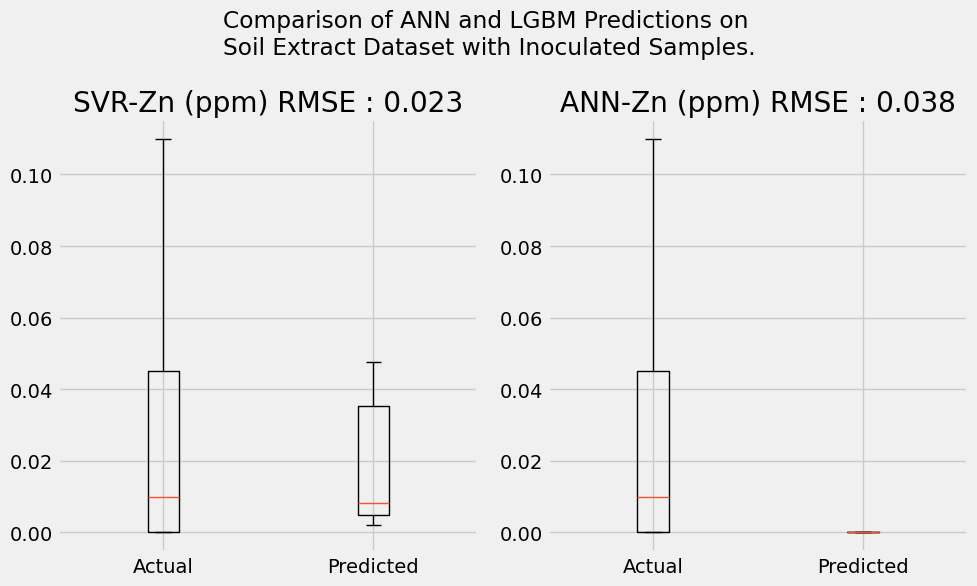

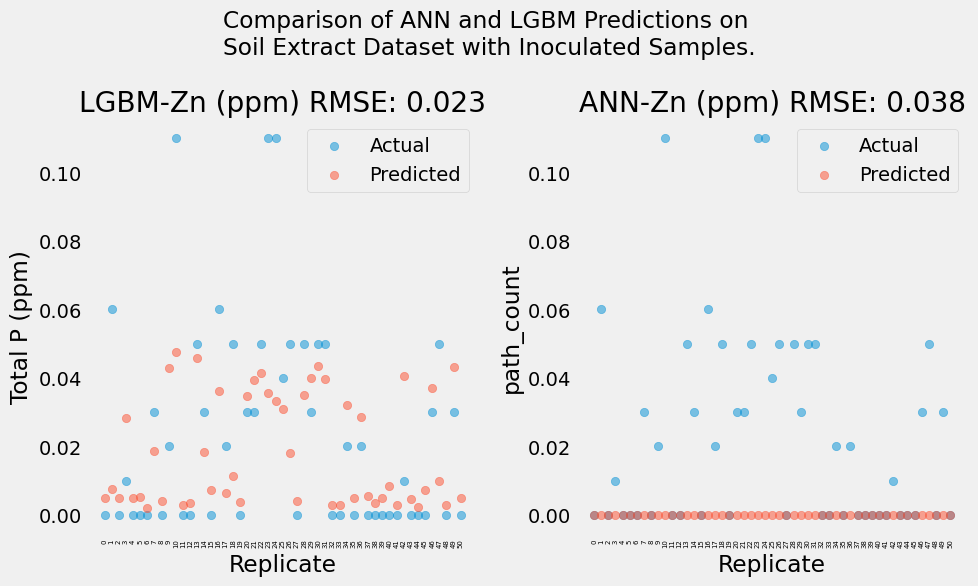

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

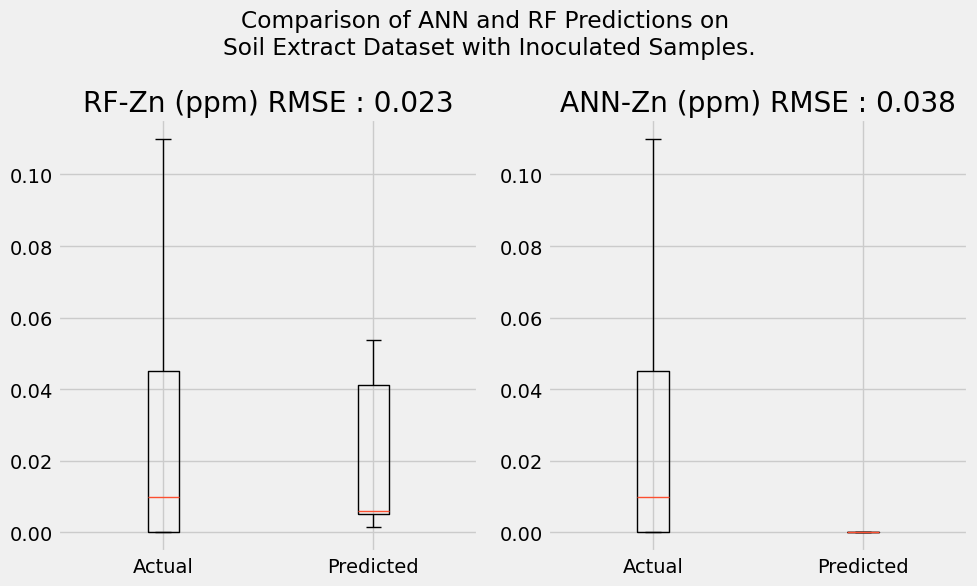

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


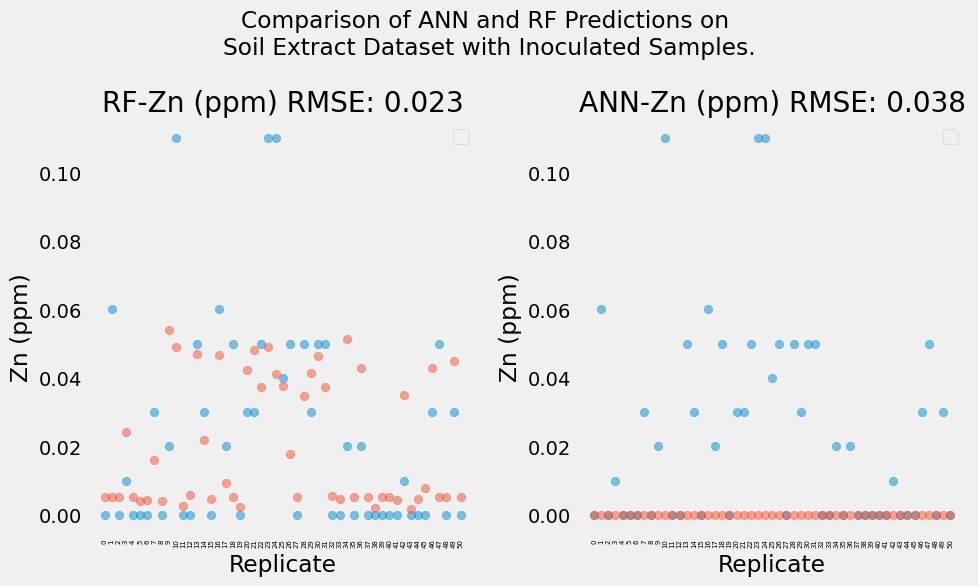

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

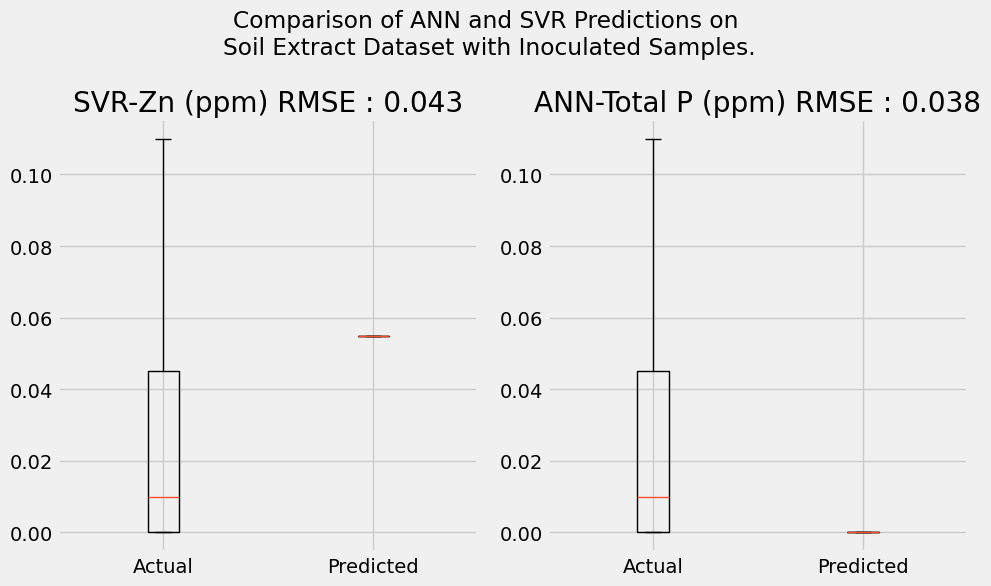

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


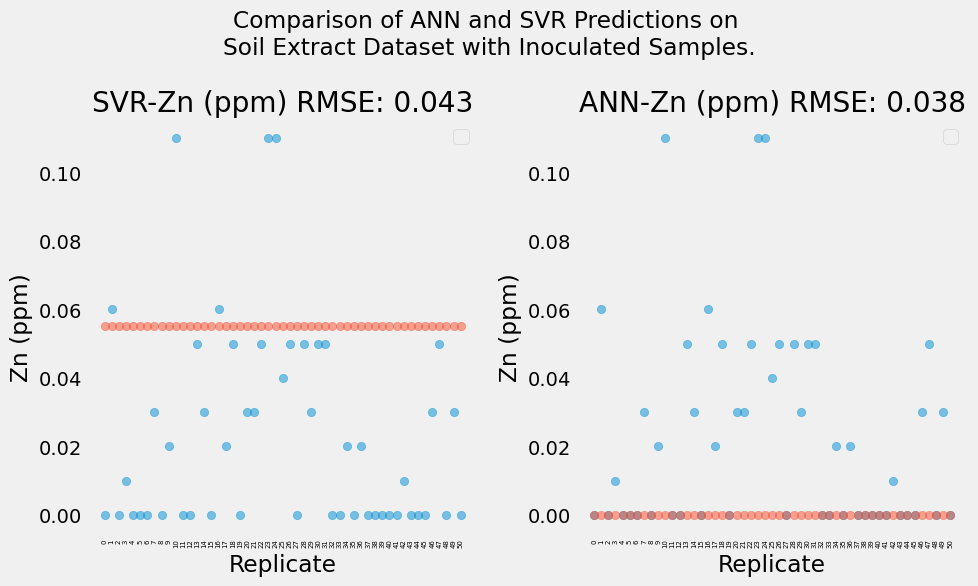

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

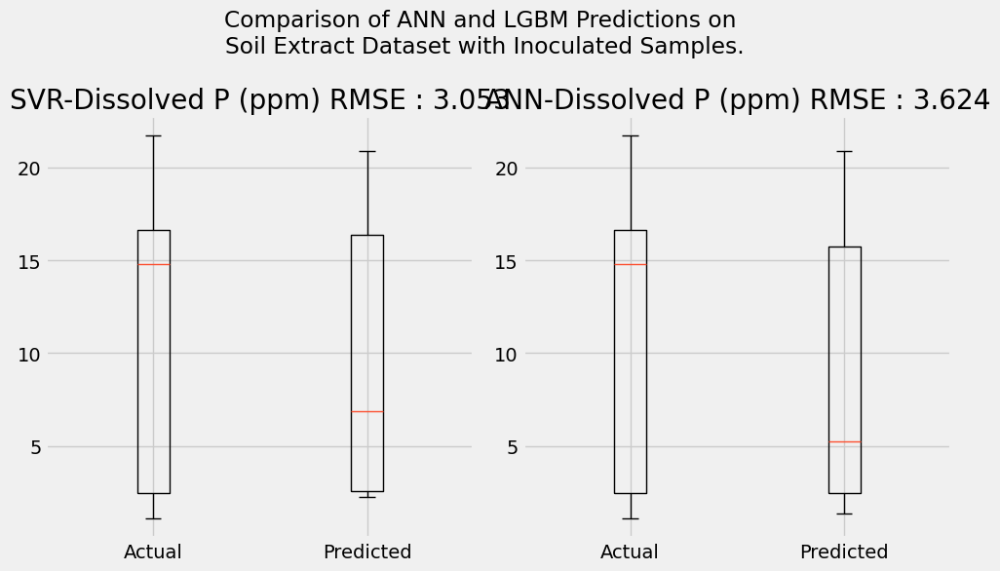

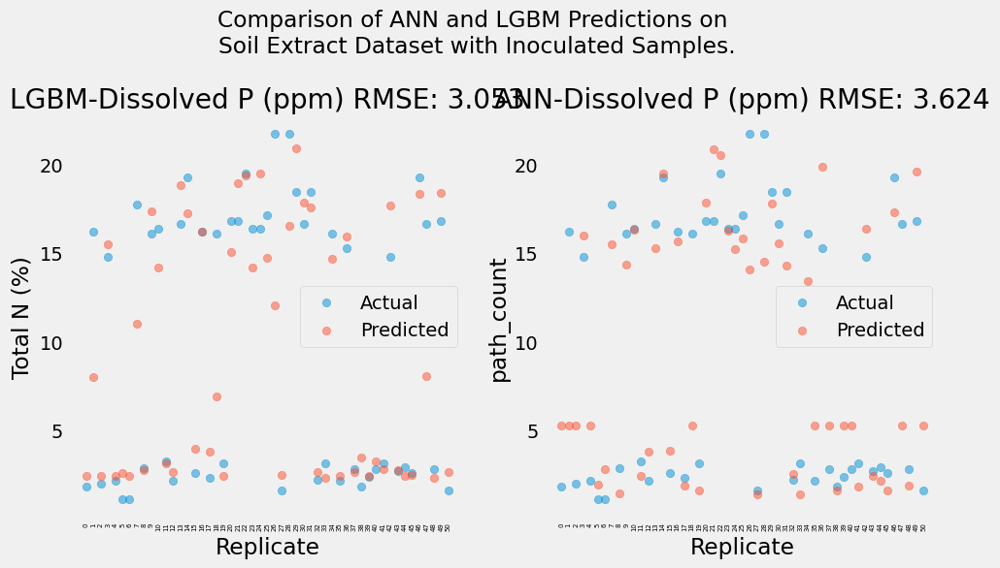

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

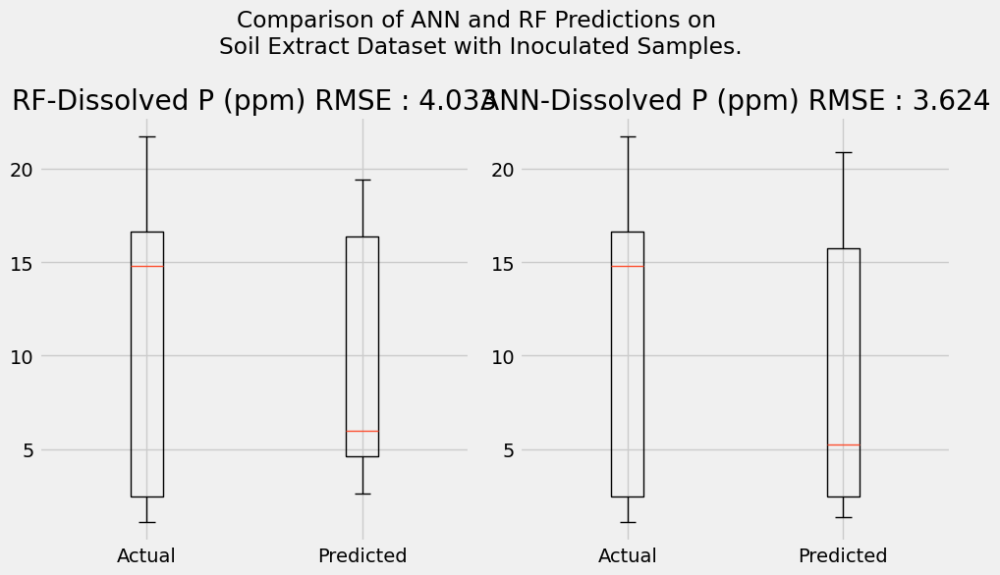

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


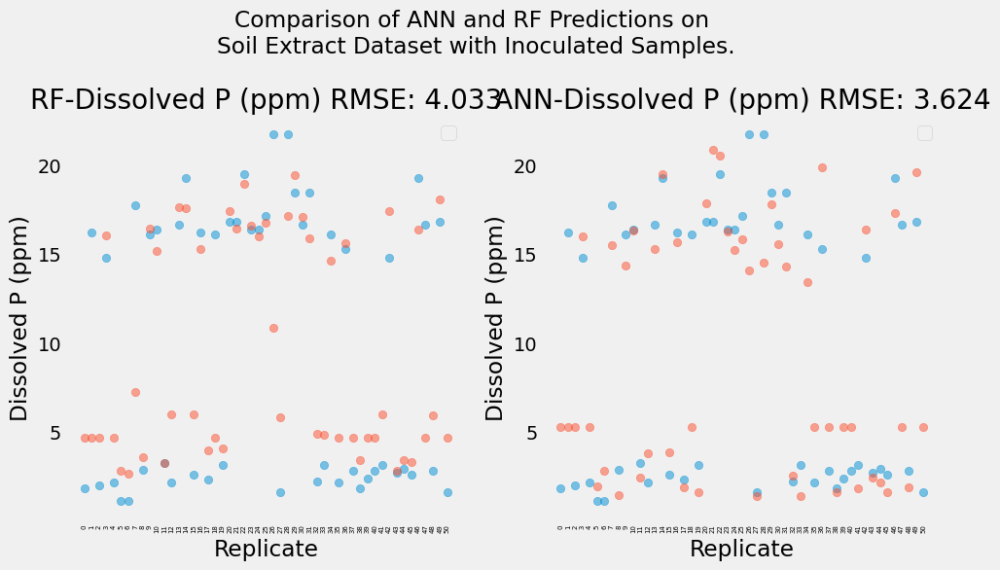

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

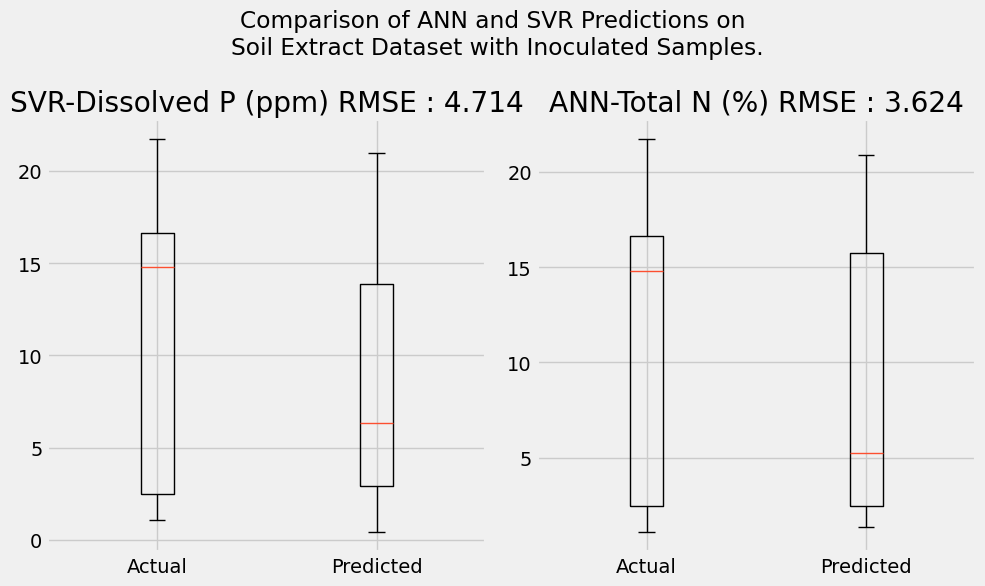

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


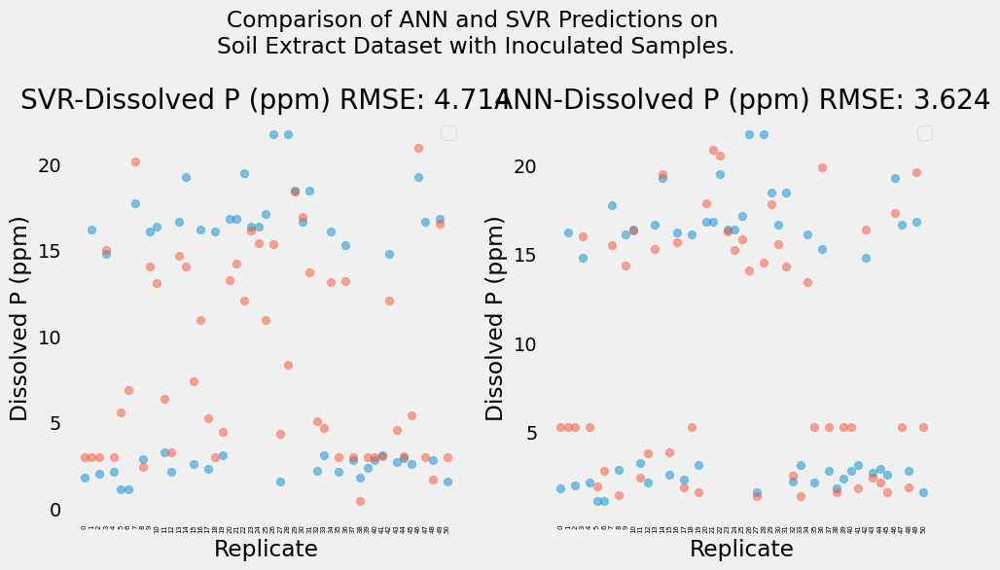

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

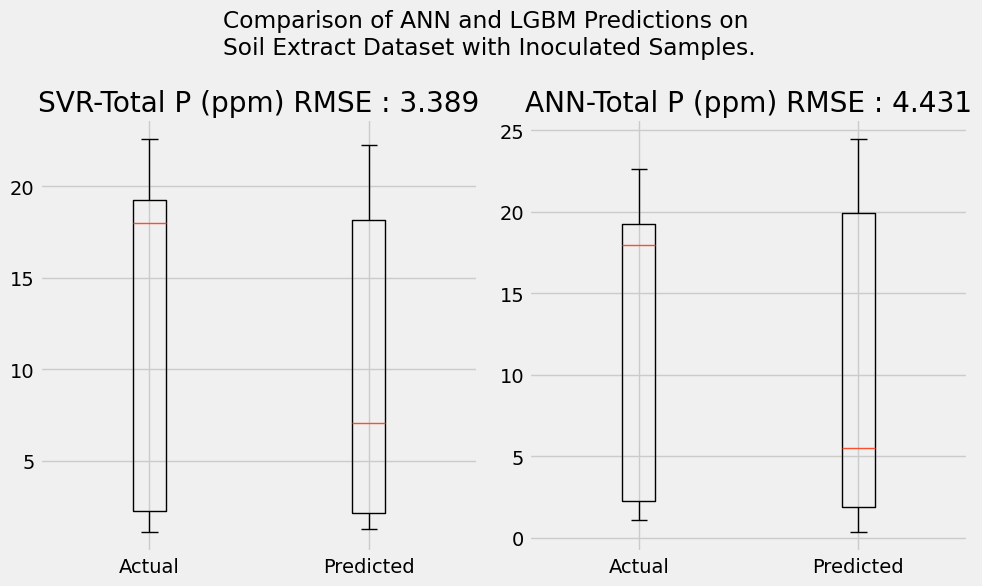

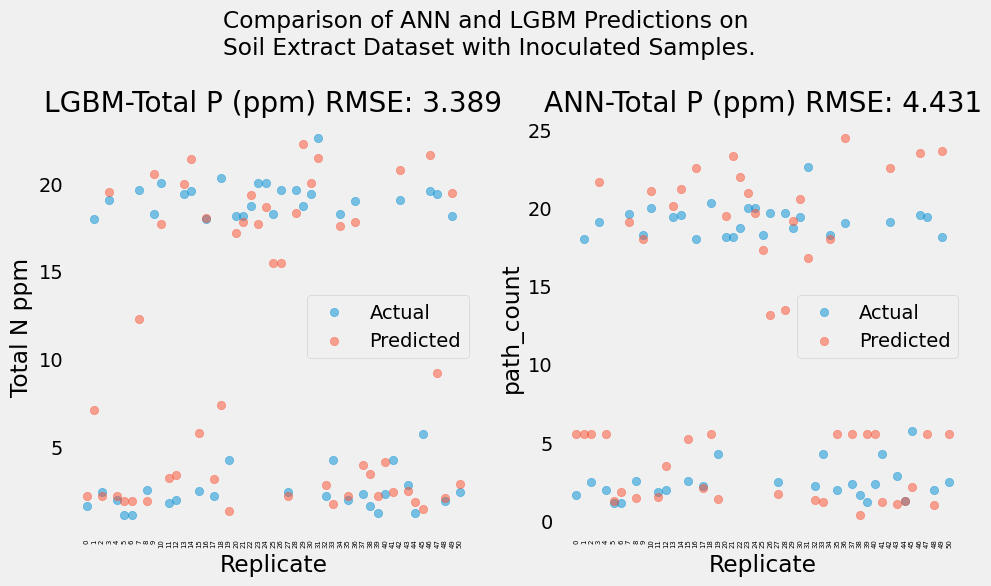

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.5s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.5s
[CV] END max_depth=None, 

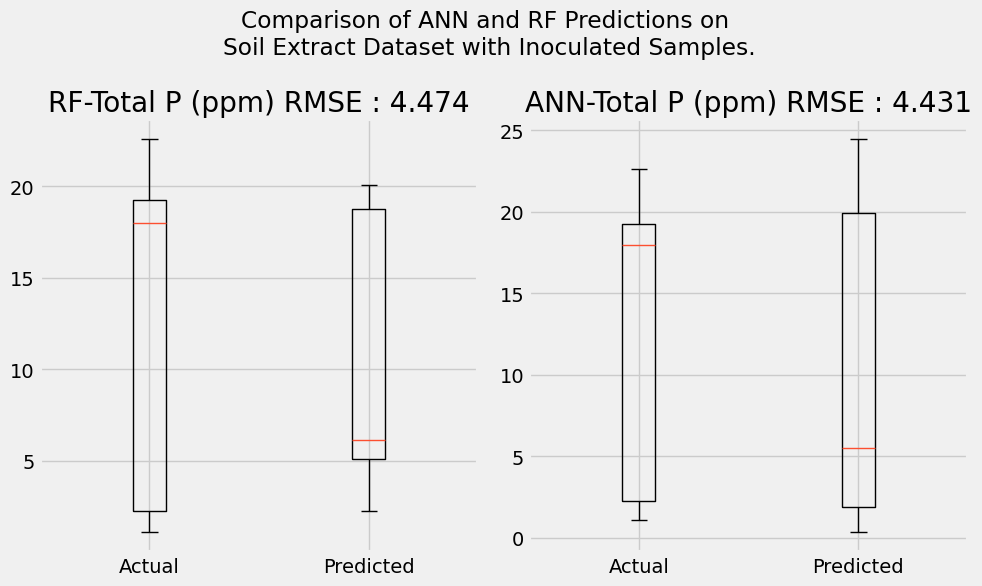

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


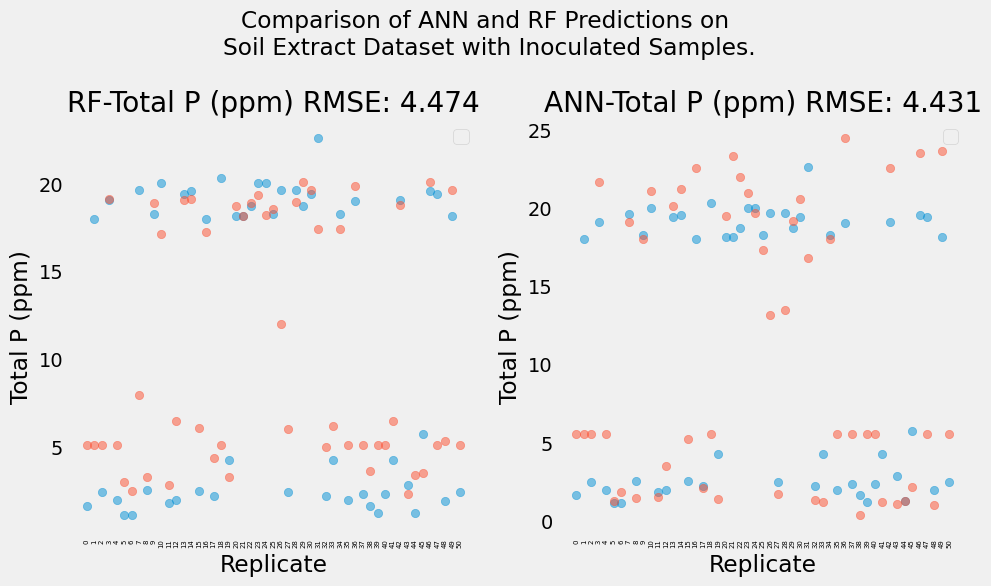

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

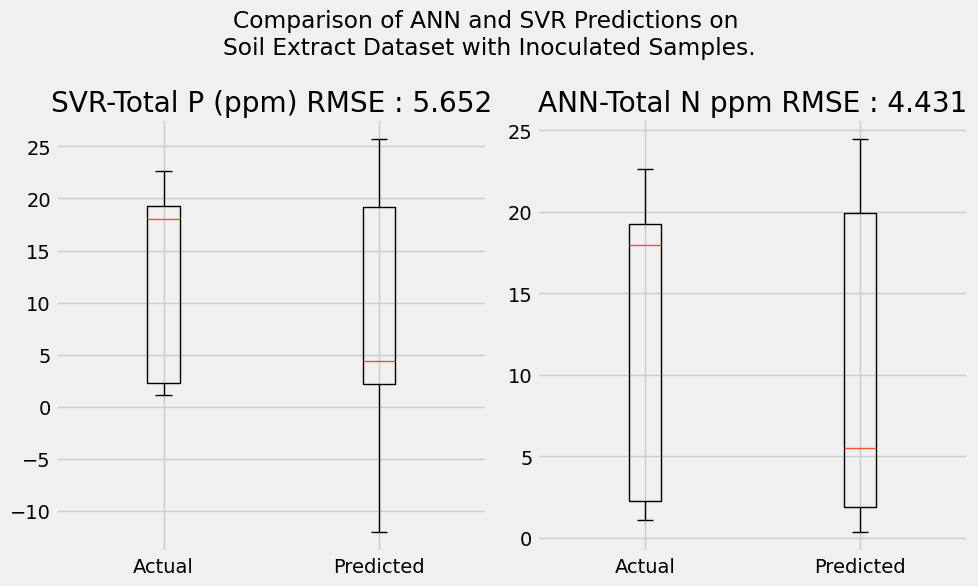

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


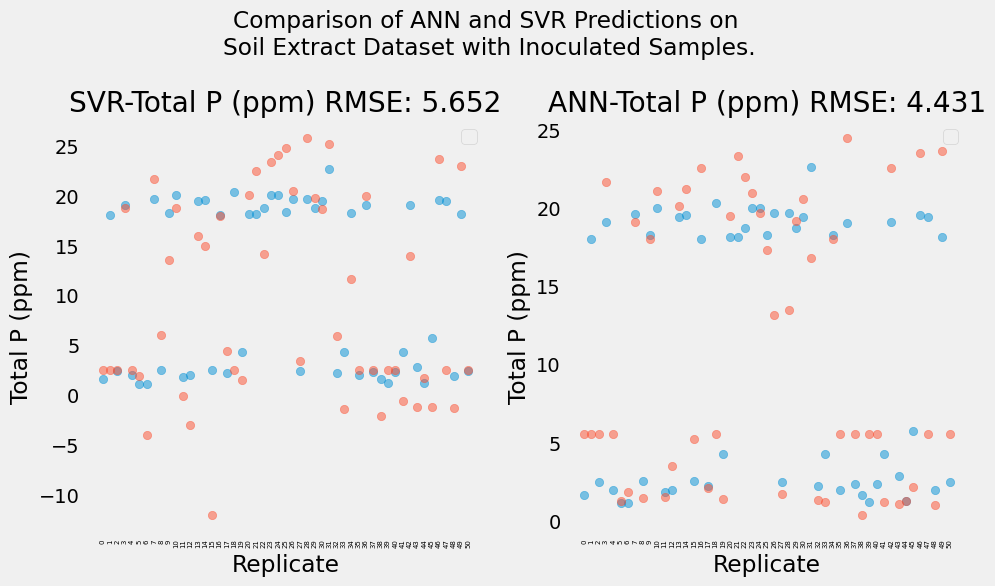

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

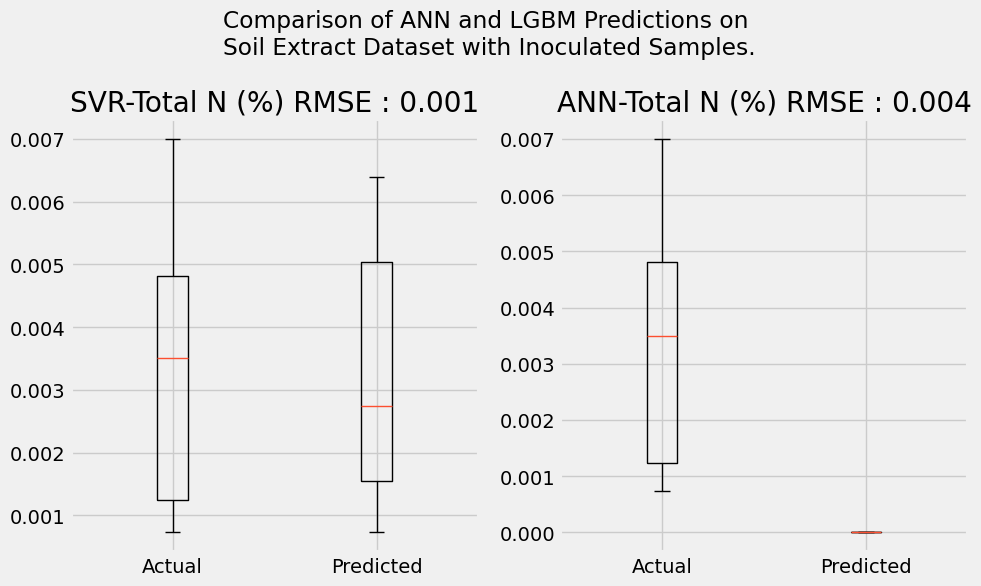

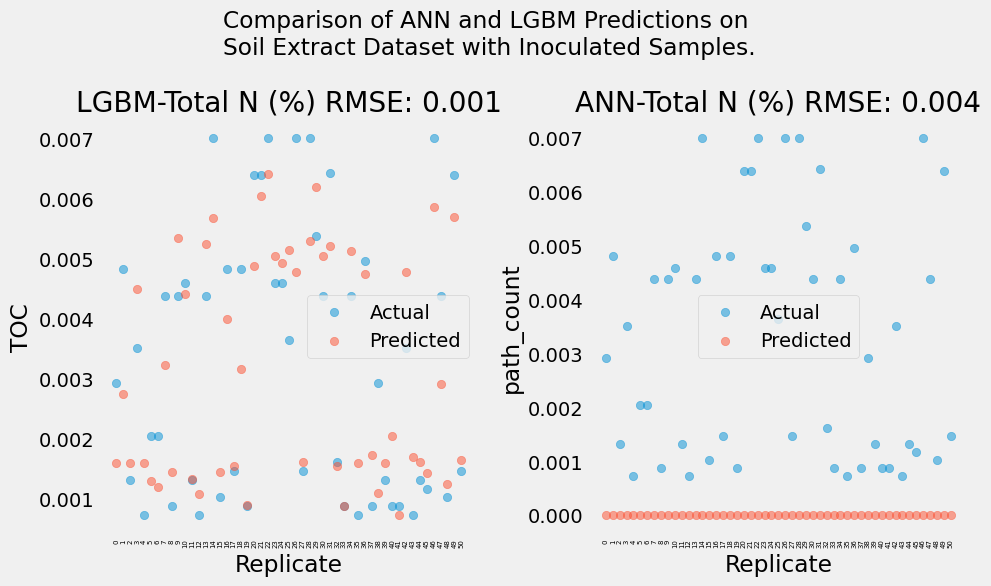

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, 

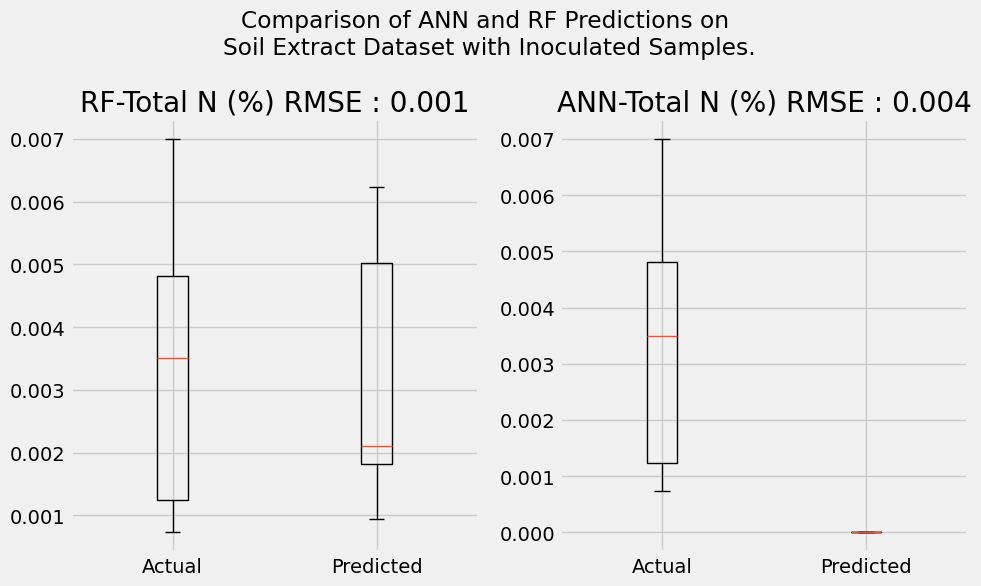

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


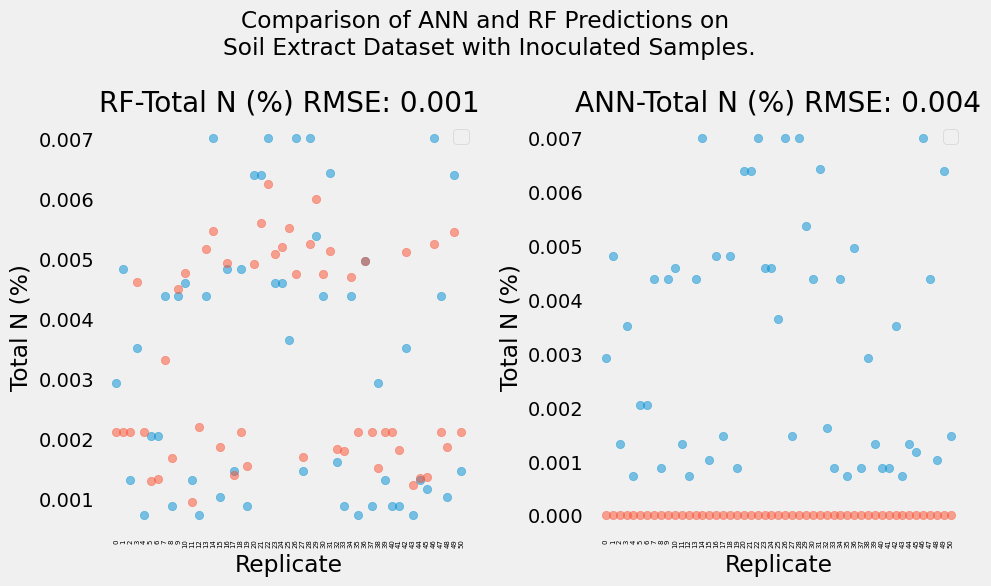

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

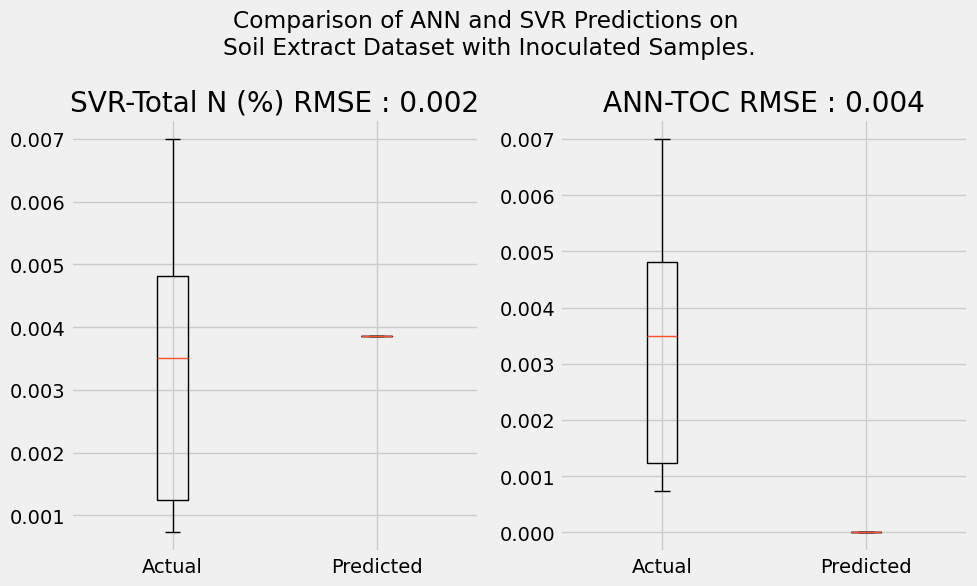

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


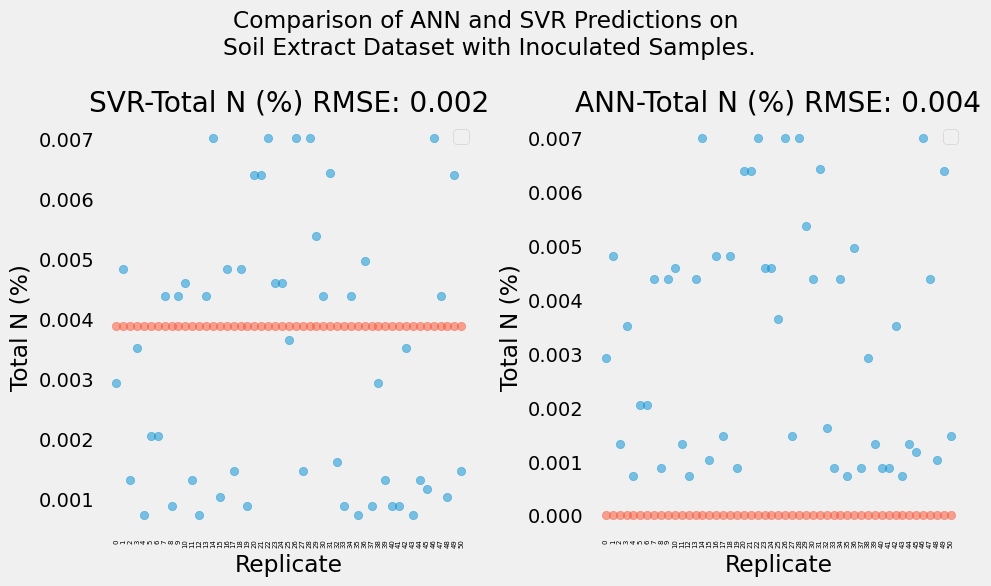

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

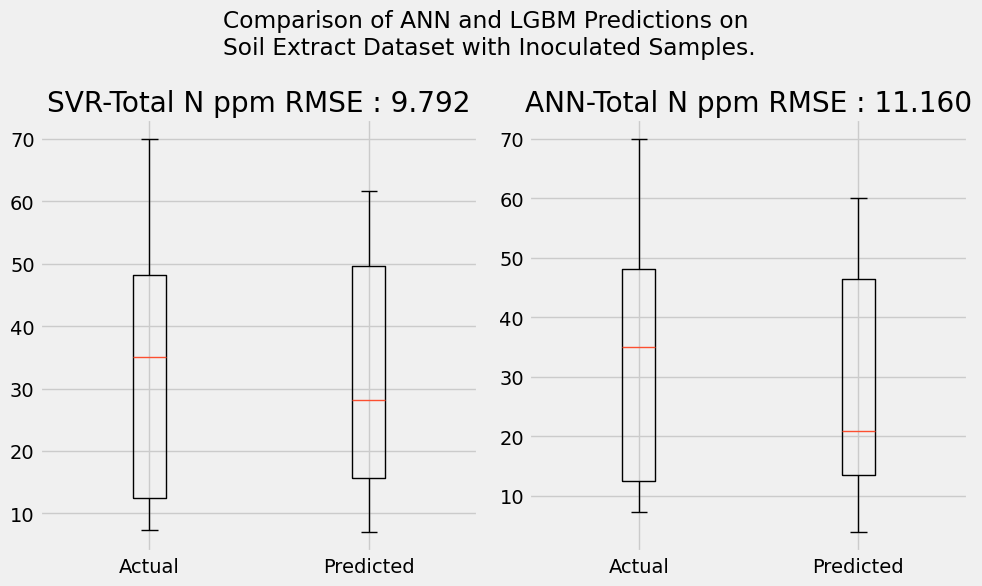

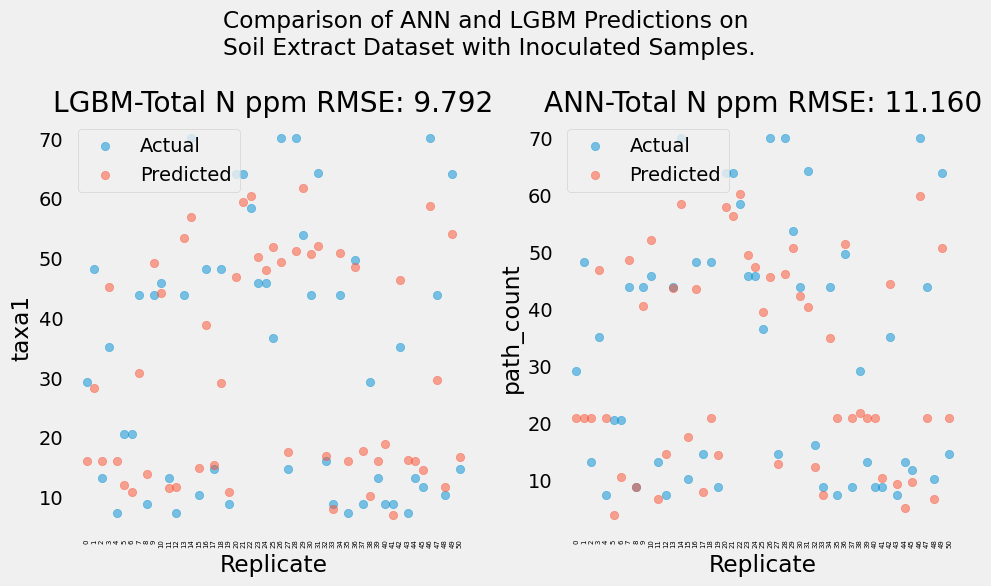

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, 

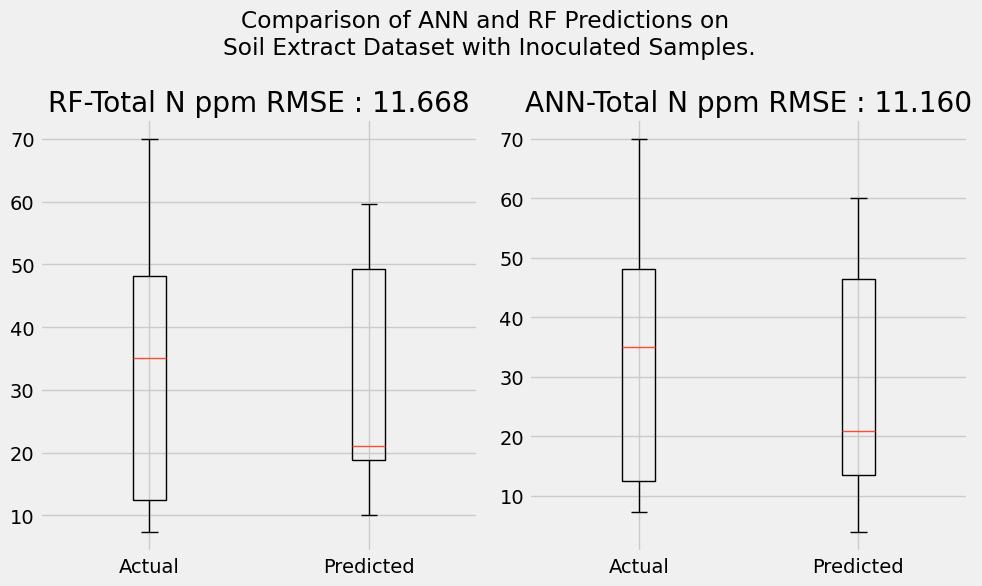

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


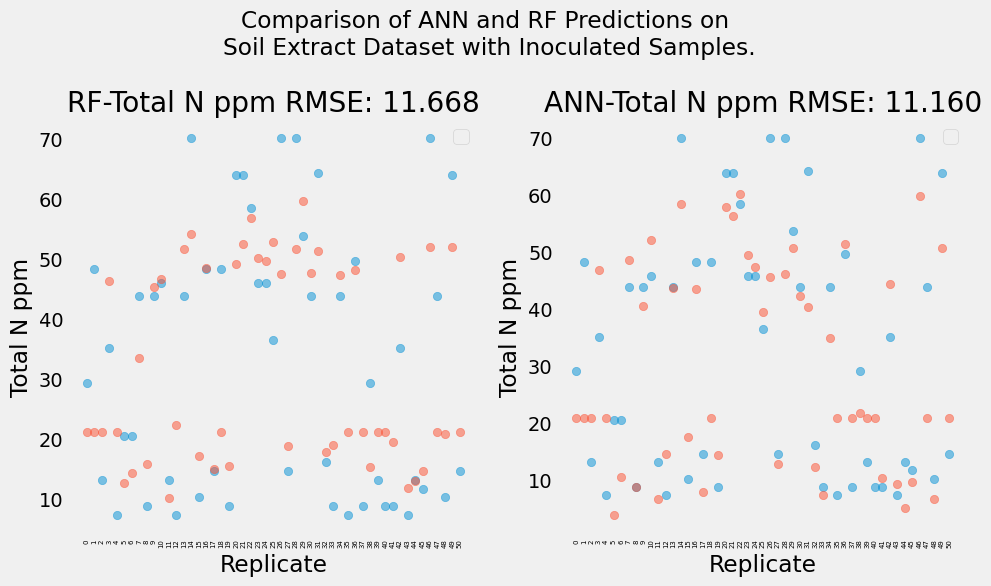

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

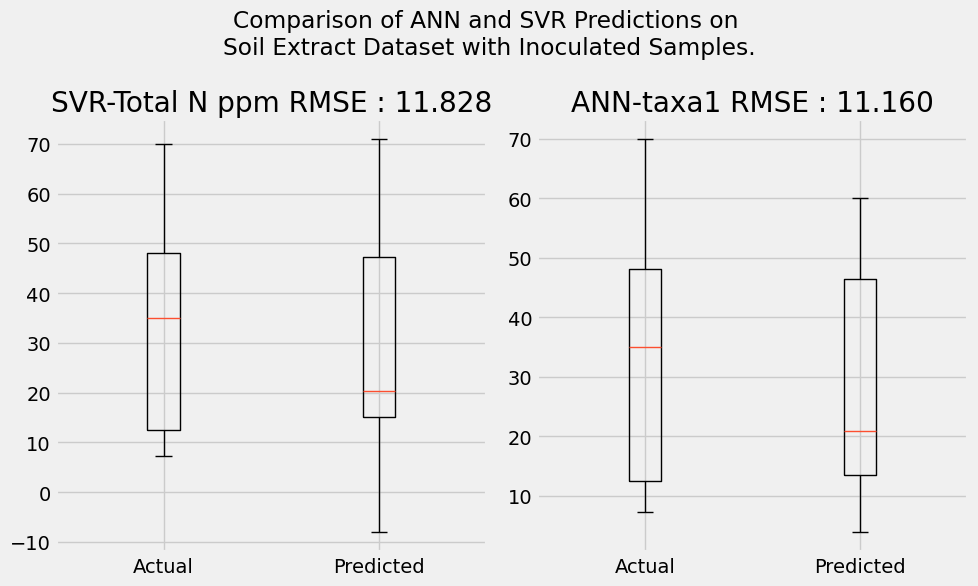

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


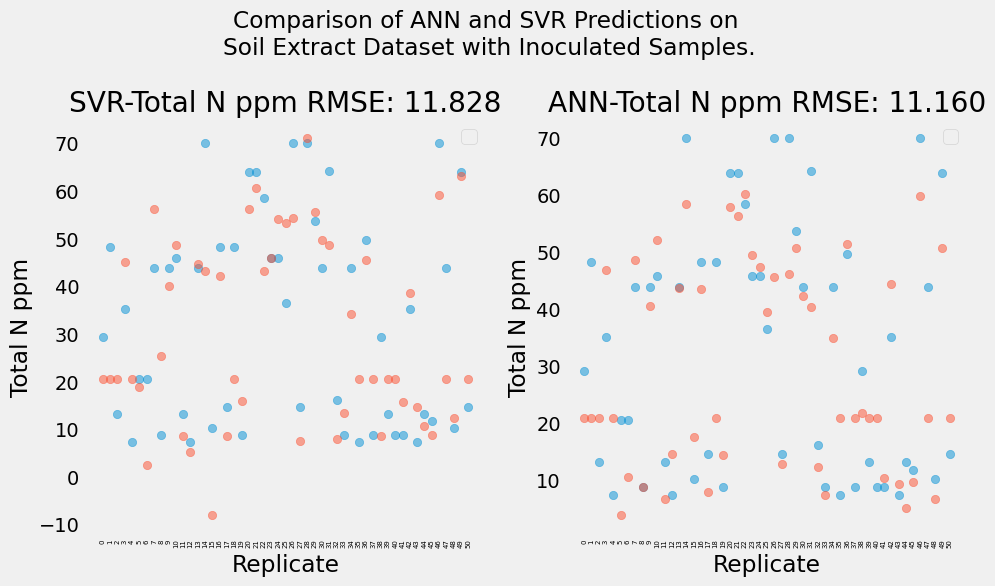

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

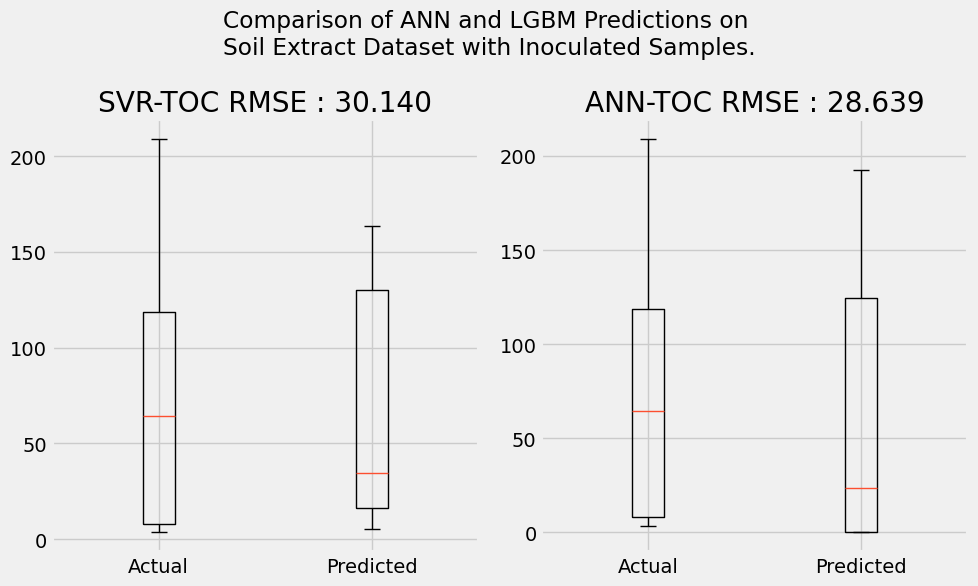

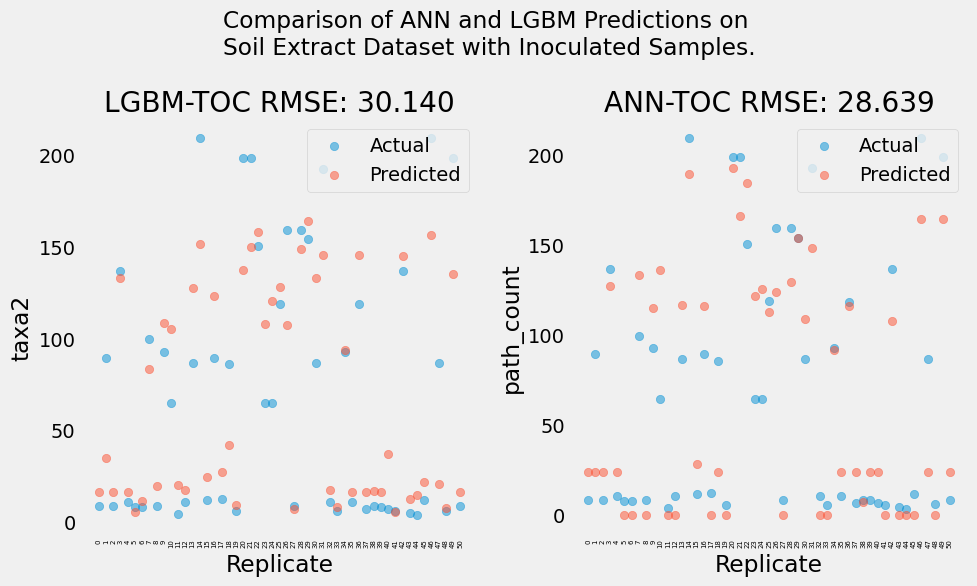

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.2s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.4s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.5s
[CV] END max_depth=None, 

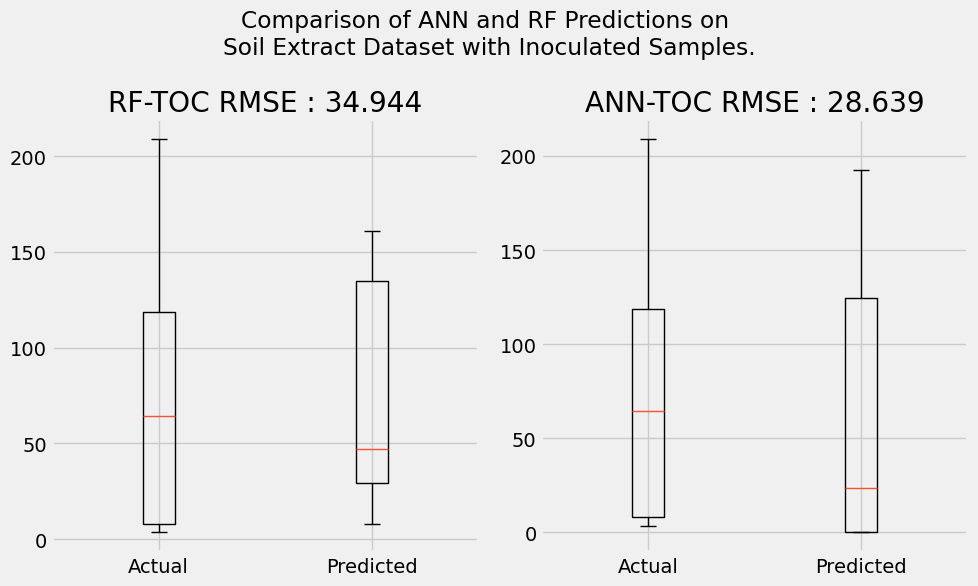

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


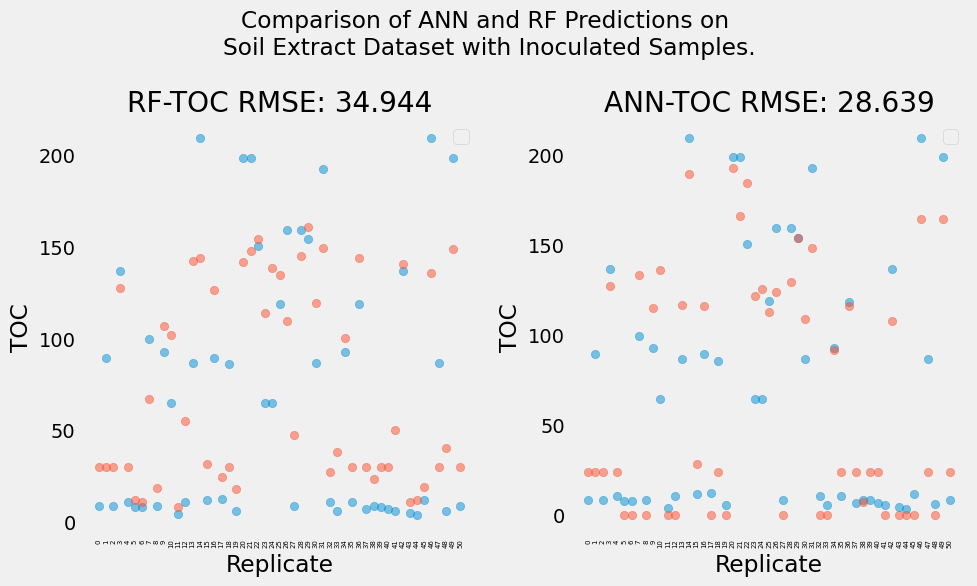

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale, kernel=poly; total time=   0.0s
[CV] END ....................C=0.1, gamma=scale

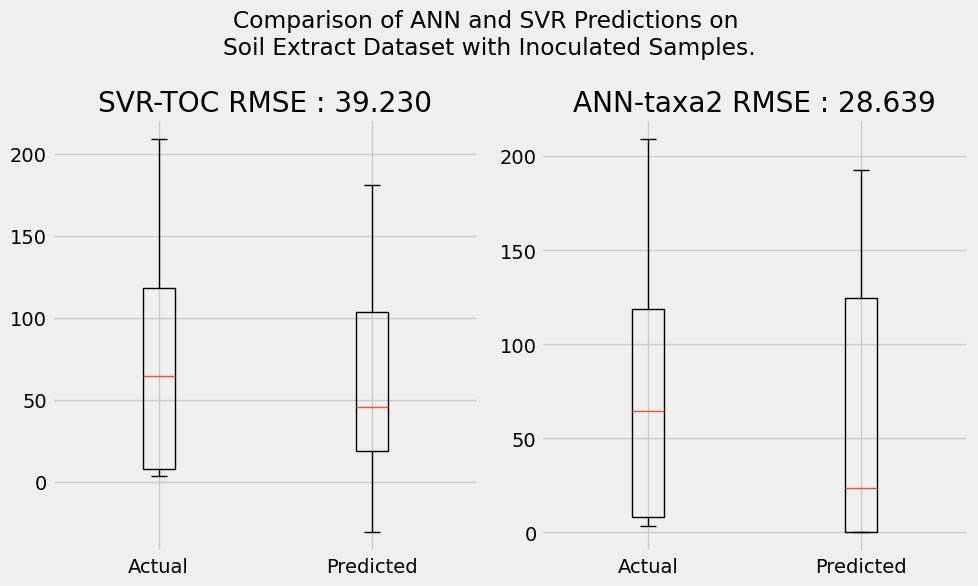

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


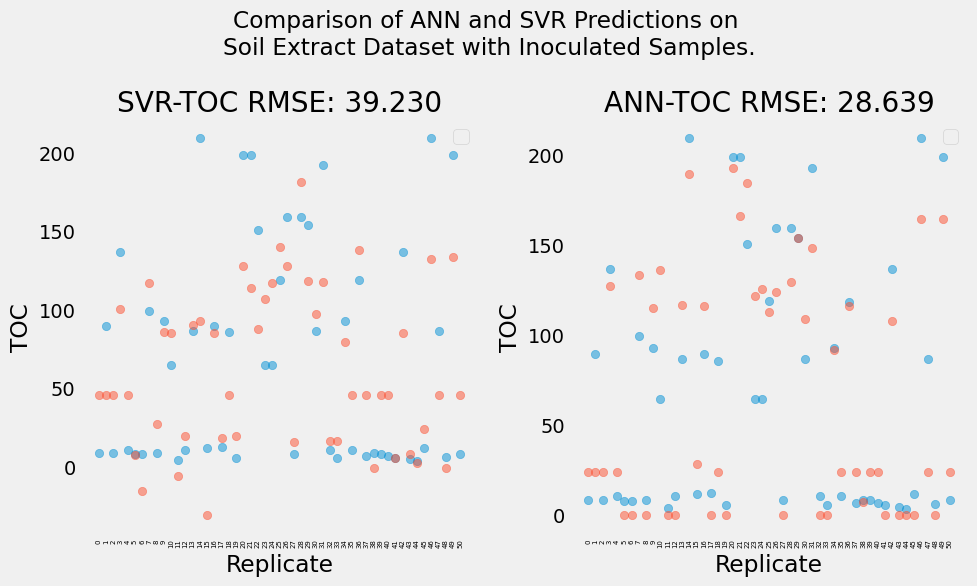

In [79]:
rfs = []
svr = []
lgbms = []
outputs = outputs_small
for i in range(y.shape[1]):
    best_lgbm, d, col =fit_lgbm(i, X_train, y_train, X_test, y_test,[x for x in range(y_test.shape[0])])
    best_rf, d2, col = fit_rf(i, X_train, y_train, X_test, y_test, [x for x in range(y_test.shape[0])])
    best_svr, d3, col = fit_svr(i, X_train, y_train, X_test, y_test, [x for x in range(y_test.shape[0])])
    lgbms.append(d)
    rfs.append(d2)
    svr.append(d3)

In [224]:
df.columns[:22]

Index(['Rep', 'Nutrient', 'pathogen', 'path_count', 'total_count', 'pH',
       'EC mmhos/cm', 'Alkalinity mg/kg CaCO3', 'Cl- (ppm)', 'K (ppm)',
       'Na (ppm)', 'Ca (ppm)', 'Mg (ppm)', 'Cu (ppm)', 'Fe (ppm)', 'Mn (ppm)',
       'Zn (ppm)', 'Dissolved P (ppm)', 'Total P (ppm)', 'Total N (%)',
       'Total N ppm', 'TOC'],
      dtype='object')

In [81]:
import ast
columns = ['pH', 'EC mmhos/cm', 'Alkalinity mg/kg CaCO3',
       'Cl- (ppm)', 'K (ppm)', 'Na (ppm)', 'Ca (ppm)', 'Mg (ppm)', 'Cu (ppm)',
       'Fe (ppm)', 'Mn (ppm)', 'Zn (ppm)', 'Dissolved P (ppm)',
       'Total P (ppm)', 'Total N (%)', 'Total N ppm', 'TOC', 'Day', 'Rep']
columns

['pH',
 'EC mmhos/cm',
 'Alkalinity mg/kg CaCO3',
 'Cl- (ppm)',
 'K (ppm)',
 'Na (ppm)',
 'Ca (ppm)',
 'Mg (ppm)',
 'Cu (ppm)',
 'Fe (ppm)',
 'Mn (ppm)',
 'Zn (ppm)',
 'Dissolved P (ppm)',
 'Total P (ppm)',
 'Total N (%)',
 'Total N ppm',
 'TOC',
 'Day',
 'Rep']

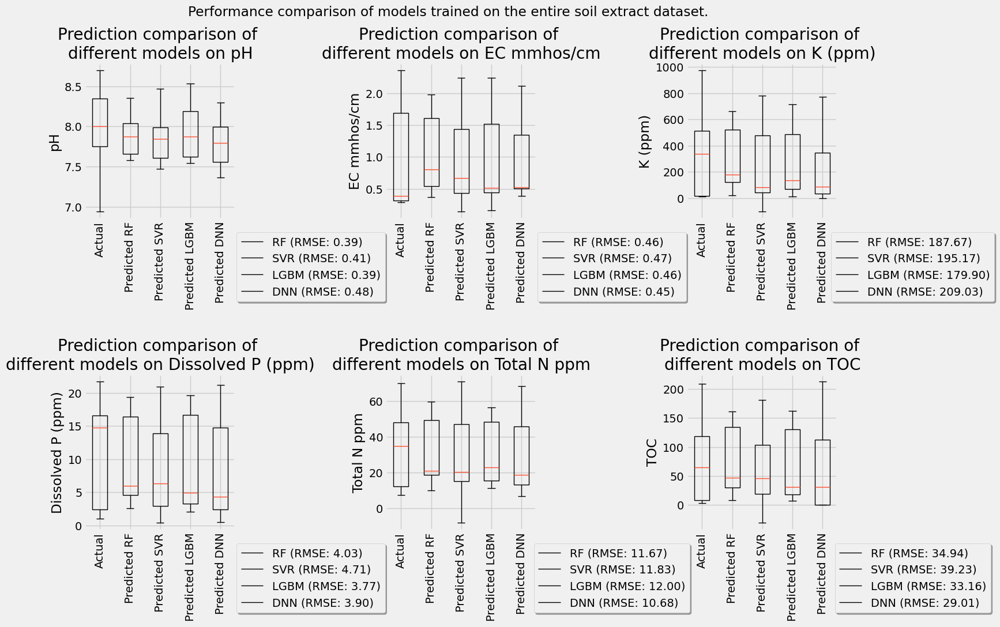

In [228]:
import matplotlib.pyplot as plt
indices = [0, 1, 4, 12, 15, 16]

# Create a 2x3 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))
axs = axs.flatten()  # Flatten the 2D array of axes for easy indexing

for ax, i in zip(axs, indices):
    # Plot on the respective subplot
    ax.boxplot([y_test[:,i+4], np.array(rfs)[i+4], svr[i+4], lgbms[i+4], outputs_small[:,i+4], outputs_ae[:,i+4], ], 
               positions=[1, 2, 3, 4, 5,6,7])

    # Set title, x-ticks, and y-label for each subplot
    ax.set_title(f'Prediction comparison of \ndifferent models on {columns[i]}')
    ax.set_xticks([1, 2, 3, 4, 5])
    ax.set_xticklabels(['Actual', 'Predicted RF', 'Predicted SVR', 'Predicted LGBM', 'Predicted DNN'], 
                       rotation=90)
    ax.set_ylabel(columns[i])
    ax.legend([
               f'RF (RMSE: {np.sqrt(mean_squared_error(y_test[:,i+4], rfs[i+4])):.2f})', 
               f'SVR (RMSE: {np.sqrt(mean_squared_error(y_test[:,i+4], svr[i+4])):.2f})', 
               f'LGBM (RMSE: {np.sqrt(mean_squared_error(y_test[:,i+4], lgbms[i+4])):.2f})', 
               f'DNN (RMSE: {np.sqrt(mean_squared_error(y_test[:,i+4], outputs[:,i+4])):.2f})'], loc='upper center', bbox_to_anchor=(1.5, -0.05),
              fancybox=True, shadow=True)

# Adjust layout for better spacing
plt.subplots_adjust(wspace=1, hspace=1)
plt.suptitle('Performance comparison of models trained on the entire soil extract dataset.')
plt.show()

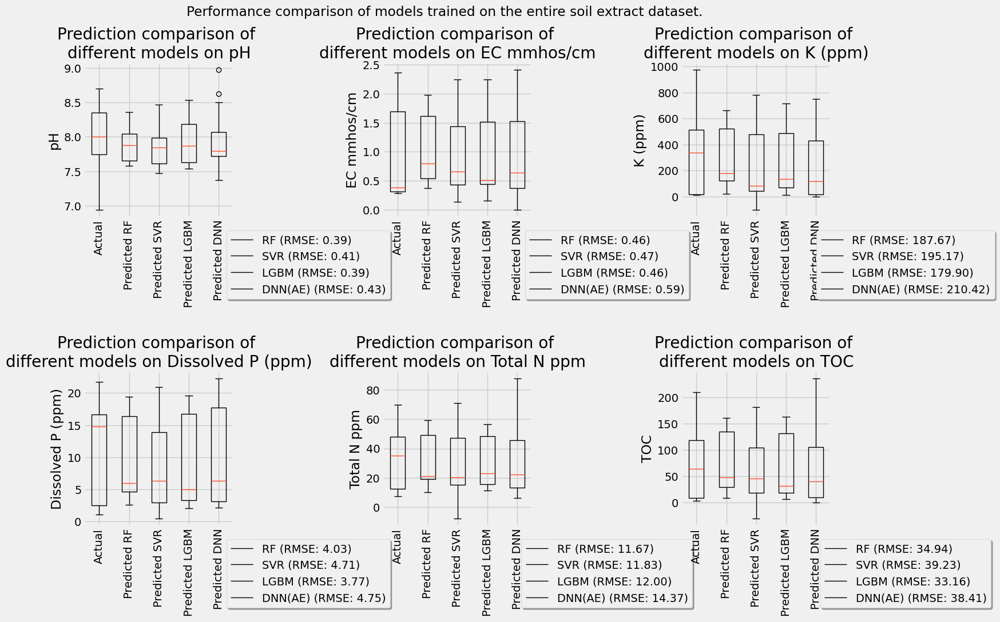

In [332]:
import matplotlib.pyplot as plt
indices = [0, 1, 4, 12, 15, 16]

# Create a 2x3 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))
axs = axs.flatten()  # Flatten the 2D array of axes for easy indexing

for ax, i in zip(axs, indices):
    # Plot on the respective subplot
    ax.boxplot([y_test[:,i+4], np.array(rfs)[i+4], svr[i+4], lgbms[i+4], outputs_ae[:,i+4]], 
               positions=[1, 2, 3, 4, 5])

    # Set title, x-ticks, and y-label for each subplot
    ax.set_title(f'Prediction comparison of \ndifferent models on {columns[i]}')
    ax.set_xticks([1, 2, 3, 4, 5])
    ax.set_xticklabels(['Actual', 'Predicted RF', 'Predicted SVR', 'Predicted LGBM', 'Predicted DNN'], 
                       rotation=90)
    ax.set_ylabel(columns[i])
    ax.legend([
               f'RF (RMSE: {np.sqrt(mean_squared_error(y_test[:,i+4], rfs[i+4])):.2f})', 
               f'SVR (RMSE: {np.sqrt(mean_squared_error(y_test[:,i+4], svr[i+4])):.2f})', 
               f'LGBM (RMSE: {np.sqrt(mean_squared_error(y_test[:,i+4], lgbms[i+4])):.2f})', 
               f'DNN(AE) (RMSE: {np.sqrt(mean_squared_error(y_test[:,i+4], outputs_ae[:,i+4])):.2f})'], loc='upper center', bbox_to_anchor=(1.5, -0.05),
              fancybox=True, shadow=True)

# Adjust layout for better spacing
plt.subplots_adjust(wspace=1, hspace=1)
plt.suptitle('Performance comparison of models trained on the entire soil extract dataset.')
plt.show()

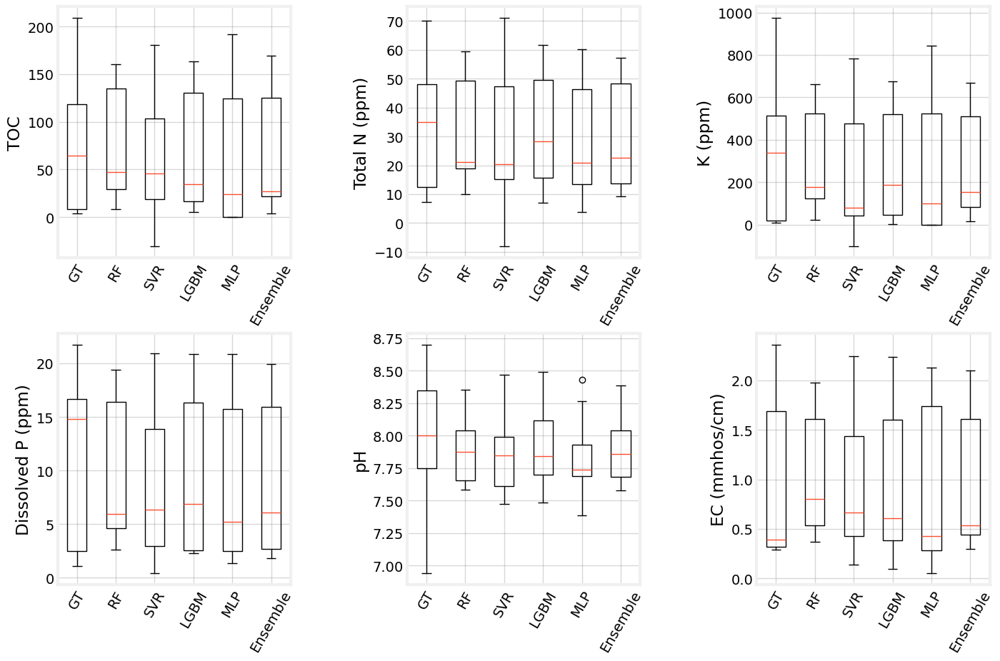

<Figure size 640x480 with 0 Axes>

In [106]:
outputs_small
import matplotlib.pyplot as plt
indices = [0, 1, 4, 12, 15, 16]
indices = [16, 15, 4, 12, 0,1]

# Create a 2x3 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))
fig.set_facecolor('white')
units = ['TOC', 'Total N (ppm)', 'K (ppm)', 'Dissolved P (ppm)', 'pH', 'EC (mmhos/cm)']
axs = axs.flatten()  # Flatten the 2D array of axes for easy indexing
j = 0
for ax, i in zip(axs, indices):
    # Plot on the respective subplot
    

        
    if i == 16:
        output_ensemble = (np.array(rfs)[i+4]  + outputs_small[:,i+4].numpy())/2
    elif i == 12:
        output_ensemble = (np.array(lgbms)[i+4]  + outputs_small[:,i+4].numpy())/2
    elif i == 4:
        output_ensemble = (np.array(lgbms)[i+4]  + np.array(rfs)[i+4])/2
    elif i == 0:
        output_ensemble = (np.array(rfs)[i+4]  + np.array(lgbms)[i+4] + np.array(svr)[i+4] )/3
    else:
        output_ensemble = (np.array(rfs)[i+4] +  svr[i+4] + lgbms[i+4] + outputs_small[:,i+4].numpy())/4
    
    ax.boxplot([y_test[:,i+4], np.array(rfs)[i+4], svr[i+4], lgbms[i+4], outputs_small[:,i+4],output_ensemble], 
               positions=[1, 2, 3, 4, 5, 6])

    # Set title, x-ticks, and y-label for each subplot
    
    
    ax.set_xticks([1, 2, 3, 4, 5, 6])
    ax.set_xticklabels(['GT', 'RF', 'SVR', 'LGBM', 'MLP', 'Ensemble'], 
                       rotation=60)
    ax.set_ylabel(units[j])
    ax.grid(color='tab:gray', alpha=0.3)
    ax.set_facecolor('white')
    j+=1
# Adjust layout for better spacing
plt.subplots_adjust(wspace=0.5, hspace=0.3)
plt.figure(facecolor='white')
plt.show()

In [1]:
output_ensemble.shape

NameError: name 'output_ensemble' is not defined

In [235]:
X = df[df.columns[22:]].values
y = df[df.columns[1:22]].values

In [236]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = scaler.fit_transform(X)

In [237]:
pca = PCA(0.95)
principalComponents = pca.fit_transform(X)

In [238]:
principalComponents.shape

(168, 79)

In [239]:
X_train, X_test, y_train, y_test = train_test_split(principalComponents, y, test_size=0.3, random_state=42)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=3; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=2; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=3, num_leaves=5; total time=   0.0s
[CV] END ...learning_rate=0.01, n_estimators=

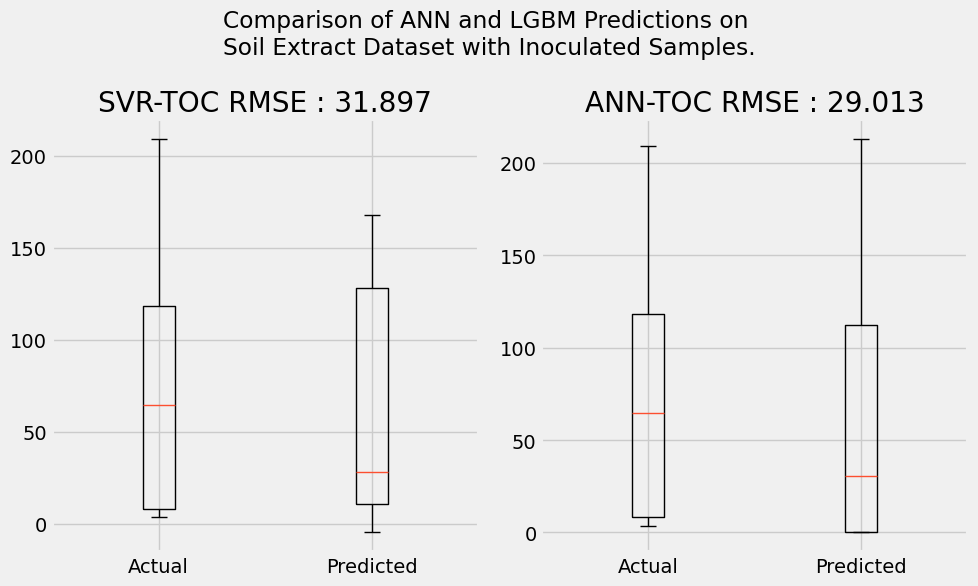

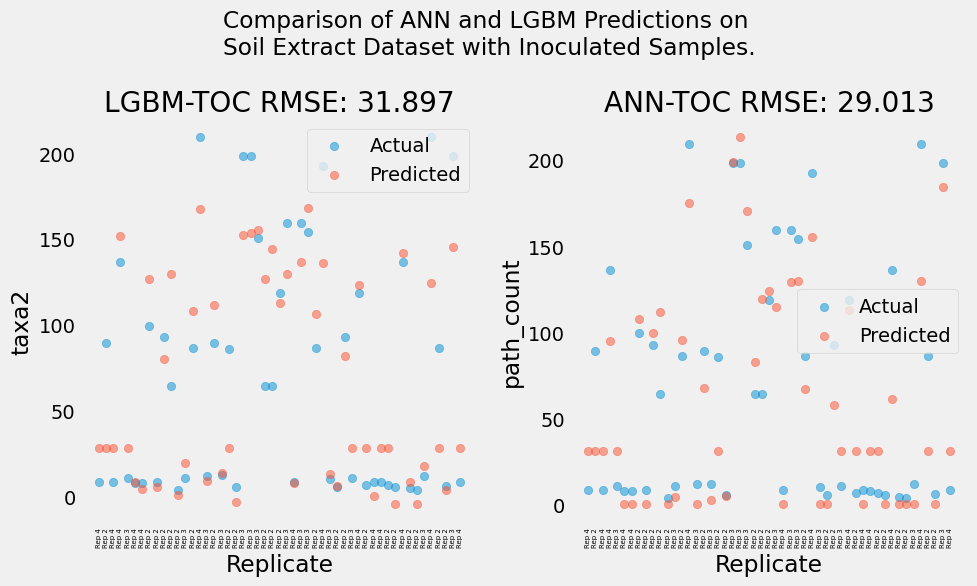

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.6s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.6s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=   0.3s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.6s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.6s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=   0.6s
[CV] END max_depth=None, 

KeyboardInterrupt: 

In [333]:
outputs = 
i=20
best_lgbm =fit_lgbm(i, X_train, y_train, X_test, y_test, x_ticks)
best_rf = fit_rf(i, X_train, y_train, X_test, y_test, x_ticks)

In [169]:
ensemble_output = (outputs_small[:,-1].numpy() + best_rf.predict(X_test))/2

In [167]:
ensemble_output

array([ 29.48018829,  29.48018829,  29.48018829, 129.64167349,
        29.48018829,   9.60818381,   3.87675087, 110.60398265,
         4.89086548,  96.41817169, 122.51968808,   1.2968482 ,
         8.85582516, 105.58106892, 163.99528988,   8.91632355,
        96.25451706,  12.16214143,  29.48018829,   1.09043251,
       170.59743559, 173.71394007, 156.85886387, 108.47818723,
       132.90126186, 112.85041524, 131.79936535,   9.93395584,
       129.75740475, 154.91486864,  88.3104402 , 153.14084711,
         4.03705649,   5.26785763,  80.64908458,  29.48018829,
       124.63284933,  29.48018829,   3.06004299,  29.48018829,
        29.48018829,   0.55208315, 115.72477006,   5.840901  ,
         4.18874365,  10.71720948, 136.59054506,  29.48018829,
         0.82330901, 166.20168426,  29.48018829])

Text(0.5, 1.0, 'Comparison of TOC predicted vs actual 26.060193418883323')

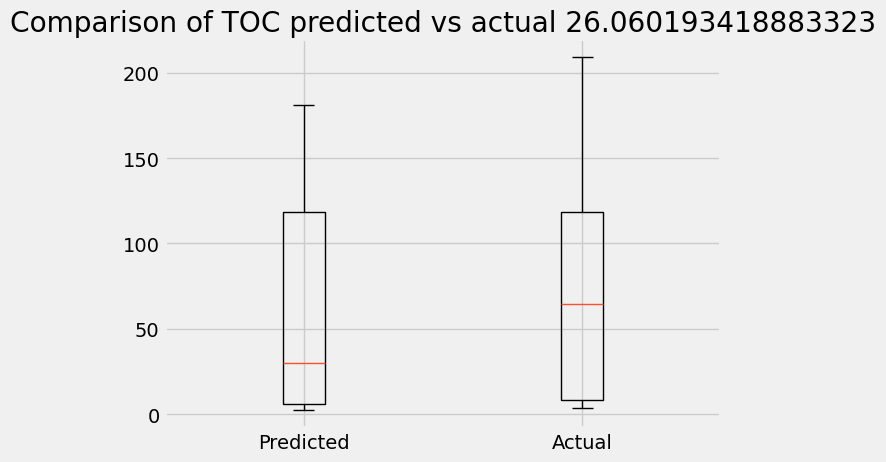

In [170]:
from sklearn.metrics import mean_squared_error
n=20
plt.boxplot([ensemble_output, y_test[:,n]], labels=['Predicted', 'Actual'])
plt.title(f'Comparison of {df.columns[n+1]} predicted vs actual {np.sqrt(mean_squared_error(y_test[:,n], ensemble_output))}')


In [1]:
model = torch.load('../models/model_all_data.pth')

NameError: name 'torch' is not defined